In [1]:
import pandas as pd

In [2]:
df_docs = pd.read_parquet("documents.parquet")

In [3]:
df_pages = pd.read_parquet("pages.parquet")

In [4]:
df_docs.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8 entries, 0 to 7
Data columns (total 5 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   candidate  8 non-null      object
 1   filename   8 non-null      object
 2   text       8 non-null      object
 3   n_chars    8 non-null      int64 
 4   n_words    8 non-null      int64 
dtypes: int64(2), object(3)
memory usage: 452.0+ bytes


In [4]:
summary = df_docs.groupby("candidate")[["n_chars", "n_words"]].sum().sort_values(by="n_words", ascending=False)
print(summary)

           n_chars  n_words
candidate                  
kaiser      568599    83095
parisi      268503    39354
artes       208304    32454
matthei     123460    18601
harold       99165    14827
kast         89373    13986
meo          55687     8319
jara         20954     3138


In [5]:
summary = df_pages.groupby("candidate")[["n_chars", "n_words"]].sum().sort_values(by="n_words", ascending=False)
print(summary)

           n_chars  n_words
candidate                  
kaiser      568199    83095
parisi      268249    39354
artes       208234    32454
matthei     123358    18601
harold       99079    14827
kast         89299    13986
meo          55617     8319
jara         20942     3138


In [9]:
import pytesseract

print(pytesseract)

<module 'pytesseract' from 'C:\\Users\\Rodrigo\\AppData\\Roaming\\Python\\Python312\\site-packages\\pytesseract\\__init__.py'>


In [12]:
# %% OCR de kast.pdf (ruta relativa) + export e integración
!pip -q install pymupdf pillow pytesseract pandas pyarrow

import io, re
import fitz
from PIL import Image
import pytesseract
import pandas as pd
from pathlib import Path

# Fuerza el ejecutable si hace falta (ya lo tienes instalado)
pytesseract.pytesseract.tesseract_cmd = r"C:\Program Files\Tesseract-OCR\tesseract.exe"
print("Tesseract:", pytesseract.get_tesseract_version())

# --- Ruta relativa por defecto, con fallback a tu ruta absoluta (con espacios) ---
PDF_PATH = Path("kast.pdf")
if not PDF_PATH.exists():
    PDF_PATH = Path(r"C:\Users\Rodrigo\Desktop\Rodrigo proyects\nlp-candidates\kast.pdf")
assert PDF_PATH.exists(), f"No existe: {PDF_PATH}"

def normalizar(x):
    if not x: return ""
    x = x.replace("\x00","")
    x = re.sub(r"[ \t]+"," ", x)
    x = re.sub(r"\s+\n","\n", x)
    x = re.sub(r"\n{3,}","\n\n", x)
    return x.strip()

def ocr_pymupdf(pdf_path, lang="spa", dpi=350, psm=6):
    doc = fitz.open(pdf_path)
    rows = []
    zoom = dpi / 72.0
    mat = fitz.Matrix(zoom, zoom)
    cfg = f"--oem 3 --psm {psm}"
    for i in range(len(doc)):
        pix = doc.load_page(i).get_pixmap(matrix=mat, alpha=False)
        img = Image.open(io.BytesIO(pix.tobytes("png")))
        try:
            txt = pytesseract.image_to_string(img, lang=lang, config=cfg) or ""
        finally:
            img.close()
        rows.append({"candidate":"kast","filename":PDF_PATH.name,"page":i+1,"text":normalizar(txt)})
    doc.close()
    return pd.DataFrame(rows)

# OCR principal; si detecta poco texto, reintenta con layout por columnas
pages_kast = ocr_pymupdf(PDF_PATH, lang="spa", dpi=350, psm=6)
if pages_kast["text"].str.len().sum() < 5000:
    pages_kast = ocr_pymupdf(PDF_PATH, lang="spa", dpi=400, psm=4)

# Métricas
pages_kast["n_chars"] = pages_kast["text"].str.len()
pages_kast["n_words"] = pages_kast["text"].str.split().apply(len)

# Documento agregado
docs_kast = (pages_kast
             .sort_values(["filename","page"])
             .groupby(["candidate","filename"], as_index=False)["text"]
             .apply(lambda s: "\n\n".join(s.values)))
docs_kast["n_chars"] = docs_kast["text"].str.len()
docs_kast["n_words"] = docs_kast["text"].str.split().apply(len)

# Persistencia (en el cwd)
pages_kast.to_parquet("kast_pages.parquet", index=False)
docs_kast.to_parquet("kast_document.parquet", index=False)
pages_kast.to_csv("kast_pages.csv", index=False, encoding="utf-8-sig")
docs_kast.to_csv("kast_document.csv", index=False, encoding="utf-8-sig")

print("Generados: kast_pages.{parquet,csv}, kast_document.{parquet,csv}")

# Integración opcional si existen tus datasets globales en el cwd
if Path("pages.parquet").exists() and Path("documents.parquet").exists():
    pages_all = pd.read_parquet("pages.parquet")
    docs_all  = pd.read_parquet("documents.parquet")
    pages_all = pd.concat([pages_all[pages_all.candidate!="kast"], pages_kast], ignore_index=True)
    docs_all  = pd.concat([docs_all[docs_all.candidate!="kast"],  docs_kast],  ignore_index=True)
    pages_all.to_parquet("pages.parquet", index=False)
    docs_all.to_parquet("documents.parquet", index=False)
    pages_all.to_csv("pages.csv", index=False, encoding="utf-8-sig")
    docs_all.to_csv("documents.csv", index=False, encoding="utf-8-sig")
    print("Corpus global actualizado: 'kast' reemplazado.")

print("\nResumen kast (n_words):")
print(docs_kast[["candidate","filename","n_words"]])



[notice] A new release of pip is available: 24.1.2 -> 25.3
[notice] To update, run: python.exe -m pip install --upgrade pip


Tesseract: 5.4.0.20240606
Generados: kast_pages.{parquet,csv}, kast_document.{parquet,csv}
Corpus global actualizado: 'kast' reemplazado.

Resumen kast (n_words):
  candidate  filename  n_words
0      kast  kast.pdf    13986


In [2]:
# %% MÓDULO 0 — setup
!pip -q install pandas pyarrow chardet unidecode spacy nltk wordcloud matplotlib rapidfuzz tqdm

import sys, subprocess, time
t0 = time.time()

subprocess.run([sys.executable, "-m", "spacy", "download", "es_core_news_lg"], check=False)

import pandas as pd, numpy as np, re, hashlib, unicodedata, math
from pathlib import Path
from unidecode import unidecode
from rapidfuzz import fuzz
import chardet
import matplotlib.pyplot as plt
from wordcloud import WordCloud
from tqdm.auto import tqdm, trange

tqdm.pandas(desc="tqdm(pandas)")

DOCS = Path("documents.parquet")
PAGES = Path("pages.parquet")
assert DOCS.exists() and PAGES.exists(), "debe existir documents.parquet y pages.parquet en el cwd"

def sha1(x):
    if pd.isna(x): x = ""
    return hashlib.sha1(str(x).encode("utf-8", errors="ignore")).hexdigest()

def remove_diacritics(s):
    if not isinstance(s,str): return s
    s = unicodedata.normalize("NFKD", s)
    return "".join(ch for ch in s if not unicodedata.combining(ch))

def strip_control(s):
    if not isinstance(s,str): return s
    s = s.replace("\x00","").replace("\u200b","").replace("\u00ad","")
    s = re.sub(r"[ \t]+"," ", s)
    s = re.sub(r"\s+\n","\n", s)
    s = re.sub(r"\n{3,}","\n\n", s)
    return s.strip()

tqdm.write(f"[M0] setup listo en {time.time()-t0:.2f}s")



[notice] A new release of pip is available: 24.1.2 -> 25.3
[notice] To update, run: python.exe -m pip install --upgrade pip


[M0] setup listo en 384.08s


In [3]:
# %% MÓDULO 1 — carga y unificación (QC)
import time
t0 = time.time(); tqdm.write("[M1] inicio")

tqdm.write("[M1.1] leyendo parquet")
docs_raw  = pd.read_parquet(DOCS)
pages_raw = pd.read_parquet(PAGES)

tqdm.write("[M1.2] metadatos básicos")
for name, df in (("docs",docs_raw), ("pages",pages_raw)):
    if "n_chars" not in df: df["n_chars"] = df["text"].str.len()
    if "n_words" not in df: df["n_words"] = df["text"].str.split().apply(len)

tqdm.write("[M1.3] sha1 de contenido")
pages_raw["sha1_text"] = pages_raw["text"].progress_apply(sha1)
docs_raw["sha1_text"]  = docs_raw["text"].progress_apply(sha1)

tqdm.write("[M1.4] proporción non-ascii")
def p_nonascii(s):
    if not isinstance(s,str) or not s: return 0.0
    tot = len(s); non = sum(1 for c in s if ord(c) > 127)
    return non / max(tot,1)
pages_raw["p_nonascii"] = pages_raw["text"].progress_apply(p_nonascii)
docs_raw["p_nonascii"]  = docs_raw["text"].progress_apply(p_nonascii)

tqdm.write("[M1.5] duplicados exactos")
pages_raw["is_dup_exact"] = pages_raw.duplicated(subset=["candidate","filename","page","sha1_text"], keep="first")

tqdm.write("[M1.6] near-dups por archivo")
def neardup_flag(df):
    df = df.sort_values("page")
    sim = [False]
    for i in trange(1, len(df), leave=False, desc="near-dup(pág)"):
        a, b = df.iloc[i-1]["text"], df.iloc[i]["text"]
        score = fuzz.token_set_ratio(a, b) if isinstance(a,str) and isinstance(b,str) else 0
        sim.append(score >= 95)
    df["is_dup_near"] = sim
    return df
pages_qc = (pages_raw.groupby(["candidate","filename"], group_keys=False)
            .progress_apply(neardup_flag))
docs_qc  = docs_raw.copy()

tqdm.write("[M1.7] persistiendo QC")
pages_qc.to_parquet("pages_qc.parquet", index=False)
docs_qc.to_parquet("documents_qc.parquet", index=False)

tqdm.write(f"[M1] fin en {time.time()-t0:.2f}s — pages_qc={pages_qc.shape} docs_qc={docs_qc.shape}")


[M1] inicio
[M1.1] leyendo parquet
[M1.2] metadatos básicos
[M1.3] sha1 de contenido


tqdm(pandas):   0%|          | 0/542 [00:00<?, ?it/s]

tqdm(pandas):   0%|          | 0/8 [00:00<?, ?it/s]

[M1.4] proporción non-ascii


tqdm(pandas):   0%|          | 0/542 [00:00<?, ?it/s]

tqdm(pandas):   0%|          | 0/8 [00:00<?, ?it/s]

[M1.5] duplicados exactos
[M1.6] near-dups por archivo


tqdm(pandas):   0%|          | 0/8 [00:00<?, ?it/s]

near-dup(pág):   0%|          | 0/35 [00:00<?, ?it/s]

near-dup(pág):   0%|          | 0/43 [00:00<?, ?it/s]

near-dup(pág):   0%|          | 0/6 [00:00<?, ?it/s]

near-dup(pág):   0%|          | 0/200 [00:00<?, ?it/s]

near-dup(pág):   0%|          | 0/37 [00:00<?, ?it/s]

near-dup(pág):   0%|          | 0/51 [00:00<?, ?it/s]

near-dup(pág):   0%|          | 0/35 [00:00<?, ?it/s]

near-dup(pág):   0%|          | 0/127 [00:00<?, ?it/s]

[M1.7] persistiendo QC
[M1] fin en 3.62s — pages_qc=(542, 10) docs_qc=(8, 7)


In [4]:
# %% MÓDULO 2 — normalización (VL/VN)  **CORREGIDO**
import time, spacy, nltk
from tqdm.auto import tqdm

t0 = time.time(); tqdm.write("[M2] inicio")

try: _ = nltk.data.find("corpora/stopwords")
except LookupError: nltk.download("stopwords")
from nltk.corpus import stopwords

stops_nltk = set(stopwords.words("spanish"))
nlp_tmp = spacy.blank("es")
stops_spacy = set(getattr(nlp_tmp.Defaults, "stop_words", set()))
neg_keep = {"no","ni","nunca","jamás","nadie","ninguno","ninguna"}
stops_domain = {"capitulo","capítulo","indice","índice","anexo","glosario","programa","gobierno","presidencial"}
STOP_ALL = (stops_nltk | stops_spacy | stops_domain) - neg_keep

tqdm.write("[M2.1] construyendo VL/VN")
def build_vl_vn(text):
    if not isinstance(text,str): return pd.Series({"text_vl":"","text_vn":""})
    t = strip_control(text); vl = t.lower()
    vn = remove_diacritics(vl)
    vn = re.sub(r"[^\w\s]", " ", vn, flags=re.UNICODE)
    vn = re.sub(r"\s+", " ", vn).strip()
    return pd.Series({"text_vl": vl, "text_vn": vn})

pages_norm = pages_qc.copy()
pages_norm[["text_vl","text_vn"]] = pages_norm["text"].progress_apply(build_vl_vn)

tqdm.write("[M2.2] mapeo de números")
def map_nums(s): return re.sub(r"\b\d{1,}\b", "<NUM>", s)
pages_norm["text_vn"] = pages_norm["text_vn"].progress_apply(map_nums)

tqdm.write("[M2.3] persistiendo pages_norm")
pages_norm.to_parquet("pages_norm.parquet", index=False)

tqdm.write("[M2.4] agregando a nivel documento con progreso por grupo")
docs_norm_rows = []
grouped = pages_norm.sort_values(["candidate","filename","page"]).groupby(["candidate","filename"], sort=False)
for (cand, fname), g in tqdm(grouped, total=len(grouped), desc="[M2] agregación docs"):
    docs_norm_rows.append({
        "candidate": cand,
        "filename": fname,
        "text_vl": "\n\n".join(g["text_vl"].tolist()),
        "text_vn": "\n\n".join(g["text_vn"].tolist())
    })
docs_norm = pd.DataFrame(docs_norm_rows)

tqdm.write("[M2.5] persistiendo documents_norm")
docs_norm.to_parquet("documents_norm.parquet", index=False)

tqdm.write(f"[M2] fin en {time.time()-t0:.2f}s — pages_norm={pages_norm.shape} docs_norm={docs_norm.shape}")


[M2] inicio
[M2.1] construyendo VL/VN


tqdm(pandas):   0%|          | 0/542 [00:00<?, ?it/s]

[M2.2] mapeo de números


tqdm(pandas):   0%|          | 0/542 [00:00<?, ?it/s]

[M2.3] persistiendo pages_norm
[M2.4] agregando a nivel documento con progreso por grupo


[M2] agregación docs:   0%|          | 0/8 [00:00<?, ?it/s]

[M2.5] persistiendo documents_norm
[M2] fin en 1.76s — pages_norm=(542, 12) docs_norm=(8, 4)


In [5]:
# %% MÓDULO 3 — tokenización spaCy
import time, spacy
t0 = time.time(); tqdm.write("[M3] inicio")
nlp = spacy.load("es_core_news_lg", disable=[])  # parser + senter + lemmatizer

rows_tok, rows_sent = [], []

for (cand, fname), g in tqdm(pages_norm.groupby(["candidate","filename"], sort=False), desc="[M3] archivos"):
    g = g.sort_values("page")
    for _, r in tqdm(g.iterrows(), total=len(g), leave=False, desc=f"[M3] {cand}/{fname}"):
        doc = nlp(r["text_vl"])
        for sid, sent in enumerate(doc.sents, start=1):
            toks = list(sent)
            rows_sent.append({
                "candidate": cand, "filename": fname, "page": r["page"],
                "sent_id": sid, "sent_text": sent.text,
                "n_tokens": len(toks), "n_chars": len(sent.text)
            })
            for i, t in enumerate(toks, start=1):
                raw = t.text
                vn = remove_diacritics(raw.lower())
                vn = re.sub(r"[^\w]", " ", vn).strip()
                rows_tok.append({
                    "candidate": cand, "filename": fname, "page": r["page"],
                    "sent_id": sid, "token_id": i,
                    "token_raw": raw, "token_vn": vn,
                    "lemma": (t.lemma_ or "").lower(),
                    "pos": t.pos_, "dep": t.dep_,
                    "is_alpha": bool(t.is_alpha), "is_stop_core": bool(t.is_stop)
                })

tqdm.write("[M3.1] construyendo DataFrames")
tokens = pd.DataFrame(rows_tok)
sents  = pd.DataFrame(rows_sent)

tqdm.write("[M3.2] persistiendo tokens/sents")
tokens.to_parquet("tokens.parquet", index=False)
sents.to_parquet("sents.parquet", index=False)

tqdm.write(f"[M3] fin en {time.time()-t0:.2f}s — tokens={tokens.shape} sents={sents.shape}")


[M3] inicio


[M3] archivos:   0%|          | 0/8 [00:00<?, ?it/s]

[M3] artes/artes.pdf:   0%|          | 0/36 [00:00<?, ?it/s]

[M3] harold/harold.pdf:   0%|          | 0/44 [00:00<?, ?it/s]

[M3] jara/jara.pdf:   0%|          | 0/7 [00:00<?, ?it/s]

[M3] kaiser/kaiser.pdf:   0%|          | 0/201 [00:00<?, ?it/s]

[M3] matthei/matthei.pdf:   0%|          | 0/52 [00:00<?, ?it/s]

[M3] meo/meo.pdf:   0%|          | 0/36 [00:00<?, ?it/s]

[M3] parisi/parisi.pdf:   0%|          | 0/128 [00:00<?, ?it/s]

[M3] kast/kast.pdf:   0%|          | 0/38 [00:00<?, ?it/s]

[M3.1] construyendo DataFrames
[M3.2] persistiendo tokens/sents
[M3] fin en 69.11s — tokens=(263921, 12) sents=(9140, 7)


In [6]:
# %% MÓDULO 4 — lematización vs stemming
import time, nltk, re
from nltk.stem.snowball import SnowballStemmer
t0 = time.time(); tqdm.write("[M4] inicio")
stemmer = SnowballStemmer("spanish")

def keep_token_vn(x):
    if not isinstance(x,str) or not x: return False
    if x in STOP_ALL: return False
    return bool(re.fullmatch(r"[A-Za-zÁÉÍÓÚÜÑáéíóúüñ]+", x, flags=re.UNICODE))

tqdm.write("[M4.1] filtrando tokens")
tmp = tokens.copy()
tmp["tok_keep"] = tmp["token_vn"].progress_apply(keep_token_vn)
tmpf = tmp[tmp["tok_keep"]].copy()

tqdm.write("[M4.2] stemming")
tmpf["stem"] = tmpf["token_vn"].progress_apply(lambda w: stemmer.stem(w) if isinstance(w,str) else w)

tqdm.write("[M4.3] vocabularios por candidato")
def vocab_set(series):
    return set(t for t in series.dropna() if isinstance(t,str) and t)

rows = []
for cand, g in tqdm(tmpf.groupby("candidate"), desc="[M4] candidatos"):
    vtok  = vocab_set(g["token_vn"])
    vlem  = vocab_set(g["lemma"])
    vstem = vocab_set(g["stem"])
    n_tok, n_lem, n_stem = len(vtok), len(vlem), len(vstem)
    rho_lem  = 1 - (n_lem  / max(n_tok,1))
    rho_stem = 1 - (n_stem / max(n_tok,1))
    inter = len(vlem & vstem); union = len(vlem | vstem) or 1
    rows.append({"candidate": cand, "V_tok": n_tok, "V_lem": n_lem, "V_stem": n_stem,
                 "rho_lem": rho_lem, "rho_stem": rho_stem, "jaccard_lem_stem": inter/union})

lem_stem_stats = pd.DataFrame(rows).sort_values("candidate")
lem_stem_stats.to_parquet("lem_stem_stats.parquet", index=False)

tqdm.write("[M4.4] lexicon map")
lexicon_map = (tmpf[["candidate","token_vn","lemma","stem"]].dropna().drop_duplicates())
lexicon_map.to_parquet("lexicon_maps.parquet", index=False)

tqdm.write(f"[M4] fin en {time.time()-t0:.2f}s")
print(lem_stem_stats)


[M4] inicio
[M4.1] filtrando tokens


tqdm(pandas):   0%|          | 0/263921 [00:00<?, ?it/s]

[M4.2] stemming


tqdm(pandas):   0%|          | 0/109603 [00:00<?, ?it/s]

[M4.3] vocabularios por candidato


[M4] candidatos:   0%|          | 0/8 [00:00<?, ?it/s]

[M4.4] lexicon map
[M4] fin en 5.93s
  candidate  V_tok  V_lem  V_stem   rho_lem  rho_stem  jaccard_lem_stem
0     artes   4651   3350    2744  0.279725  0.410019          0.084535
1    harold   3434   2604    2197  0.241701  0.360221          0.080333
2      jara    898    746     666  0.169265  0.258352          0.062453
3    kaiser   9179   6307    4844  0.312888  0.472274          0.103076
4      kast   3100   2411    2051  0.222258  0.338387          0.066699
5   matthei   3531   2587    2176  0.267346  0.383744          0.087195
6       meo   1980   1658    1467  0.162626  0.259091          0.080194
7    parisi   6439   4707    3758  0.268986  0.416369          0.115136


[M5X] inicio
[M5X.1] construyendo tabla de frecuencias (unigramas)


tqdm(pandas):   0%|          | 0/263921 [00:00<?, ?it/s]

[M5X] unigramas por candidato:   0%|          | 0/8 [00:00<?, ?it/s]

[M5X.1] tabla freq_unigrams.{parquet,csv} guardada
[M5X.2] creando gráficos de barras Top-20 por candidato (matplotlib)


[M5X] barras por candidato:   0%|          | 0/8 [00:00<?, ?it/s]

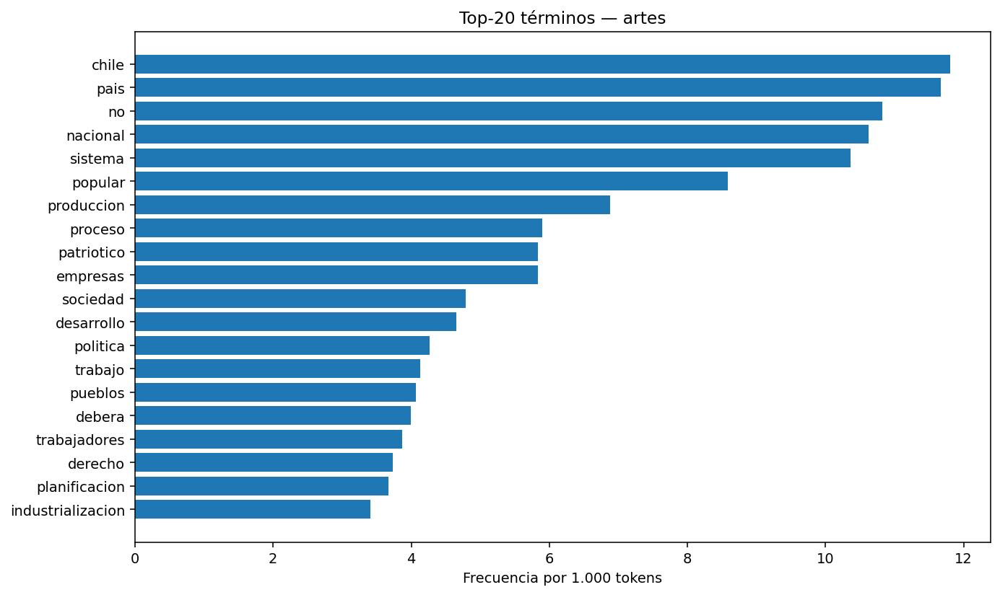

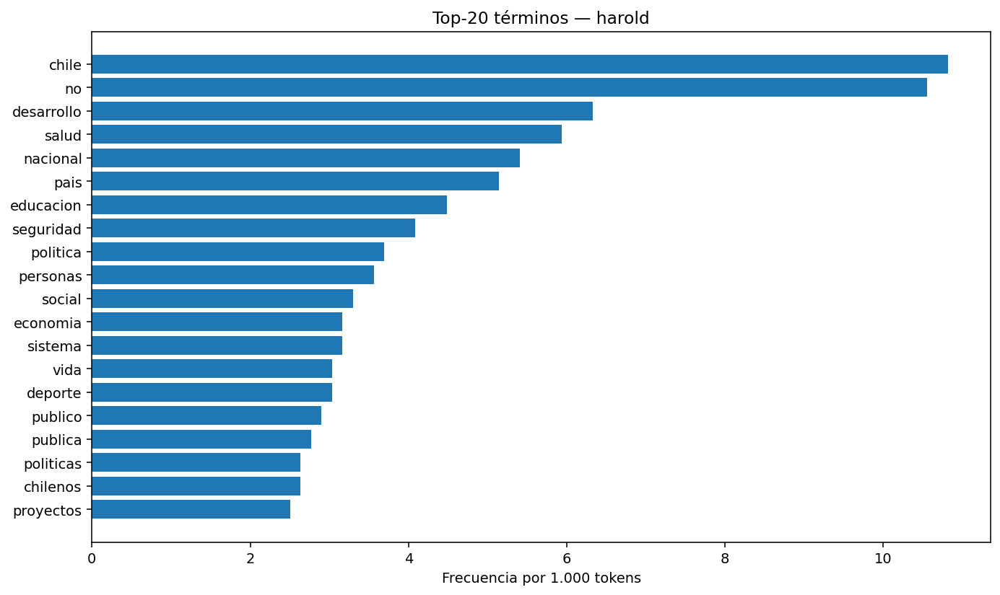

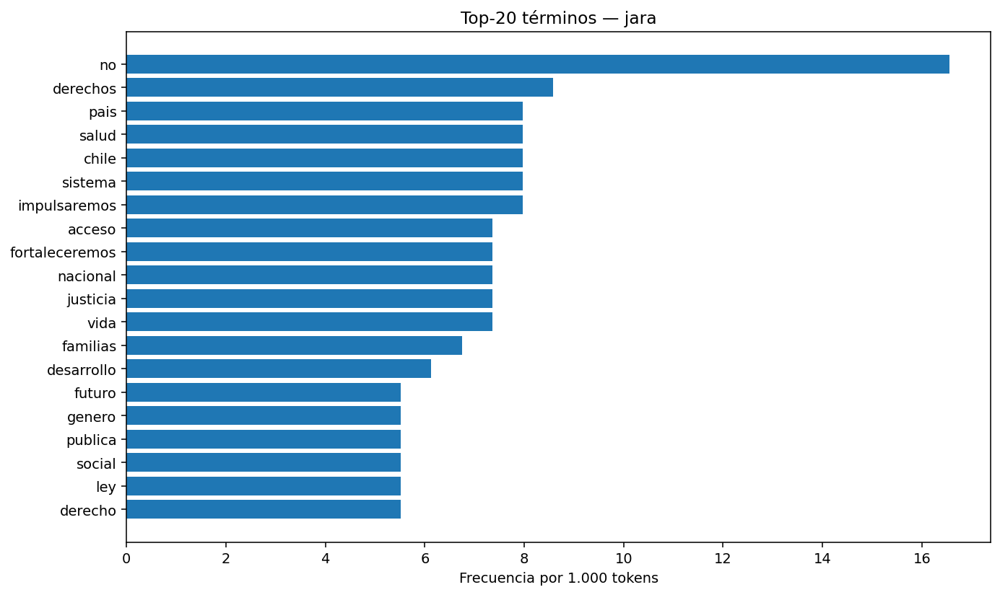

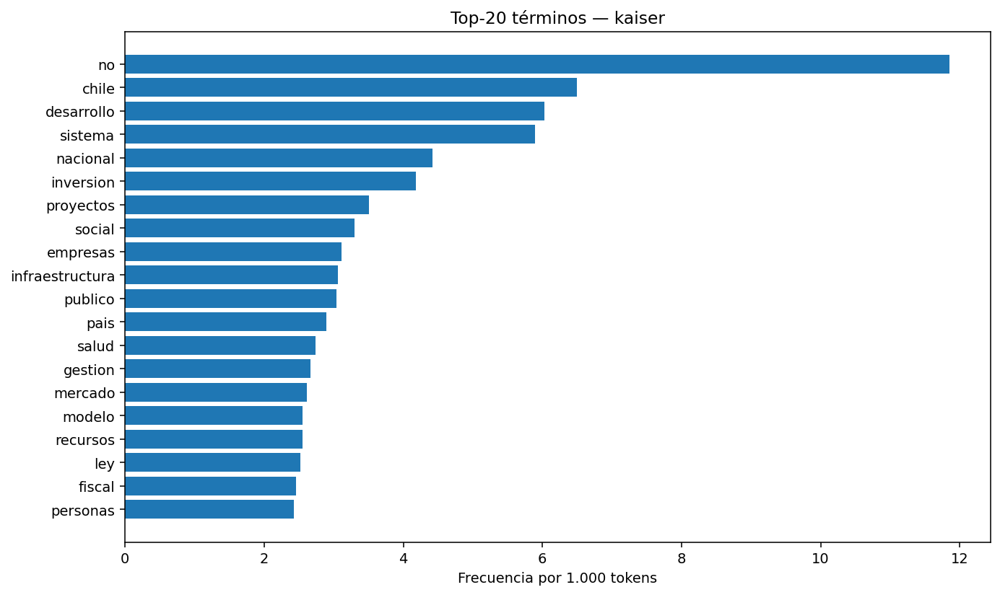

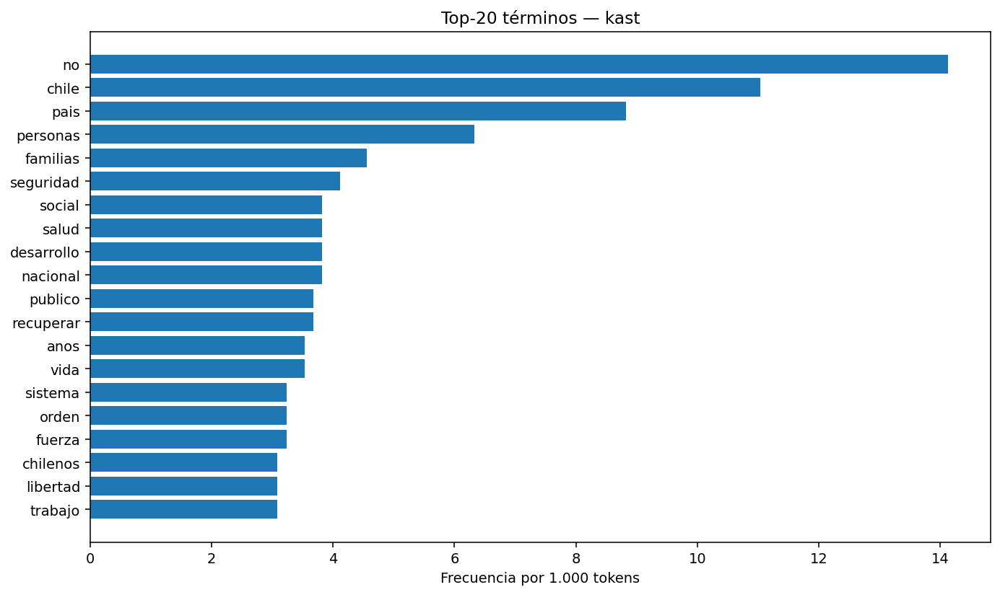

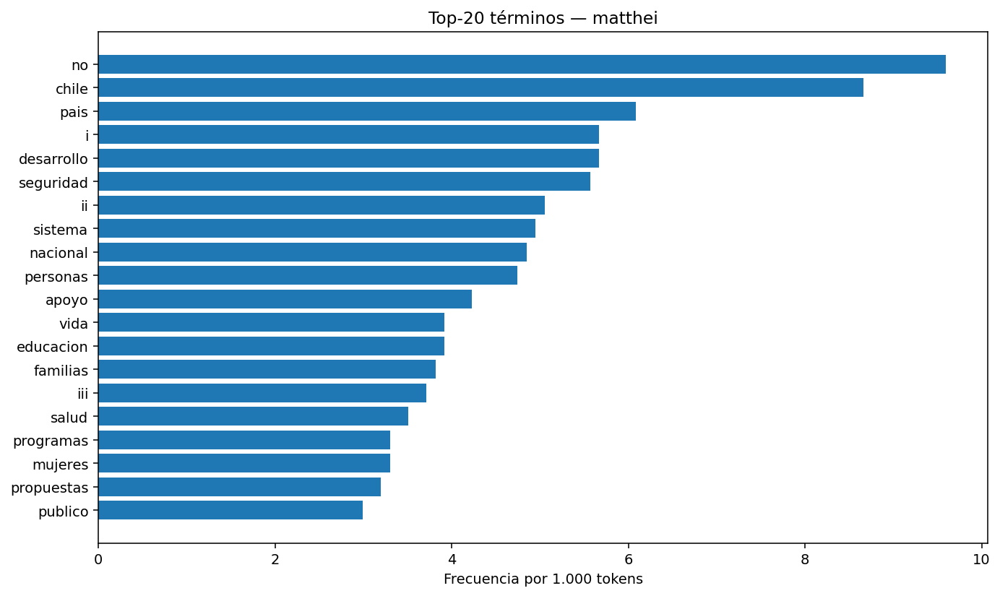

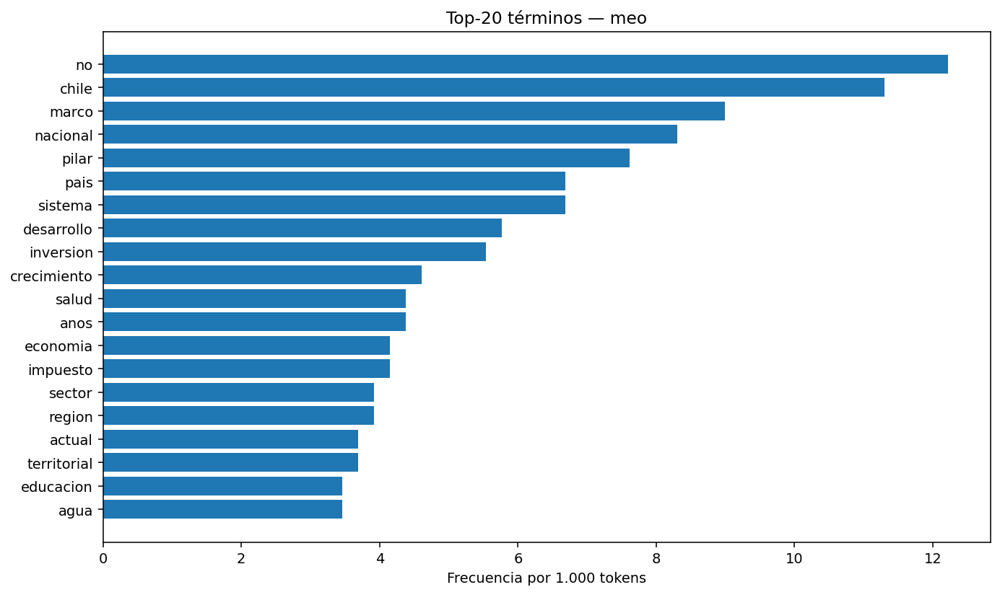

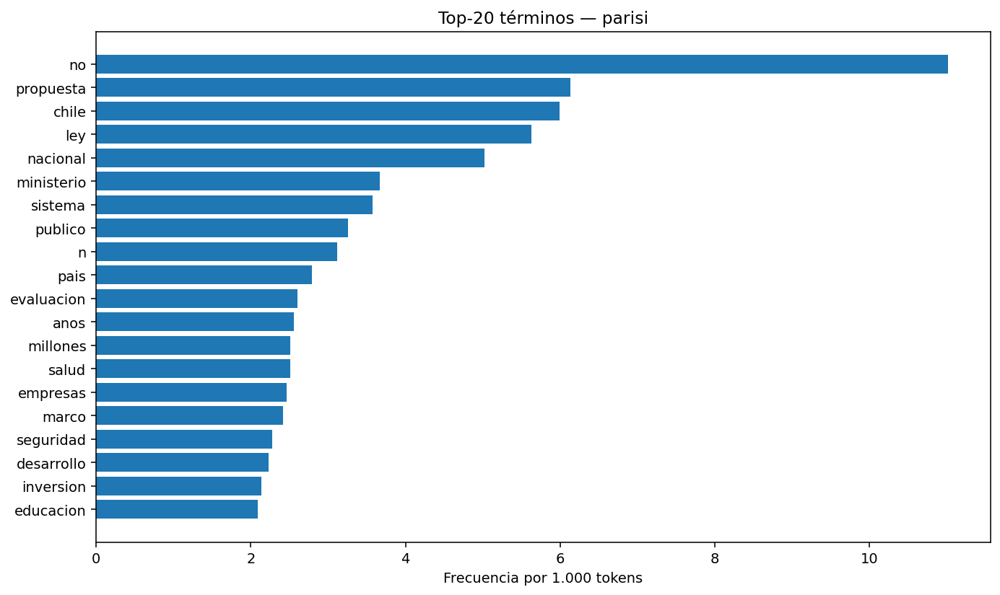

[M5X.3] generando wordclouds con rótulo


[M5X] wordclouds por candidato:   0%|          | 0/8 [00:00<?, ?it/s]

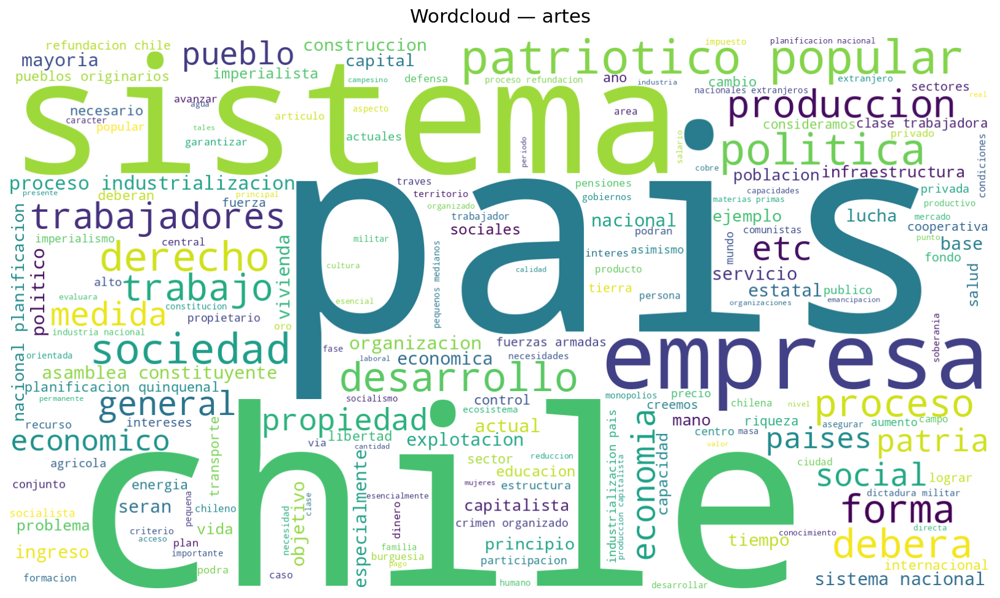

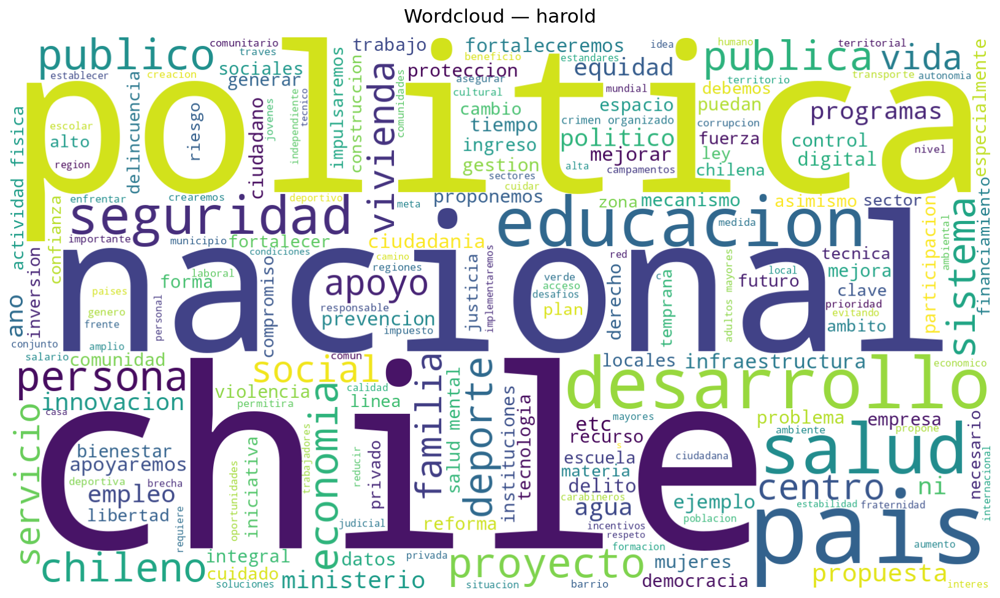

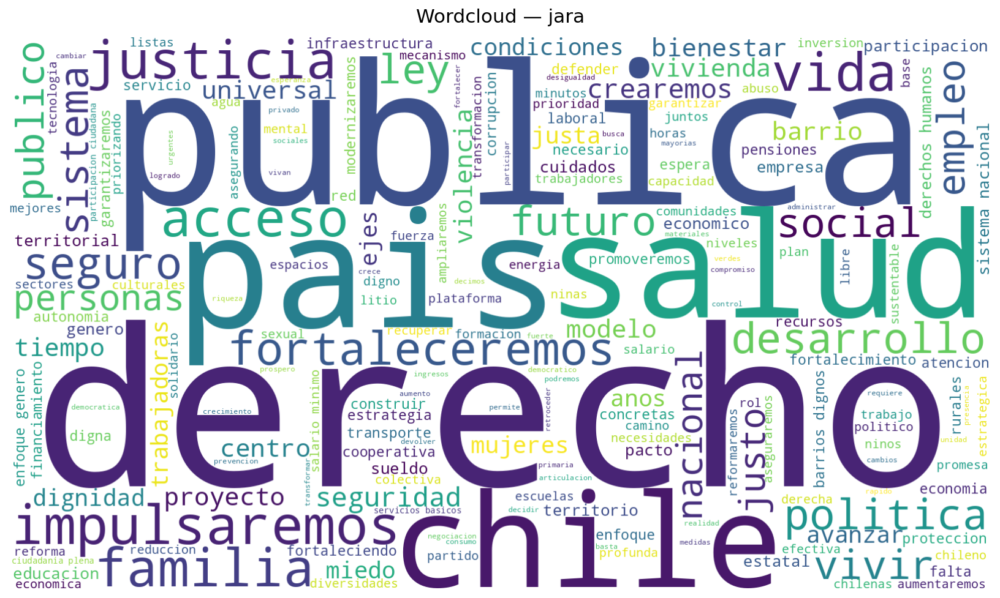

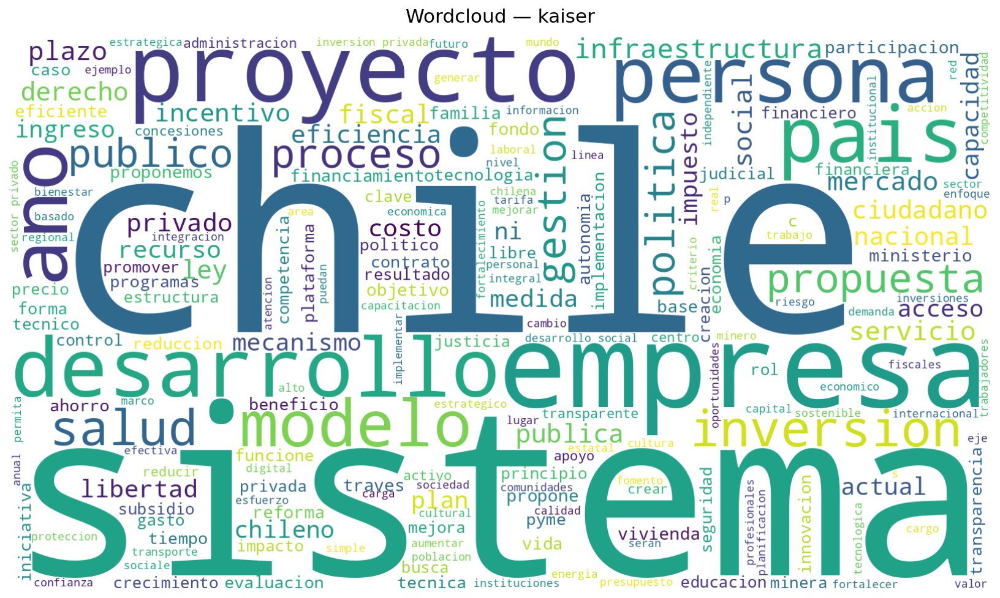

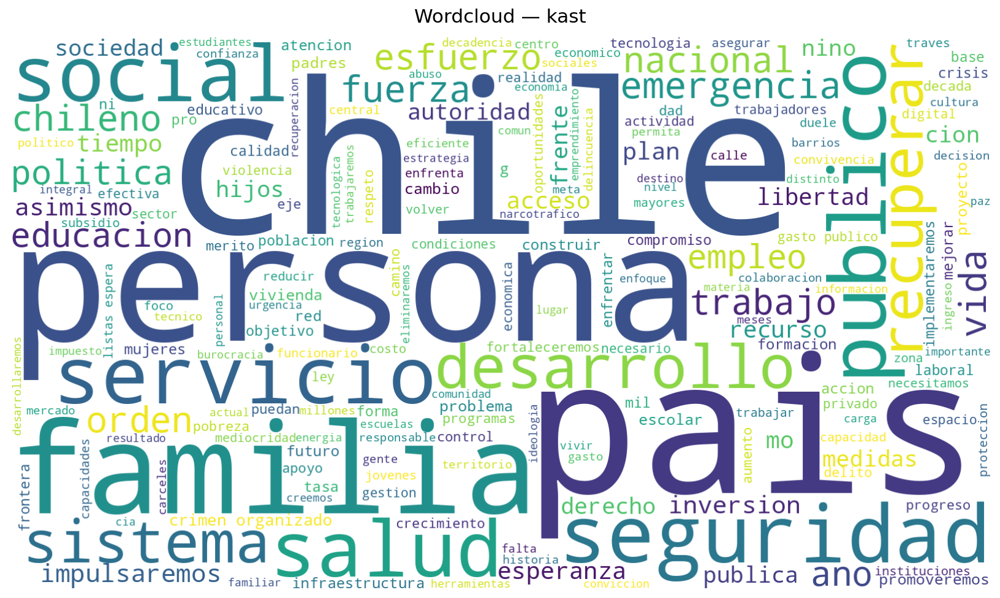

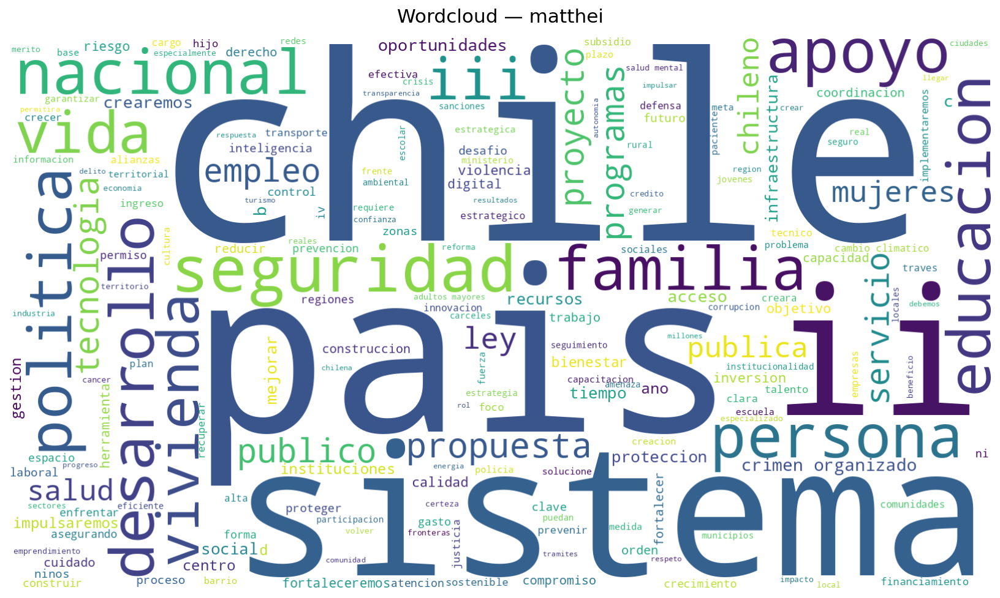

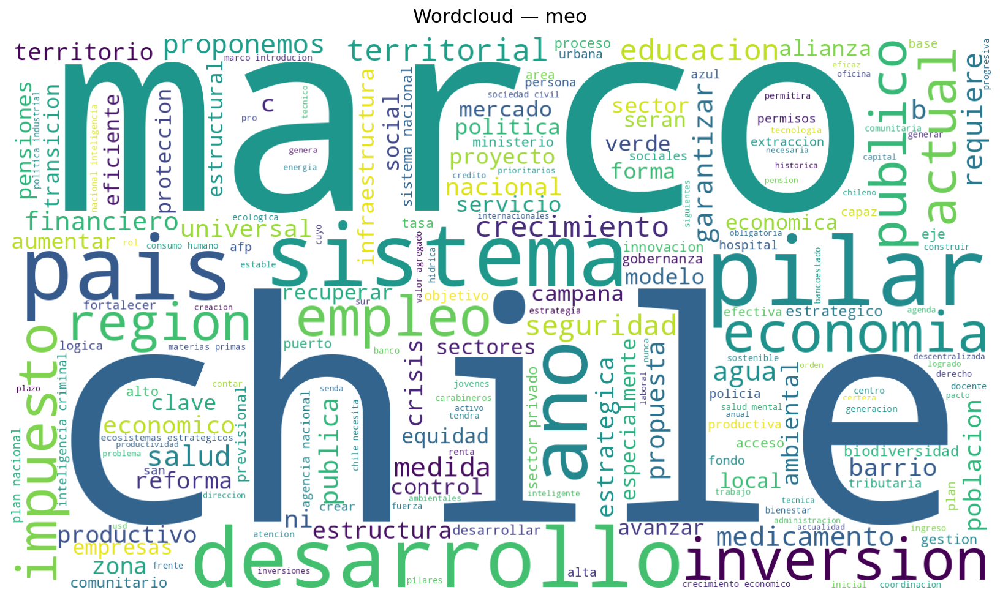

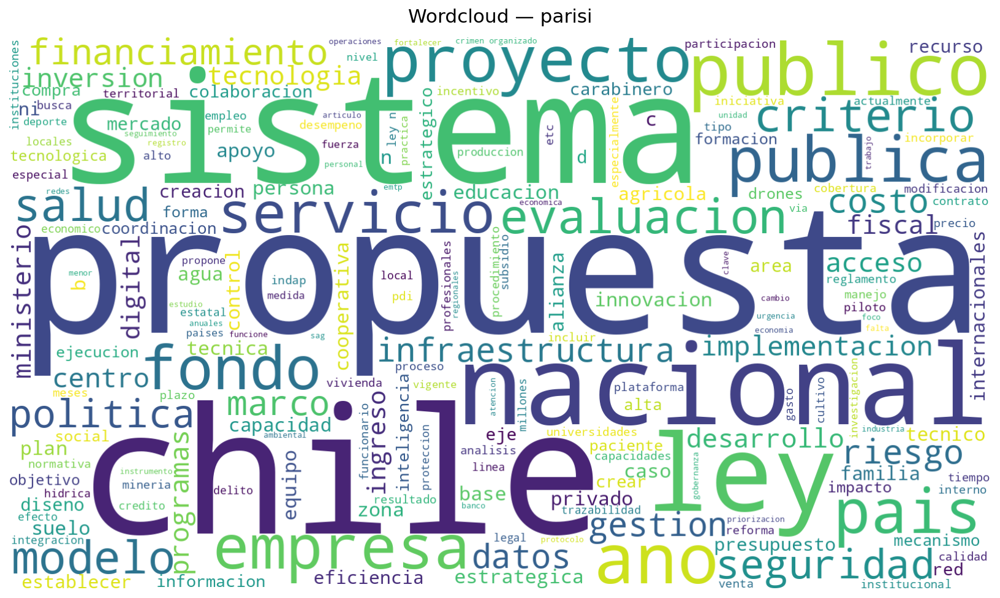

[M5X] fin en 44.84s — outputs: freq_unigrams.(parquet,csv), ./figs_freq/*.png, ./wordclouds/*.png


In [7]:
# %% MÓDULO 5 — extendido: frecuencias + visualizaciones (matplotlib) + wordclouds con rótulo
import time, itertools, math, re
from collections import Counter
from pathlib import Path
import numpy as np
import pandas as pd
from tqdm.auto import tqdm
import matplotlib.pyplot as plt
from wordcloud import WordCloud

t0 = time.time(); tqdm.write("[M5X] inicio")

# -------- parámetros de visualización --------
TOP_N = 20              # top palabras a graficar por candidato
FIG_DPI = 140
BAR_WIDTH = 0.8

# -------- helpers --------
def keep_token_vn_local(w):
    if not isinstance(w,str) or not w: return False
    if w in STOP_ALL: return False
    return bool(re.fullmatch(r"[A-Za-zÁÉÍÓÚÜÑáéíóúüñ]+", w, flags=re.UNICODE))

def tf_unigrams_df(df):
    c = Counter(df["token_vn"])
    tot = sum(c.values())
    rows = [{"term":t, "tf":f, "tf_per_k": (1000.0*f/max(tot,1))} for t,f in c.most_common()]
    return pd.DataFrame(rows)

# -------- 5.0 preparar directorios de salida --------
Path("figs_freq").mkdir(exist_ok=True)
Path("wordclouds").mkdir(exist_ok=True)

# -------- 5.1 construir tabla de frecuencias (unigramas) --------
tqdm.write("[M5X.1] construyendo tabla de frecuencias (unigramas)")
cand_terms = tokens.assign(tok_keep=tokens["token_vn"].progress_apply(keep_token_vn_local)).query("tok_keep")

unigrams = []
for cand, g in tqdm(cand_terms.groupby("candidate"), desc="[M5X] unigramas por candidato"):
    unigrams.append(tf_unigrams_df(g).assign(candidate=cand))
unigrams = pd.concat(unigrams, ignore_index=True)
unigrams = unigrams[["candidate","term","tf","tf_per_k"]]

# persistencia tabla frecuencias
unigrams.to_parquet("freq_unigrams.parquet", index=False)
unigrams.to_csv("freq_unigrams.csv", index=False, encoding="utf-8-sig")
tqdm.write("[M5X.1] tabla freq_unigrams.{parquet,csv} guardada")

# -------- 5.2 gráficos de barras (Top-N por candidato) --------
tqdm.write(f"[M5X.2] creando gráficos de barras Top-{TOP_N} por candidato (matplotlib)")
candidates = sorted(unigrams["candidate"].unique())
for cand in tqdm(candidates, desc="[M5X] barras por candidato"):
    sub = (unigrams[unigrams["candidate"]==cand]
           .sort_values("tf", ascending=False)
           .head(TOP_N))
    if sub.empty:
        continue
    # orden ascendente en eje y para legibilidad
    sub = sub.iloc[::-1]
    terms = sub["term"].tolist()
    vals = sub["tf_per_k"].tolist()

    plt.figure(figsize=(10, 6), dpi=FIG_DPI)
    plt.barh(range(len(terms)), vals, height=BAR_WIDTH)
    plt.yticks(range(len(terms)), terms)
    plt.xlabel("Frecuencia por 1.000 tokens")
    plt.title(f"Top-{TOP_N} términos — {cand}")
    plt.tight_layout()
    plt.show()

    # guardar PNG
    out = Path("figs_freq") / f"top{TOP_N}_freq_{cand}.png"
    plt.savefig(out, dpi=FIG_DPI, bbox_inches="tight")
    plt.close()

# -------- 5.3 wordclouds con rótulo del candidato en el PNG --------
tqdm.write("[M5X.3] generando wordclouds con rótulo")
for cand, df in tqdm(cand_terms.groupby("candidate"), desc="[M5X] wordclouds por candidato"):
    toks = [t for t in df["token_vn"] if keep_token_vn_local(t)]
    if not toks:
        continue
    txt = " ".join(toks)
    wc = WordCloud(width=1600, height=900, background_color="white").generate(txt)

    # Mostrar y guardar con título incrustado en la imagen (quedará en el PNG)
    plt.figure(figsize=(12, 7), dpi=FIG_DPI)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.title(f"Wordcloud — {cand}", pad=12, fontsize=16)  # título dentro del lienzo
    out = Path("wordclouds") / f"wordcloud_{cand}.png"
    plt.tight_layout()
    plt.show()
    plt.savefig(out, dpi=FIG_DPI, bbox_inches="tight")
    plt.close()

tqdm.write(f"[M5X] fin en {time.time()-t0:.2f}s — outputs: freq_unigrams.(parquet,csv), ./figs_freq/*.png, ./wordclouds/*.png")


In [8]:
# %% MÓDULO 6 — TF-IDF (unigramas/bigramas) con filtrado y top-features
!pip -q install scikit-learn tqdm

import re, math, numpy as np, pandas as pd
from pathlib import Path
from tqdm.auto import tqdm
from sklearn.feature_extraction.text import TfidfVectorizer
from scipy import sparse
tqdm.write("[M6] inicio")

# ---------- parámetros ----------
NGRAM_RANGE   = (1, 2)      # unigramas+bigramas
MIN_DF        = 2           # descarta términos muy raros (aplica a 'documentos' por candidato)
MAX_DF        = 0.9         # descarta términos extremadamente frecuentes
MAX_FEATURES  = 50000       # límite superior opcional (0/None = sin límite)
TOP_PER_CAND  = 30          # top features por candidato (según TF-IDF promedio)

# ---------- utilidades ----------
def _ensure_stop_all():
    # STOP_ALL viene de Fase 1. si no existe, definimos una versión mínima.
    global STOP_ALL
    try:
        _ = STOP_ALL
    except NameError:
        STOP_ALL = set(["el","la","los","las","de","del","y","o","u","en","para","por","con","un","una","que","se","su","sus","al","lo","como","más","ya"])
    return STOP_ALL

STOP_ALL = _ensure_stop_all()

def tokenizer_vn(s: str):
    # texto ya normalizado (text_vn): minúsculas, sin tildes/puntuación.
    if not isinstance(s, str): return []
    toks = s.split()
    toks = [t for t in toks if t and (t not in STOP_ALL)]
    return toks

# ---------- carga y preparación ----------
DOCS_NORM = Path("documents_norm.parquet")
assert DOCS_NORM.exists(), "Falta documents_norm.parquet (ejecuta Fase 1, Módulo 2)."

docs_norm = pd.read_parquet(DOCS_NORM)  # columnas: candidate, filename, text_vl, text_vn
# agregamos a nivel candidato: un documento por candidato
cand_text = (docs_norm
             .groupby("candidate", as_index=False)
             .agg(text_vn=("text_vn", lambda s: "\n".join(s))))
tqdm.write(f"[M6] candidatos: {len(cand_text)}")

# ---------- vectorización ----------
tqdm.write("[M6] vectorizando TF-IDF (esto puede tomar tiempo)")
vectorizer = TfidfVectorizer(
    analyzer="word",
    tokenizer=tokenizer_vn,
    ngram_range=NGRAM_RANGE,
    min_df=MIN_DF,
    max_df=MAX_DF,
    max_features=MAX_FEATURES,
    lowercase=False,     # ya viene en minúsculas desde text_vn
    dtype=np.float32
)

X = vectorizer.fit_transform(tqdm(cand_text["text_vn"], desc="[M6] fit_transform"))
terms = np.array(vectorizer.get_feature_names_out())

# ---------- matriz candidato × término ----------
candidates = cand_text["candidate"].tolist()
tqdm.write(f"[M6] matriz TF-IDF: {X.shape[0]} candidatos × {X.shape[1]} términos")

# persistimos matriz y vocabulario
sparse.save_npz("tfidf_matrix_candidate_term.npz", X)
pd.DataFrame({"term": terms}).to_parquet("tfidf_terms.parquet", index=False)
pd.DataFrame({"candidate": candidates}).to_parquet("tfidf_candidates.parquet", index=False)

# ---------- top-features por candidato ----------
rows = []
for i, cand in enumerate(tqdm(candidates, desc="[M6] top-features candidatos")):
    row = X[i].toarray().ravel()
    if row.size == 0: 
        continue
    idx = np.argsort(row)[-TOP_PER_CAND:][::-1]
    for r, j in enumerate(idx, start=1):
        rows.append({"candidate": cand, "rank": r, "term": terms[j], "tfidf": float(row[j])})

top_tfidf = pd.DataFrame(rows)
top_tfidf.to_parquet("tfidf_top_features.parquet", index=False)
top_tfidf.to_csv("tfidf_top_features.csv", index=False, encoding="utf-8-sig")

# ---------- resumen ----------
tqdm.write("[M6] outputs:")
tqdm.write("  - tfidf_matrix_candidate_term.npz")
tqdm.write("  - tfidf_terms.parquet, tfidf_candidates.parquet")
tqdm.write("  - tfidf_top_features.(parquet|csv)")


[M6] inicio
[M6] candidatos: 8
[M6] vectorizando TF-IDF (esto puede tomar tiempo)



[notice] A new release of pip is available: 24.1.2 -> 25.3
[notice] To update, run: python.exe -m pip install --upgrade pip


[M6] fit_transform:   0%|          | 0/8 [00:00<?, ?it/s]

C:\Users\Rodrigo\AppData\Roaming\Python\Python312\site-packages\sklearn\feature_extraction\text.py:521: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


[M6] matriz TF-IDF: 8 candidatos × 11250 términos


[M6] top-features candidatos:   0%|          | 0/8 [00:00<?, ?it/s]

[M6] outputs:
  - tfidf_matrix_candidate_term.npz
  - tfidf_terms.parquet, tfidf_candidates.parquet
  - tfidf_top_features.(parquet|csv)


In [9]:
# %% MÓDULO 7 — LDA (gensim) con coherencia y asignación por candidato
!pip -q install gensim tqdm

import re, math, numpy as np, pandas as pd
from pathlib import Path
from tqdm.auto import tqdm
from gensim.corpora import Dictionary
from gensim.models.ldamodel import LdaModel
from gensim.models.coherencemodel import CoherenceModel

tqdm.write("[M7] inicio")

# ---------- parámetros ----------
K_GRID        = [5, 7, 10, 12, 15]  # valores candidatos para k
PASSES        = 8                   # pasadas por corpus
ITERATIONS    = 200                 # iteraciones internas
RANDOM_STATE  = 42
TOP_WORDS     = 15                  # top términos por tópico
MIN_DOC_FREQ  = 2                   # filtra tokens muy raros (diccionario.filter_extremes)
MAX_DOC_PROP  = 0.9                 # filtra tokens demasiado frecuentes
KEEP_N        = 50000               # límite superior de vocab (0/None = sin límite)

# ---------- utilidades ----------
def _ensure_keep_fn_and_stop():
    # STOP_ALL y keep_token_vn_local provienen de Fase 1; si no existen, definimos mínimos.
    global STOP_ALL
    try:
        _ = STOP_ALL
    except NameError:
        STOP_ALL = set(["el","la","los","las","de","del","y","o","u","en","para","por","con","un","una","que","se","su","sus","al","lo","como","más","ya","no","ni","nunca","jamás"])
    def keep_token_vn_local(w):
        if not isinstance(w,str) or not w: return False
        if w in STOP_ALL: return False
        return bool(re.fullmatch(r"[A-Za-zÁÉÍÓÚÜÑáéíóúüñ<NUM>]+", w, flags=re.UNICODE))
    return keep_token_vn_local

keep_token_vn_local = _ensure_keep_fn_and_stop()

# ---------- carga ----------
TOKENS = Path("tokens.parquet")
assert TOKENS.exists(), "Falta tokens.parquet (ejecuta Fase 1, Módulo 3)."

tokens = pd.read_parquet(TOKENS)
# construimos documentos a nivel (candidate, filename) con lista de tokens VN filtrados
tqdm.write("[M7] preparando documentos (lista de tokens por programa)")
docs_g = []
meta_g = []
for (cand, fname), g in tqdm(tokens.groupby(["candidate","filename"], sort=False), desc="[M7] agrupar programas"):
    toks = [t for t in g["token_vn"] if keep_token_vn_local(t)]
    if len(toks) == 0:
        continue
    docs_g.append(toks)
    meta_g.append({"candidate": cand, "filename": fname})
meta = pd.DataFrame(meta_g)
tqdm.write(f"[M7] documentos para LDA: {len(docs_g)}")

# ---------- diccionario y corpus ----------
tqdm.write("[M7] construyendo diccionario y corpus")
dictionary = Dictionary(docs_g)
dictionary.filter_extremes(no_below=MIN_DOC_FREQ,
                           no_above=MAX_DOC_PROP,
                           keep_n=KEEP_N if KEEP_N else None)
corpus = [dictionary.doc2bow(doc) for doc in docs_g]
vocab_size = len(dictionary)
tqdm.write(f"[M7] vocab_size={vocab_size}")

# ---------- búsqueda de k por coherencia ----------
coh_rows = []
for k in tqdm(K_GRID, desc="[M7] grid k"):
    lda_k = LdaModel(
        corpus=corpus,
        id2word=dictionary,
        num_topics=k,
        random_state=RANDOM_STATE,
        passes=PASSES,
        iterations=ITERATIONS,
        eval_every=None,
        minimum_probability=0.0
    )
    cm = CoherenceModel(model=lda_k, texts=docs_g, dictionary=dictionary, coherence="c_v")
    c = cm.get_coherence()
    coh_rows.append({"k": k, "coherence_c_v": c})
coh_df = pd.DataFrame(coh_rows).sort_values("coherence_c_v", ascending=False)
coh_df.to_parquet("lda_coherence.parquet", index=False)
coh_df.to_csv("lda_coherence.csv", index=False, encoding="utf-8-sig")

best_k = int(coh_df.iloc[0]["k"]) if len(coh_df) else K_GRID[0]
tqdm.write(f"[M7] mejor k por coherencia (c_v): {best_k}")

# ---------- modelo final con k óptimo ----------
tqdm.write("[M7] ajustando LDA final")
lda = LdaModel(
    corpus=corpus,
    id2word=dictionary,
    num_topics=best_k,
    random_state=RANDOM_STATE,
    passes=PASSES,
    iterations=ITERATIONS,
    eval_every=None,
    minimum_probability=0.0
)

# ---------- tópicos: top palabras ----------
topic_rows = []
for tid in range(best_k):
    terms = lda.get_topic_terms(tid, topn=TOP_WORDS)  # (token_id, prob)
    for rank, (token_id, prob) in enumerate(terms, start=1):
        topic_rows.append({
            "topic_id": tid,
            "rank": rank,
            "term": dictionary[token_id],
            "prob": float(prob)
        })
topics_table = pd.DataFrame(topic_rows)
topics_table.to_parquet("lda_topics_topwords.parquet", index=False)
topics_table.to_csv("lda_topics_topwords.csv", index=False, encoding="utf-8-sig")

# ---------- distribución de tópicos por documento (programa) ----------
gamma_rows = []
for i, bow in enumerate(tqdm(corpus, desc="[M7] infer doc-topic")):
    # get_document_topics devuelve (topic_id, prob) sólo para los no-cero
    dist = lda.get_document_topics(bow, minimum_probability=0.0)
    cand = meta.iloc[i]["candidate"]; fname = meta.iloc[i]["filename"]
    for (tid, prob) in dist:
        gamma_rows.append({"candidate": cand, "filename": fname, "topic_id": tid, "prob": float(prob)})
doc_topic = pd.DataFrame(gamma_rows)
doc_topic.to_parquet("lda_doc_topic.parquet", index=False)
doc_topic.to_csv("lda_doc_topic.csv", index=False, encoding="utf-8-sig")

# ---------- asignación de tópico dominante por documento ----------
dominant = (doc_topic.sort_values(["candidate","filename","prob"], ascending=[True,True,False])
                     .groupby(["candidate","filename"], as_index=False)
                     .first()
                     .rename(columns={"topic_id":"topic_dominant","prob":"prob_dominant"}))
dominant.to_parquet("lda_doc_dominant.parquet", index=False)
dominant.to_csv("lda_doc_dominant.csv", index=False, encoding="utf-8-sig")

# ---------- promedio por candidato de la distribución de tópicos ----------
cand_topic = (doc_topic.groupby(["candidate","topic_id"], as_index=False)["prob"].mean()
                        .rename(columns={"prob":"prob_mean"}))
cand_topic.to_parquet("lda_candidate_topic_mean.parquet", index=False)
cand_topic.to_csv("lda_candidate_topic_mean.csv", index=False, encoding="utf-8-sig")

# ---------- resumen ----------
tqdm.write("[M7] outputs:")
tqdm.write("  - lda_coherence.(parquet|csv)  [selección de k]")
tqdm.write("  - lda_topics_topwords.(parquet|csv)")
tqdm.write("  - lda_doc_topic.(parquet|csv)")
tqdm.write("  - lda_doc_dominant.(parquet|csv)")
tqdm.write("  - lda_candidate_topic_mean.(parquet|csv)")
tqdm.write(f"[M7] k_final={best_k}, docs={len(corpus)}, vocab={vocab_size}")



[notice] A new release of pip is available: 24.1.2 -> 25.3
[notice] To update, run: python.exe -m pip install --upgrade pip


[M7] inicio
[M7] preparando documentos (lista de tokens por programa)


[M7] agrupar programas:   0%|          | 0/8 [00:00<?, ?it/s]

[M7] documentos para LDA: 8
[M7] construyendo diccionario y corpus
[M7] vocab_size=6538


[M7] grid k:   0%|          | 0/5 [00:00<?, ?it/s]

[M7] mejor k por coherencia (c_v): 5
[M7] ajustando LDA final


[M7] infer doc-topic:   0%|          | 0/8 [00:00<?, ?it/s]

[M7] outputs:
  - lda_coherence.(parquet|csv)  [selección de k]
  - lda_topics_topwords.(parquet|csv)
  - lda_doc_topic.(parquet|csv)
  - lda_doc_dominant.(parquet|csv)
  - lda_candidate_topic_mean.(parquet|csv)
[M7] k_final=5, docs=8, vocab=6538


[M8] inicio
[M8] cargando TF-IDF y LDA
[M8] tablas resumen
[M8] plot coherencia LDA vs k


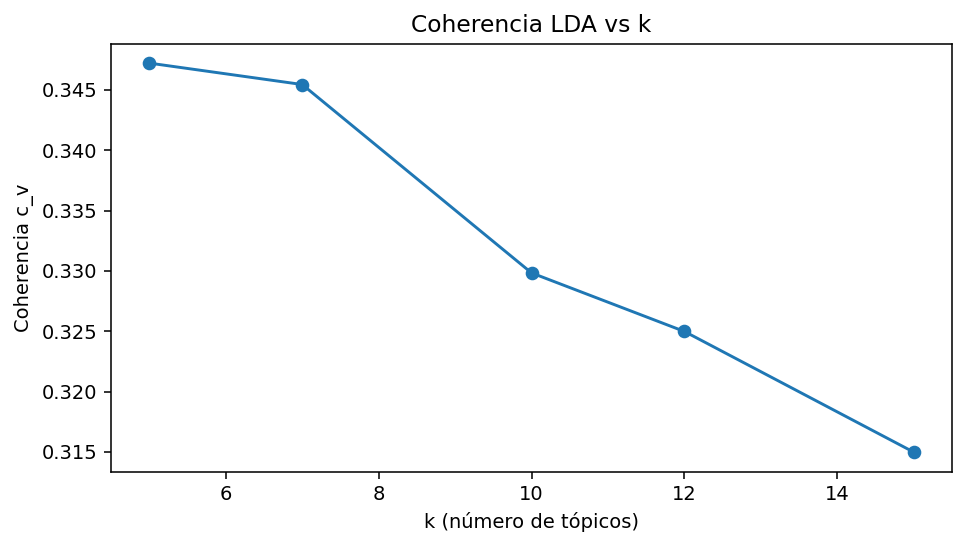

[M8] heatmap TF-IDF (union top términos por candidato)


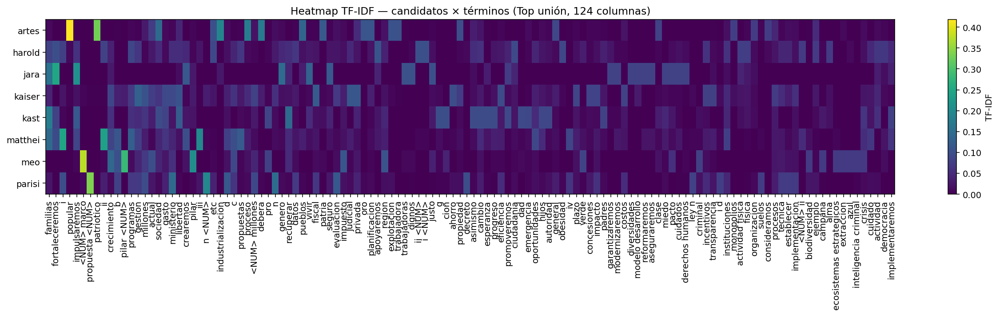

[M8] histogramas TF-IDF por candidato


[M8] hist TF-IDF:   0%|          | 0/8 [00:00<?, ?it/s]

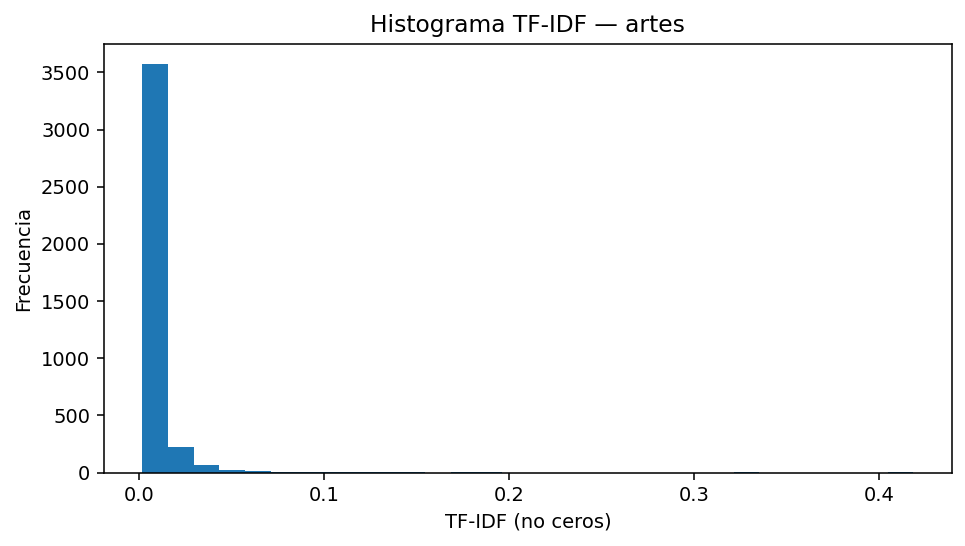

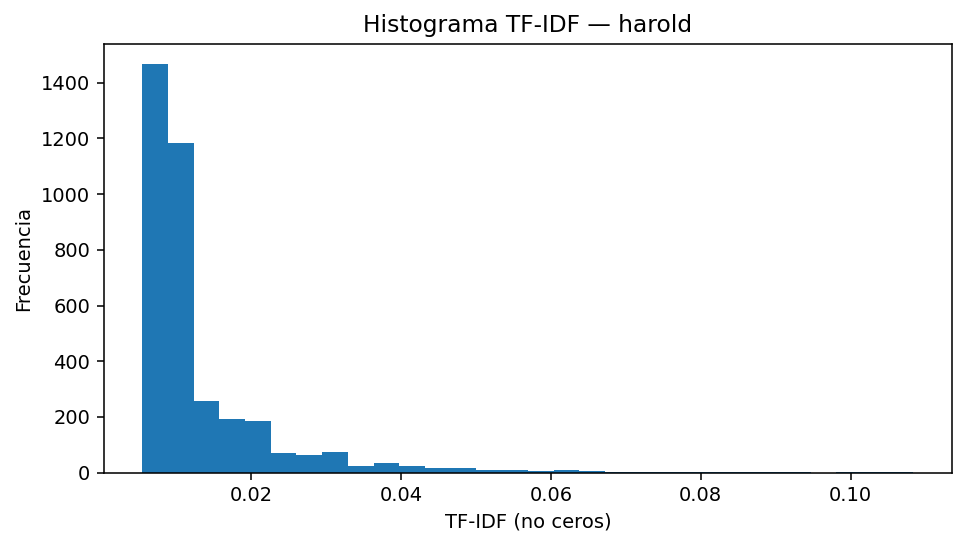

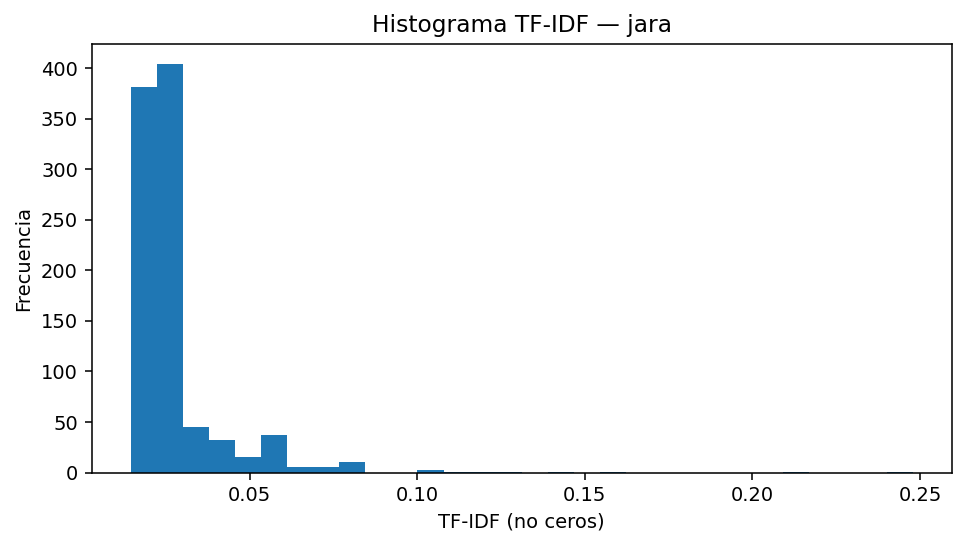

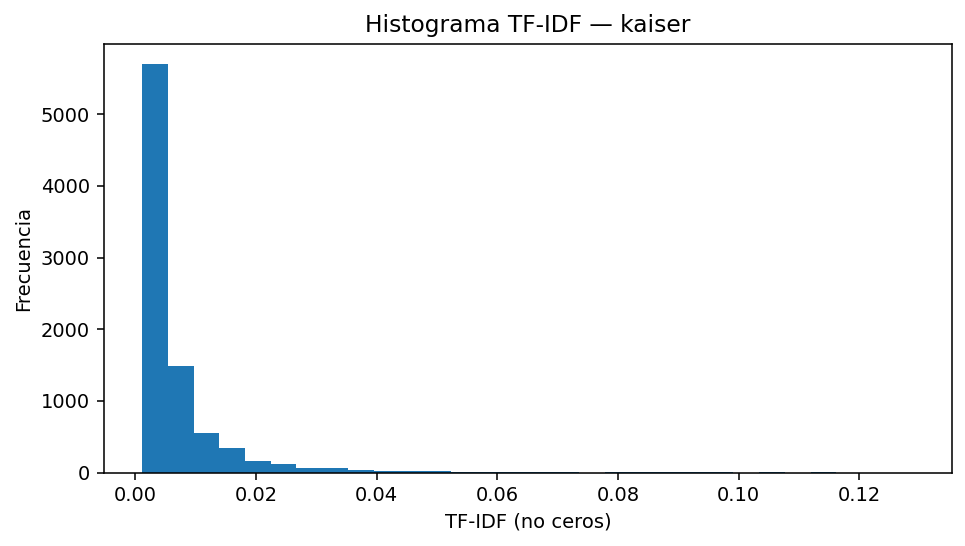

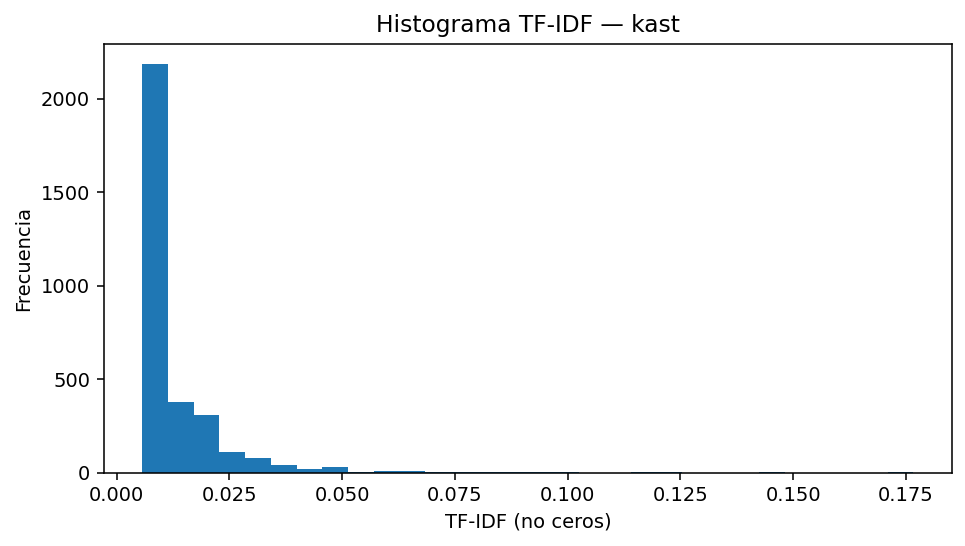

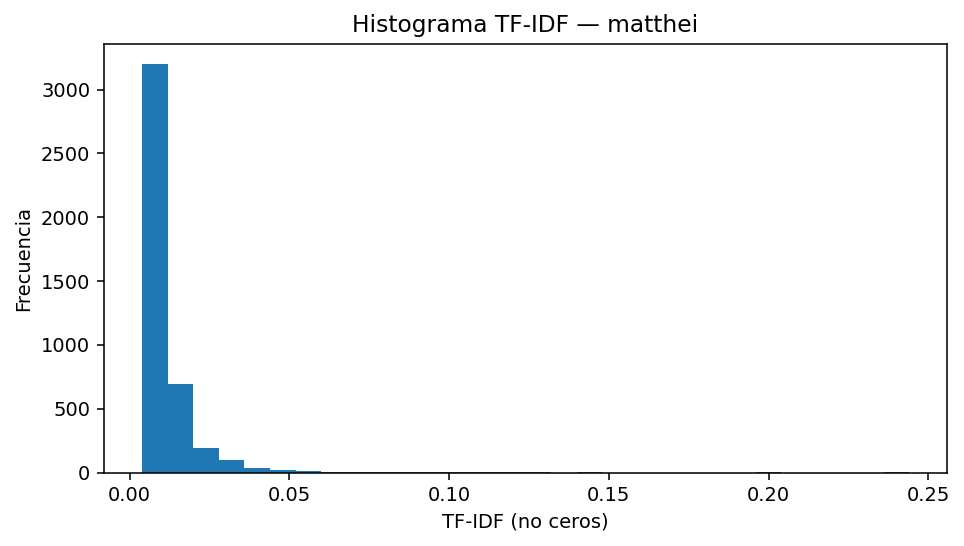

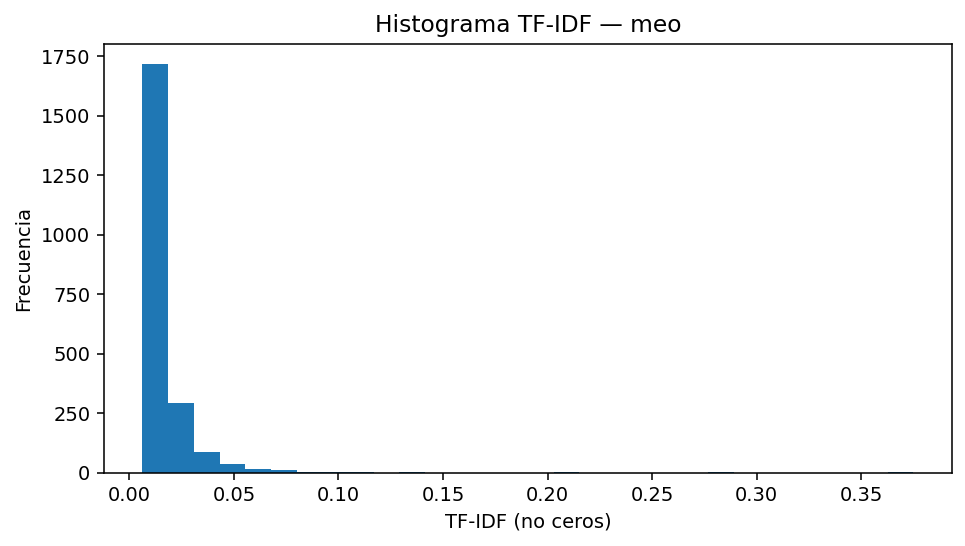

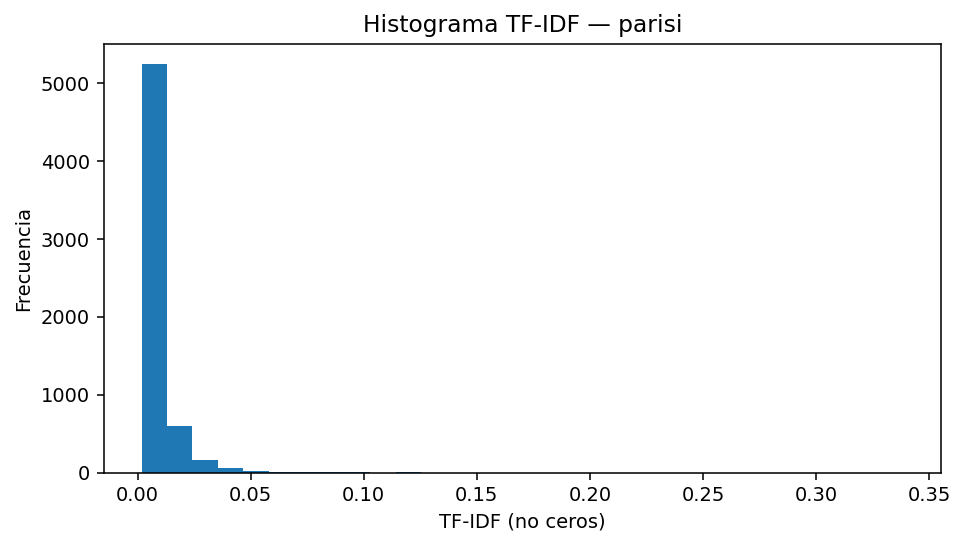

[M8] SVD 2D y clustering de candidatos


C:\Users\Rodrigo\AppData\Roaming\Python\Python312\site-packages\joblib\externals\loky\backend\context.py:136: UserWarning: Could not find the number of physical cores for the following reason:
[WinError 2] El sistema no puede encontrar el archivo especificado
Returning the number of logical cores instead. You can silence this warning by setting LOKY_MAX_CPU_COUNT to the number of cores you want to use.
  warnings.warn(
  File "C:\Users\Rodrigo\AppData\Roaming\Python\Python312\site-packages\joblib\externals\loky\backend\context.py", line 257, in _count_physical_cores
    cpu_info = subprocess.run(
               ^^^^^^^^^^^^^^^
  File "c:\Program Files\Python312\Lib\subprocess.py", line 548, in run
    with Popen(*popenargs, **kwargs) as process:
         ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Program Files\Python312\Lib\subprocess.py", line 1026, in __init__
    self._execute_child(args, executable, preexec_fn, close_fds,
  File "c:\Program Files\Python312\Lib\subprocess.py", line 1538

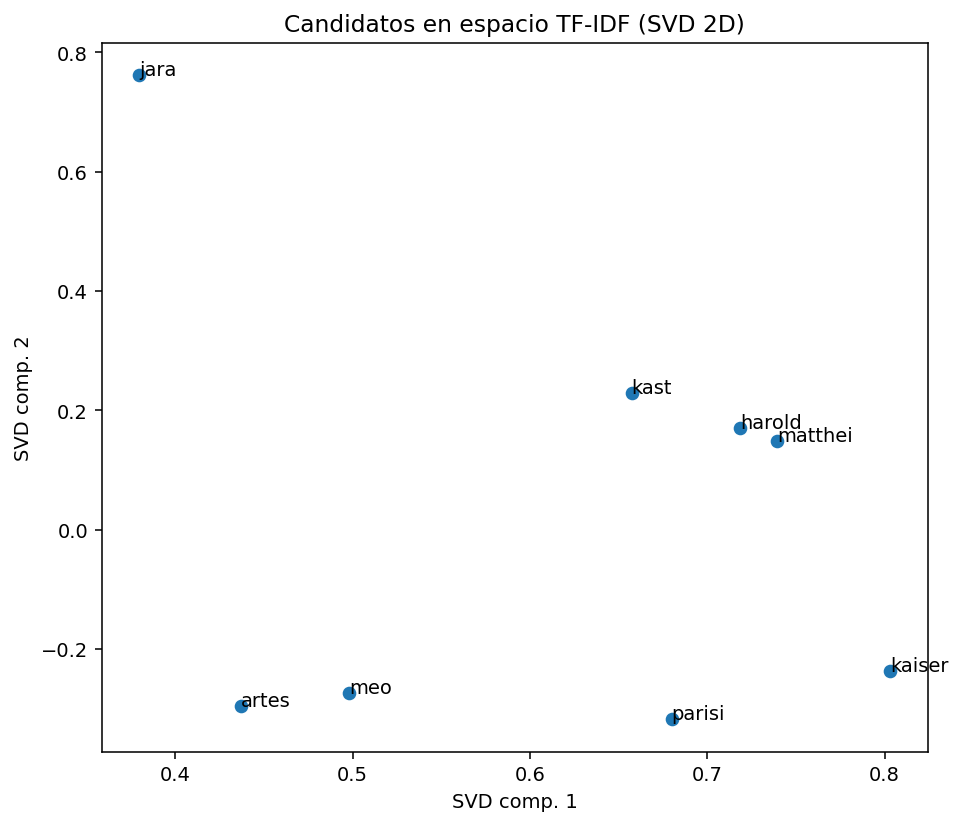

[M8] SVD 2D y clustering de términos top


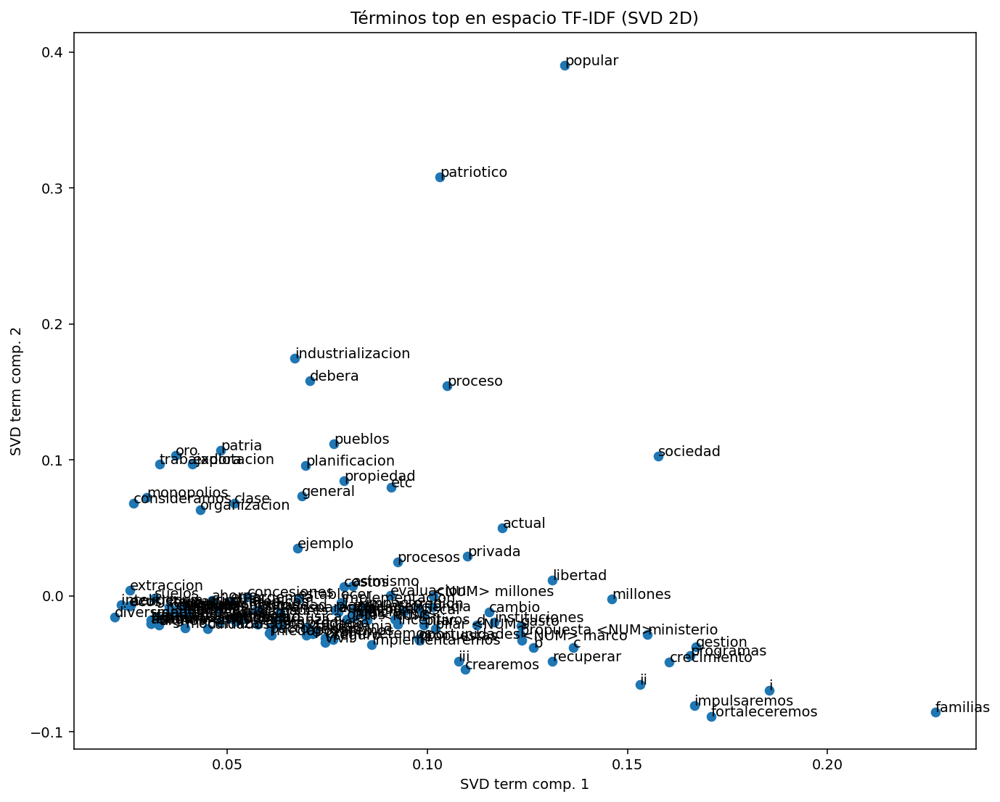

[M8] heatmap distribución de tópicos por candidato (LDA)


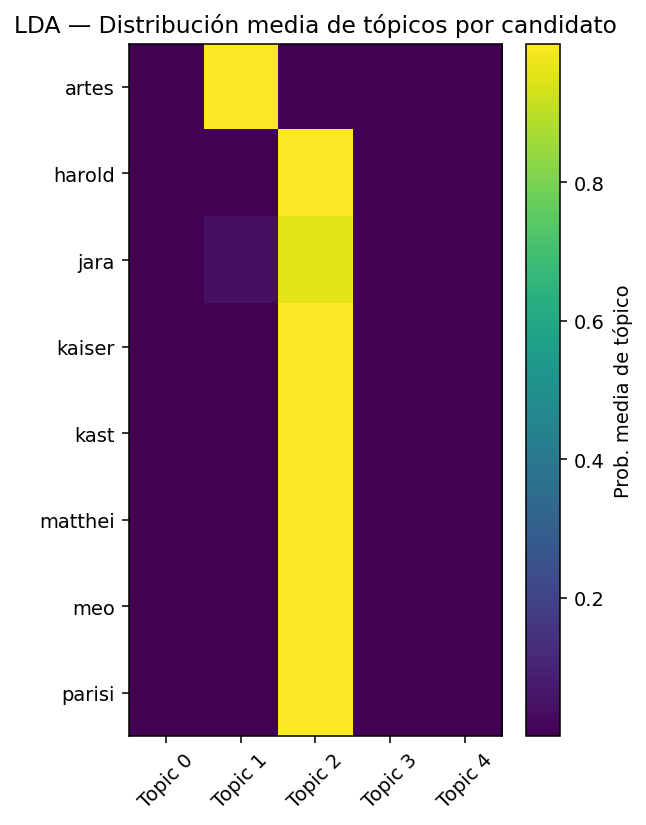

[M8] barras por tópico (top palabras)


[M8] topic bars:   0%|          | 0/5 [00:00<?, ?it/s]

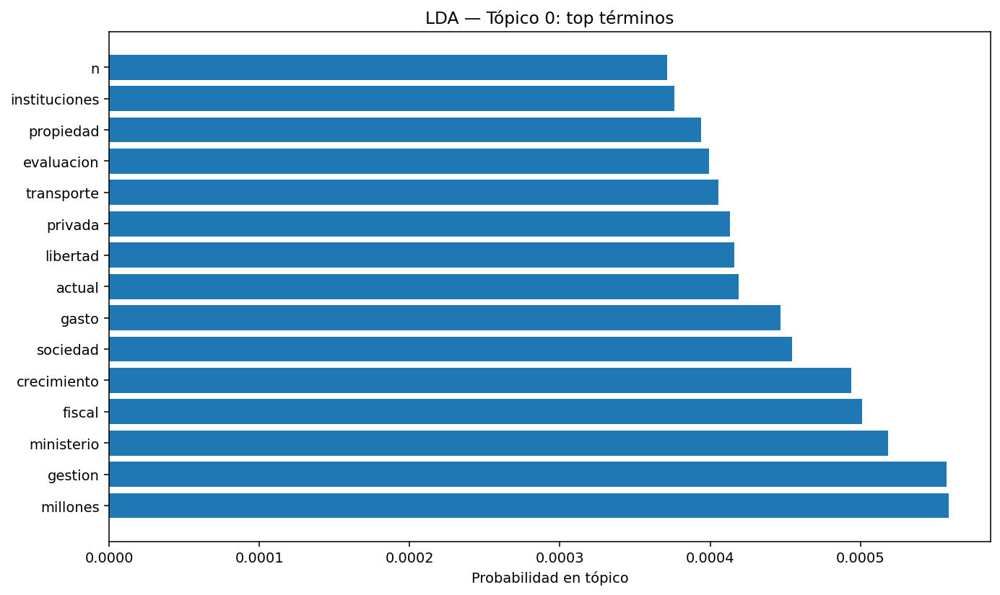

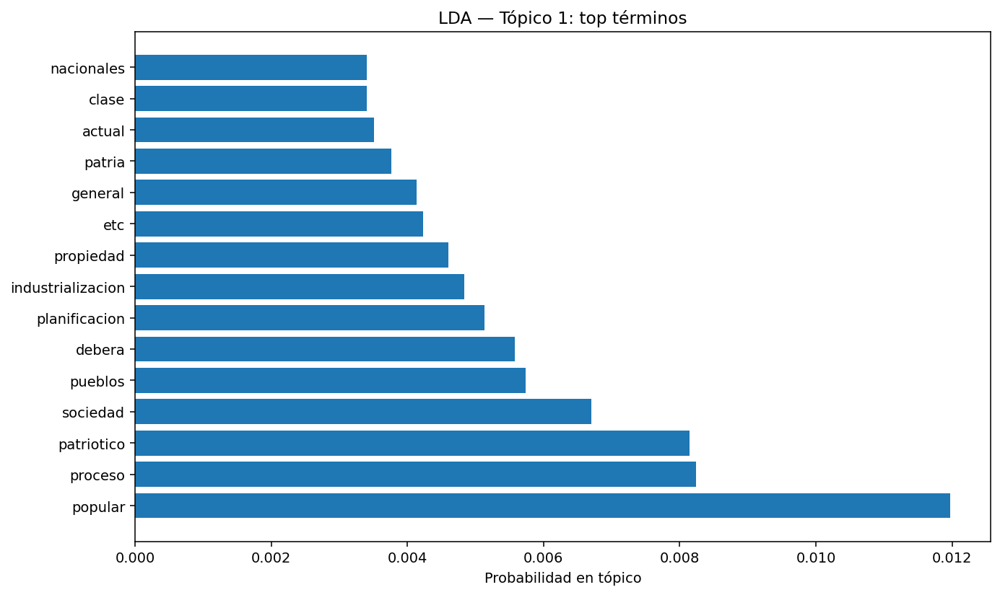

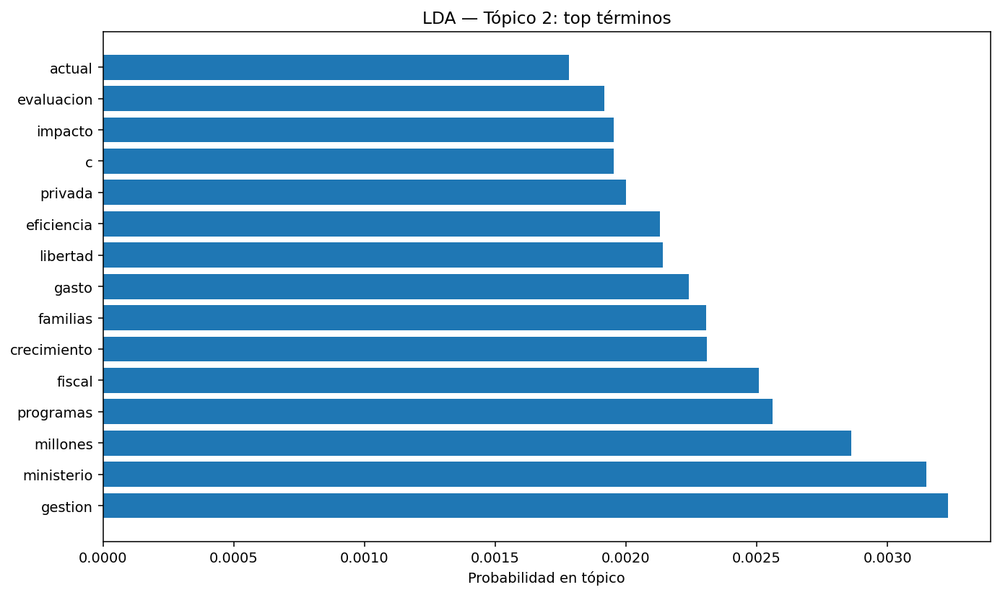

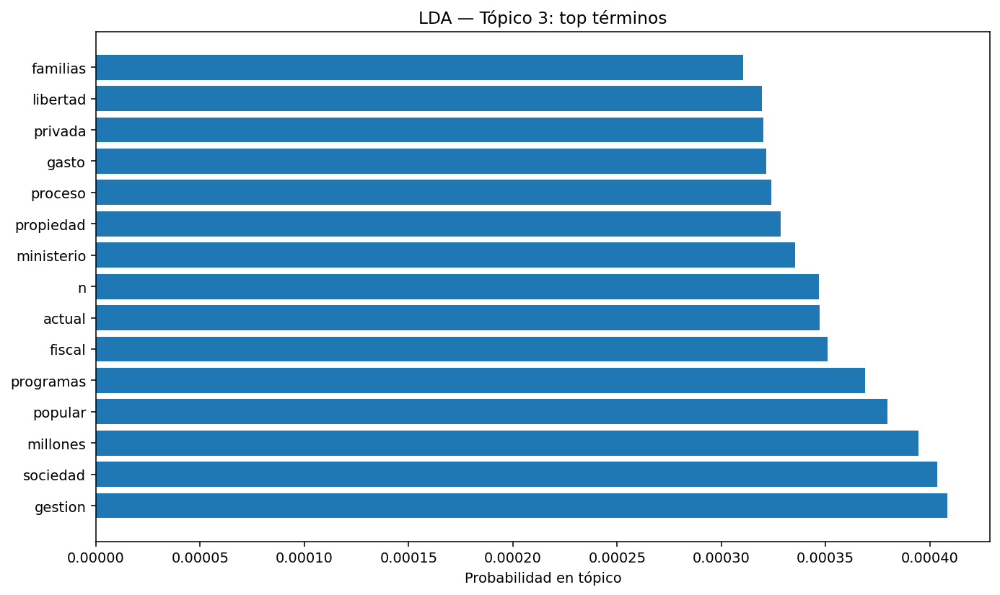

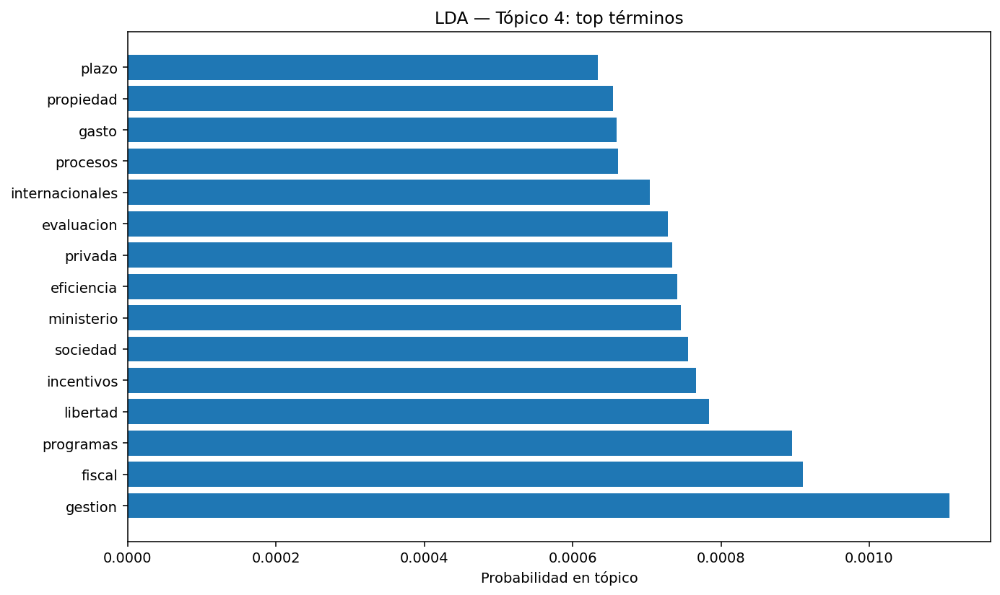

[M8] tabla de tópico dominante por documento (programa)
[M8] fin — visualizaciones en ./figs_viz y tablas en CSV


In [1]:
import os, math, re, numpy as np, pandas as pd
from pathlib import Path
from tqdm.auto import tqdm
import matplotlib.pyplot as plt
from scipy import sparse
from sklearn.decomposition import TruncatedSVD
from sklearn.cluster import KMeans

tqdm.write("[M8] inicio")

# ------------------ RUTAS DE ENTRADA ------------------
TFIDF_MTX = Path("tfidf_matrix_candidate_term.npz")
TFIDF_TERMS = Path("tfidf_terms.parquet")
TFIDF_CANDS = Path("tfidf_candidates.parquet")
TFIDF_TOP   = Path("tfidf_top_features.parquet")  # generado en M6

LDA_KSEL    = Path("lda_coherence.parquet")
LDA_TOPW    = Path("lda_topics_topwords.parquet")
LDA_DOCTOP  = Path("lda_doc_topic.parquet")
LDA_DOM     = Path("lda_doc_dominant.parquet")
LDA_CANDMEAN= Path("lda_candidate_topic_mean.parquet")

for p in [TFIDF_MTX, TFIDF_TERMS, TFIDF_CANDS, TFIDF_TOP, LDA_KSEL, LDA_TOPW, LDA_DOCTOP, LDA_DOM, LDA_CANDMEAN]:
    assert p.exists(), f"Falta artefacto requerido: {p}"

# ------------------ PARÁMETROS ------------------
TOP_TERMS_PER_CAND = 20       # para heatmap y análisis de términos
N_COMPONENTS_SVD   = 2        # embed 2D para scatter
KMEANS_K_CANDS     = 3        # clusters de candidatos
KMEANS_K_TERMS     = 6        # clusters de términos top
FIG_DPI            = 140

# ------------------ SALIDA ------------------
OUT = Path("figs_viz"); OUT.mkdir(exist_ok=True)

# ------------------ CARGA ------------------
tqdm.write("[M8] cargando TF-IDF y LDA")
X = sparse.load_npz(TFIDF_MTX)              # candidatos × términos
terms = pd.read_parquet(TFIDF_TERMS)["term"].to_numpy()
cands = pd.read_parquet(TFIDF_CANDS)["candidate"].to_list()
top_tfidf = pd.read_parquet(TFIDF_TOP)

coh_df  = pd.read_parquet(LDA_KSEL)
topics_table = pd.read_parquet(LDA_TOPW)
doc_topic = pd.read_parquet(LDA_DOCTOP)
cand_topic = pd.read_parquet(LDA_CANDMEAN)

# ================== TABLAS RESUMEN ==================
tqdm.write("[M8] tablas resumen")
# 1) Top features por candidato (ya existe); mostramos head por consola y guardamos CSV consolidado
top_tfidf.sort_values(["candidate","rank"]).to_csv("tfidf_top_features_table.csv", index=False, encoding="utf-8-sig")

# 2) LDA: coherencia ordenada
coh_df.sort_values("coherence_c_v", ascending=False).to_csv("lda_coherence_sorted.csv", index=False, encoding="utf-8-sig")

# 3) Distribución media por candidato y tópico (prob_mean)
cand_topic_pivot = cand_topic.pivot(index="candidate", columns="topic_id", values="prob_mean").fillna(0.0)
cand_topic_pivot.to_csv("lda_candidate_topic_matrix.csv", encoding="utf-8-sig")

# =============== VISUAL 1 — Coherencia vs k (LDA) ===============
tqdm.write("[M8] plot coherencia LDA vs k")
coh_sorted = coh_df.sort_values("k")
plt.figure(figsize=(7,4), dpi=FIG_DPI)
plt.plot(coh_sorted["k"], coh_sorted["coherence_c_v"], marker="o")
plt.xlabel("k (número de tópicos)")
plt.ylabel("Coherencia c_v")
plt.title("Coherencia LDA vs k")
plt.tight_layout()
plt.savefig(OUT / "lda_coherence_vs_k.png", dpi=FIG_DPI, bbox_inches="tight")
plt.show()

# =============== VISUAL 2 — Heatmap TF-IDF (candidatos × términos top) ===============
tqdm.write("[M8] heatmap TF-IDF (union top términos por candidato)")
# Unión de los TOP_TERMS_PER_CAND por candidato
top_union = (top_tfidf[top_tfidf["rank"]<=TOP_TERMS_PER_CAND]
             .groupby("term", as_index=False)["tfidf"].sum()
             .sort_values("tfidf", ascending=False)["term"].tolist())
# Acotamos tamaño máximo de columnas del heatmap
MAX_COLS = min(200, len(top_union))
sel_terms = top_union[:MAX_COLS]

# índice de términos seleccionados
term_index = {t:i for i,t in enumerate(terms)}
col_idx = [term_index[t] for t in sel_terms if t in term_index]
if not col_idx:
    tqdm.write("[M8] No hay columnas para heatmap TF-IDF."); 
else:
    X_sub = X[:, col_idx].toarray()  # candidatos × sel_terms

    plt.figure(figsize=(min(18, 1 + 0.25*len(sel_terms)), 0.4*len(cands)+2), dpi=FIG_DPI)
    plt.imshow(X_sub, aspect="auto")
    plt.colorbar(label="TF-IDF")
    plt.yticks(range(len(cands)), cands)
    # rotar etiquetas de términos para legibilidad
    plt.xticks(range(len(sel_terms)), sel_terms, rotation=90)
    plt.title(f"Heatmap TF-IDF — candidatos × términos (Top unión, {len(sel_terms)} columnas)")
    plt.tight_layout()
    plt.savefig(OUT / "tfidf_heatmap_candidates_by_topterms.png", dpi=FIG_DPI, bbox_inches="tight")
    plt.show()

# =============== VISUAL 3 — Histogramas de TF-IDF por candidato ===============
tqdm.write("[M8] histogramas TF-IDF por candidato")
for i, cand in enumerate(tqdm(cands, desc="[M8] hist TF-IDF")):
    row = X[i].toarray().ravel()
    nz = row[row>0]
    if nz.size == 0: 
        continue
    plt.figure(figsize=(7,4), dpi=FIG_DPI)
    plt.hist(nz, bins=30)
    plt.xlabel("TF-IDF (no ceros)")
    plt.ylabel("Frecuencia")
    plt.title(f"Histograma TF-IDF — {cand}")
    plt.tight_layout()
    plt.savefig(OUT / f"tfidf_hist_{cand}.png", dpi=FIG_DPI, bbox_inches="tight")
    plt.show()

# =============== VISUAL 4 — Embedding 2D de candidatos (SVD) + clusters ===============
tqdm.write("[M8] SVD 2D y clustering de candidatos")
svd = TruncatedSVD(n_components=N_COMPONENTS_SVD, random_state=42)
Z = svd.fit_transform(X)  # shape: n_cands × 2

# clustering en 2D
if len(cands) >= KMEANS_K_CANDS and KMEANS_K_CANDS >= 2:
    km_c = KMeans(n_clusters=KMEANS_K_CANDS, random_state=42, n_init=10)
    labels_c = km_c.fit_predict(Z)
else:
    labels_c = np.zeros(len(cands), dtype=int)

plt.figure(figsize=(7,6), dpi=FIG_DPI)
plt.scatter(Z[:,0], Z[:,1])
for idx, cand in enumerate(cands):
    plt.text(Z[idx,0], Z[idx,1], cand)
plt.xlabel("SVD comp. 1")
plt.ylabel("SVD comp. 2")
plt.title("Candidatos en espacio TF-IDF (SVD 2D)")
plt.tight_layout()
plt.savefig(OUT / "tfidf_candidates_svd2_scatter.png", dpi=FIG_DPI, bbox_inches="tight")
plt.show()

# tabla de clusters de candidatos
pd.DataFrame({"candidate": cands, "svd1": Z[:,0], "svd2": Z[:,1], "cluster": labels_c}).to_csv(
    "tfidf_candidates_svd2_clusters.csv", index=False, encoding="utf-8-sig"
)

# =============== VISUAL 5 — Embedding 2D de términos top + clusters ===============
tqdm.write("[M8] SVD 2D y clustering de términos top")
# elegimos términos: la misma unión usada en el heatmap (o top global si vacío)
term_list = sel_terms if len(sel_terms)>0 else [t for t in terms[:min(200, len(terms))]]
idx_cols = [term_index[t] for t in term_list if t in term_index]
X_terms = X[:, idx_cols].toarray().T  # ahora: términos × candidatos

svd_t = TruncatedSVD(n_components=N_COMPONENTS_SVD, random_state=42)
Zt = svd_t.fit_transform(X_terms)

# clusters de términos
if len(term_list) >= KMEANS_K_TERMS and KMEANS_K_TERMS >= 2:
    km_t = KMeans(n_clusters=KMEANS_K_TERMS, random_state=42, n_init=10)
    labels_t = km_t.fit_predict(Zt)
else:
    labels_t = np.zeros(len(term_list), dtype=int)

plt.figure(figsize=(10,8), dpi=FIG_DPI)
plt.scatter(Zt[:,0], Zt[:,1])
for i, term in enumerate(term_list):
    plt.text(Zt[i,0], Zt[i,1], term)
plt.xlabel("SVD term comp. 1")
plt.ylabel("SVD term comp. 2")
plt.title("Términos top en espacio TF-IDF (SVD 2D)")
plt.tight_layout()
plt.savefig(OUT / "tfidf_terms_svd2_scatter.png", dpi=FIG_DPI, bbox_inches="tight")
plt.show()

pd.DataFrame({"term": term_list, "svd1": Zt[:,0], "svd2": Zt[:,1], "cluster": labels_t}).to_csv(
    "tfidf_terms_svd2_clusters.csv", index=False, encoding="utf-8-sig"
)

# =============== VISUAL 6 — Distribución de tópicos por candidato (heatmap) ===============
tqdm.write("[M8] heatmap distribución de tópicos por candidato (LDA)")
mat = cand_topic_pivot.reindex(index=sorted(cand_topic_pivot.index), columns=sorted(cand_topic_pivot.columns)).values
plt.figure(figsize=(min(16, 2+0.5*mat.shape[1]), 0.5*mat.shape[0]+2), dpi=FIG_DPI)
plt.imshow(mat, aspect="auto")
plt.colorbar(label="Prob. media de tópico")
plt.yticks(range(mat.shape[0]), sorted(cand_topic_pivot.index))
plt.xticks(range(mat.shape[1]), [f"Topic {t}" for t in sorted(cand_topic_pivot.columns)], rotation=45)
plt.title("LDA — Distribución media de tópicos por candidato")
plt.tight_layout()
plt.savefig(OUT / "lda_candidate_topic_heatmap.png", dpi=FIG_DPI, bbox_inches="tight")
plt.show()

# =============== VISUAL 7 — Barras por tópico: top palabras ===============
tqdm.write("[M8] barras por tópico (top palabras)")
if not topics_table.empty:
    topic_ids = sorted(topics_table["topic_id"].unique())
    for tid in tqdm(topic_ids, desc="[M8] topic bars"):
        sub = topics_table[topics_table["topic_id"]==tid].sort_values("rank")
        terms_t = sub["term"].tolist()
        probs_t = sub["prob"].tolist()
        # barra horizontal
        plt.figure(figsize=(10,6), dpi=FIG_DPI)
        plt.barh(range(len(terms_t)), probs_t)
        plt.yticks(range(len(terms_t)), terms_t)
        plt.xlabel("Probabilidad en tópico")
        plt.title(f"LDA — Tópico {tid}: top términos")
        plt.tight_layout()
        plt.savefig(OUT / f"lda_topic_{tid}_topwords.png", dpi=FIG_DPI, bbox_inches="tight")
        plt.show()

# =============== VISUAL 8 — Dominancia de tópicos a nivel documento (tabla) ===============
tqdm.write("[M8] tabla de tópico dominante por documento (programa)")
dom_tab = pd.read_parquet(LDA_DOM).sort_values(["candidate","filename"])
dom_tab.to_csv("lda_doc_dominant_table.csv", index=False, encoding="utf-8-sig")

tqdm.write("[M8] fin — visualizaciones en ./figs_viz y tablas en CSV")


In [2]:

import re, math, csv, numpy as np, pandas as pd
from pathlib import Path
from collections import Counter, defaultdict
from tqdm.auto import tqdm
import matplotlib.pyplot as plt

tqdm.write("[M9] inicio (por candidato)")

# ---------- entradas ----------
TOKENS = Path("tokens.parquet")                # de Fase 1 M3
DOCS_NORM = Path("documents_norm.parquet")     # de Fase 1 M2
assert TOKENS.exists() and DOCS_NORM.exists(), "Faltan tokens.parquet y/o documents_norm.parquet"

tokens = pd.read_parquet(TOKENS)
docs_norm = pd.read_parquet(DOCS_NORM)

# ---------- parámetros ----------
NEGATIONS = {"no","ni","nunca","jamás","ninguno","ninguna"}
WINDOW_NEG = 3    # alcance de negación hacia atrás
FIG_DPI = 140
OUT_DIR = Path("sentemo"); OUT_DIR.mkdir(exist_ok=True)

# ---------- lexicón baseline reproducible ----------
LEX_SENT_POL = {
    "mejor":1,"mejora":1,"crecimiento":1,"progreso":1,"exito":1,"éxito":1,"beneficio":1,"fortalecer":1,"fortalecimiento":1,
    "apoyo":1,"oportunidad":1,"seguridad":1,"bienestar":1,"transparente":1,"transparencia":1,"eficiente":1,"eficaz":1,
    "innovacion":1,"innovación":1,"inclusion":1,"inclusión":1,"justicia":1,"derechos":1,"desarrollo":1,"educacion":1,
    "salud":1,"vivienda":1,"empleo":1,"trabajo":1,"cuidado":1,"sustentable":1,"sostenible":1,"digitalizacion":1,"digitalización":1,
    "crisis":-1,"delito":-1,"delincuencia":-1,"violencia":-1,"corrupcion":-1,"corrupción":-1,"desigualdad":-1,"pobreza":-1,
    "inflacion":-1,"inflación":-1,"deuda":-1,"deficit":-1,"déficit":-1,"abandono":-1,"precariedad":-1,"ineficiencia":-1,
    "problema":-1,"conflicto":-1,"riesgo":-1,"inseguridad":-1,"crimen":-1,"narcotrafico":-1,"narcotráfico":-1,"contaminacion":-1,
}
LEX_EMO = {
    "alegria": {"alegria","felicidad","bienestar","esperanza","optimismo","alegre","satisfaccion","satisfacción","orgullo"},
    "tristeza": {"tristeza","dolor","pérdida","soledad","abandono","decepcion","decepción"},
    "ira": {"ira","rabia","enojo","indignacion","indignación","violencia"},
    "miedo": {"miedo","temor","riesgo","amenaza","inseguridad","incertidumbre"},
    "confianza": {"confianza","seguridad","estabilidad","certidumbre","colaboracion","colaboración"},
    "sorpresa": {"sorpresa","inesperado","imprevisto","sorprendente"},
    "asco": {"asco","rechazo","repudio","corrupcion","corrupción"},
    "anticipacion": {"plan","planificacion","planificación","proyecto","estrategia","vision","visión","futuro"},
}
EMO_LABELS = list(LEX_EMO.keys())

# ---------- helpers ----------
def keep_token(w):
    if not isinstance(w,str) or not w: return False
    return bool(re.fullmatch(r"[A-Za-zÁÉÍÓÚÜÑáéíóúüñ<NUM>]+", w, flags=re.UNICODE))

def polarity_with_negation(seq, idx):
    base = LEX_SENT_POL.get(seq[idx], 0)
    if base == 0: return 0
    start = max(0, idx - WINDOW_NEG)
    if any((t in NEGATIONS) for t in seq[start:idx]):
        return -base
    return base

def emotions_for_token(tok):
    labs = []
    for emo, vocab in LEX_EMO.items():
        if tok in vocab: labs.append(emo)
    return labs

# ---------- corpus por candidato ----------
tqdm.write("[M9] construyendo corpus por candidato")
cand_tokens = {}
for cand, g in tqdm(tokens.groupby("candidate"), desc="[M9] agrupar tokens"):
    toks = [t for t in g["token_vn"] if keep_token(t)]
    cand_tokens[cand] = toks

# ---------- scoring y outputs por candidato ----------
rows = []
for cand, seq in tqdm(cand_tokens.items(), desc="[M9] scoring por candidato"):
    if not seq:
        rows.append({"candidate": cand, "polarity_mean":0.0,"subjectivity":0.0, **{f"emo_{e}":0.0 for e in EMO_LABELS}})
        continue

    # polaridad (con negación) y subjetividad (proporción de tokens con polaridad ≠ 0)
    pols = [polarity_with_negation(seq, i) for i in range(len(seq))]
    pol_mean = float(np.mean(pols)) if len(pols)>0 else 0.0
    subj = float(np.count_nonzero([LEX_SENT_POL.get(t,0)!=0 for t in seq]) / max(len(seq),1))

    # emociones
    emo_counts = Counter()
    for t in seq:
        for e in emotions_for_token(t):
            emo_counts[e] += 1
    total_emo = sum(emo_counts.values()) or 1
    emo_scores = {f"emo_{e}": emo_counts.get(e,0)/total_emo for e in EMO_LABELS}

    rows.append({"candidate": cand, "polarity_mean": pol_mean, "subjectivity": subj, **emo_scores})

    # --- tablas por candidato ---
    out_cand_dir = OUT_DIR / cand
    out_cand_dir.mkdir(exist_ok=True)
    # términos subjetivos (con signo ya sea positivo o negativo)
    subj_terms = [t for t in seq if LEX_SENT_POL.get(t,0)!=0]
    df_subj = (pd.Series(subj_terms).value_counts().rename_axis("term").reset_index(name="tf")
               .assign(sign=lambda d: d["term"].map(lambda x: LEX_SENT_POL.get(x,0))))
    df_subj.to_csv(out_cand_dir / "subjective_terms.csv", index=False, encoding="utf-8-sig")

    # emociones: tabla por emoción
    emo_rows = []
    for e in EMO_LABELS:
        emo_vocab = [t for t in seq if t in LEX_EMO[e]]
        if emo_vocab:
            tmp = pd.Series(emo_vocab).value_counts().rename_axis("term").reset_index(name="tf").assign(emotion=e)
            emo_rows.append(tmp)
    if emo_rows:
        pd.concat(emo_rows, ignore_index=True).to_csv(out_cand_dir / "emotion_terms.csv", index=False, encoding="utf-8-sig")

    # --- visualizaciones por candidato ---
    # barras polaridad y subjetividad (un png por candidato)
    plt.figure(figsize=(6,4), dpi=FIG_DPI)
    plt.bar(["polaridad_media","subjetividad"], [pol_mean, subj])
    plt.title(f"Sentimiento — {cand}")
    plt.tight_layout(); plt.savefig(out_cand_dir / f"sentiment_{cand}.png", dpi=FIG_DPI, bbox_inches="tight"); plt.close()

    # barras emociones
    plt.figure(figsize=(8,4), dpi=FIG_DPI)
    vals = [emo_scores[f"emo_{e}"] for e in EMO_LABELS]
    plt.bar([e for e in EMO_LABELS], vals)
    plt.title(f"Emociones — {cand}")
    plt.xticks(rotation=45)
    plt.tight_layout(); plt.savefig(out_cand_dir / f"emotions_{cand}.png", dpi=FIG_DPI, bbox_inches="tight"); plt.close()

# resumen global (pero 1 fila por candidato)
sent_emo = pd.DataFrame(rows).sort_values("candidate")
sent_emo.to_parquet(OUT_DIR / "sentiment_emotion_by_candidate.parquet", index=False)
sent_emo.to_csv(OUT_DIR / "sentiment_emotion_by_candidate.csv", index=False, encoding="utf-8-sig")

tqdm.write("[M9] fin — outputs por candidato en ./sentemo/<candidato> y resumen en ./sentemo")


[M9] inicio (por candidato)
[M9] construyendo corpus por candidato


[M9] agrupar tokens:   0%|          | 0/8 [00:00<?, ?it/s]

[M9] scoring por candidato:   0%|          | 0/8 [00:00<?, ?it/s]

[M9] fin — outputs por candidato en ./sentemo/<candidato> y resumen en ./sentemo


[M10] inicio (por candidato)


[M10] agrupar programas:   0%|          | 0/8 [00:00<?, ?it/s]

[M10] agrupar candidatos:   0%|          | 0/8 [00:00<?, ?it/s]

[M10] docs_prog=8 | candidatos=8
[M10] entrenando Word2Vec
[M10] entrenando FastText


[M10] emb por candidato:   0%|          | 0/8 [00:00<?, ?it/s]

[M10] UMAP — candidatos


C:\Users\Rodrigo\AppData\Roaming\Python\Python312\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
C:\Users\Rodrigo\AppData\Roaming\Python\Python312\site-packages\umap\umap_.py:2462: UserWarning: n_neighbors is larger than the dataset size; truncating to X.shape[0] - 1
  warn(


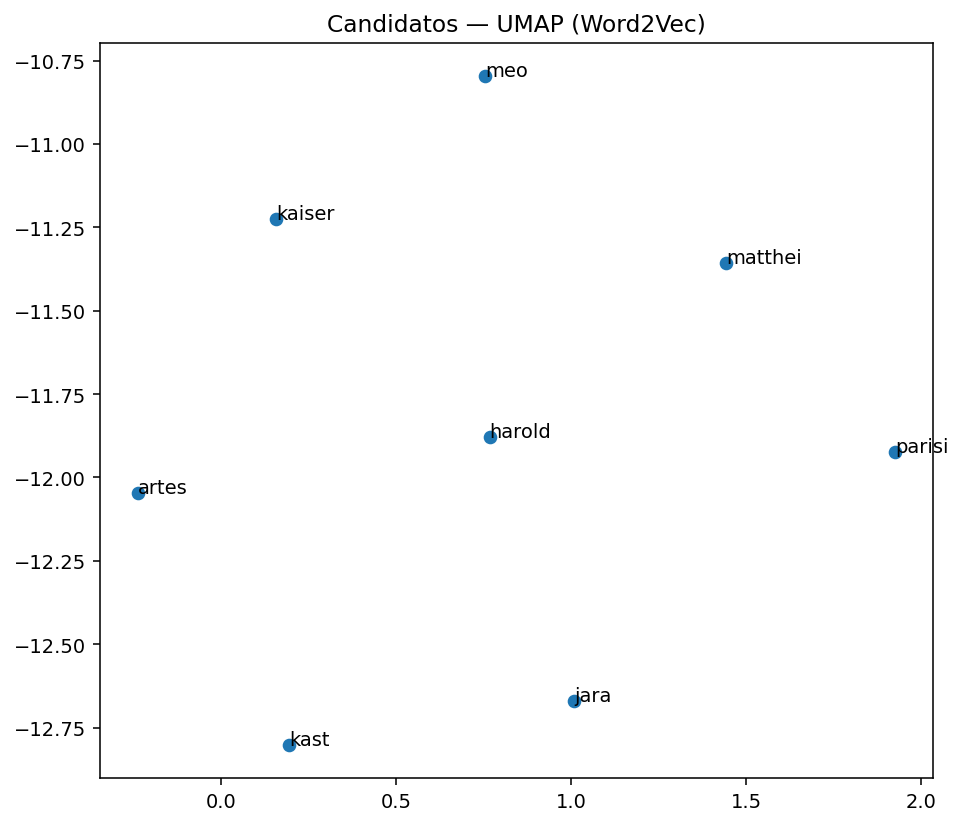

[M10] UMAP — términos por candidato (mapas locales)


[M10] terms UMAP:   0%|          | 0/8 [00:00<?, ?it/s]

C:\Users\Rodrigo\AppData\Roaming\Python\Python312\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


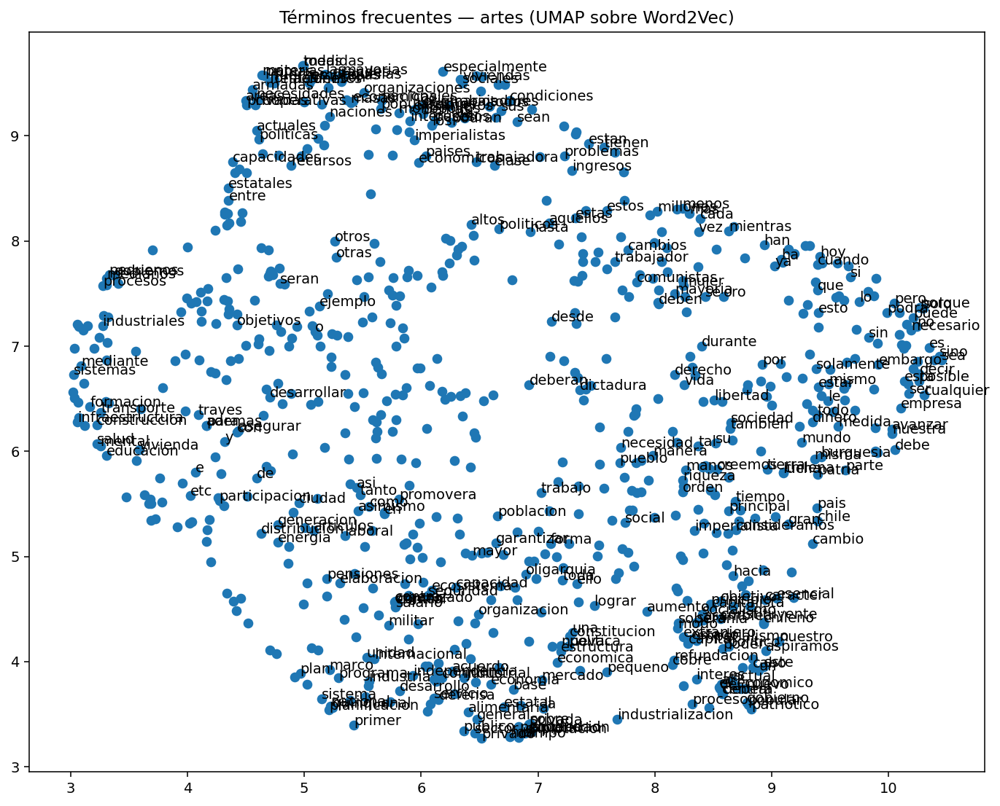

C:\Users\Rodrigo\AppData\Roaming\Python\Python312\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


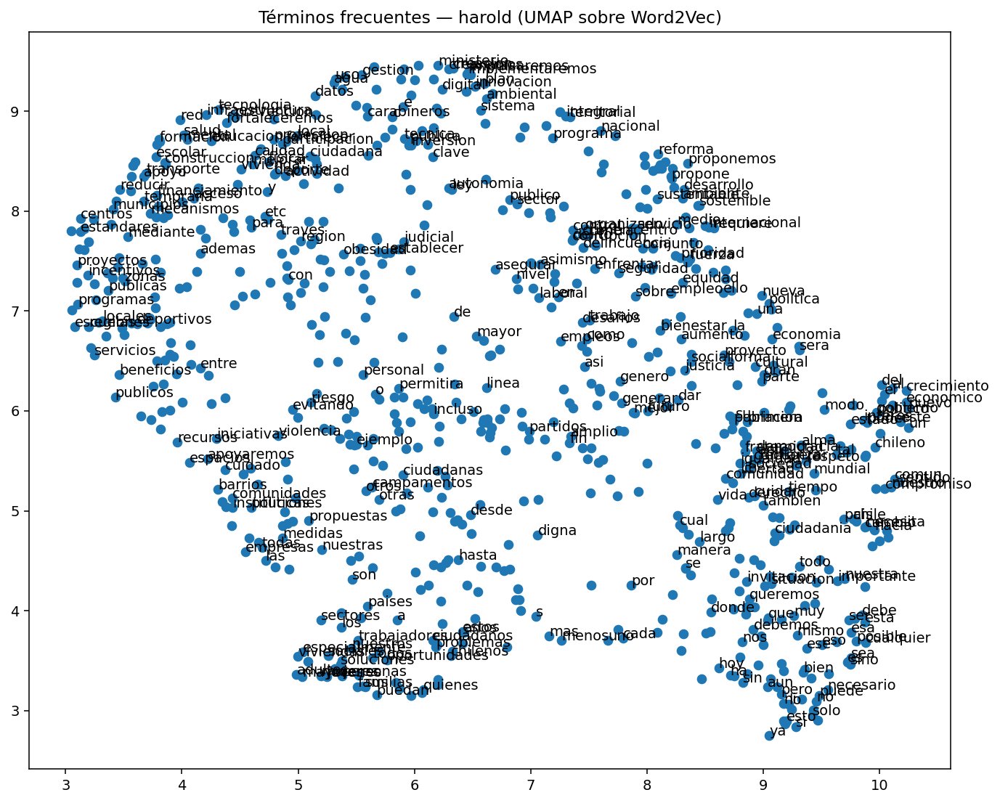

C:\Users\Rodrigo\AppData\Roaming\Python\Python312\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


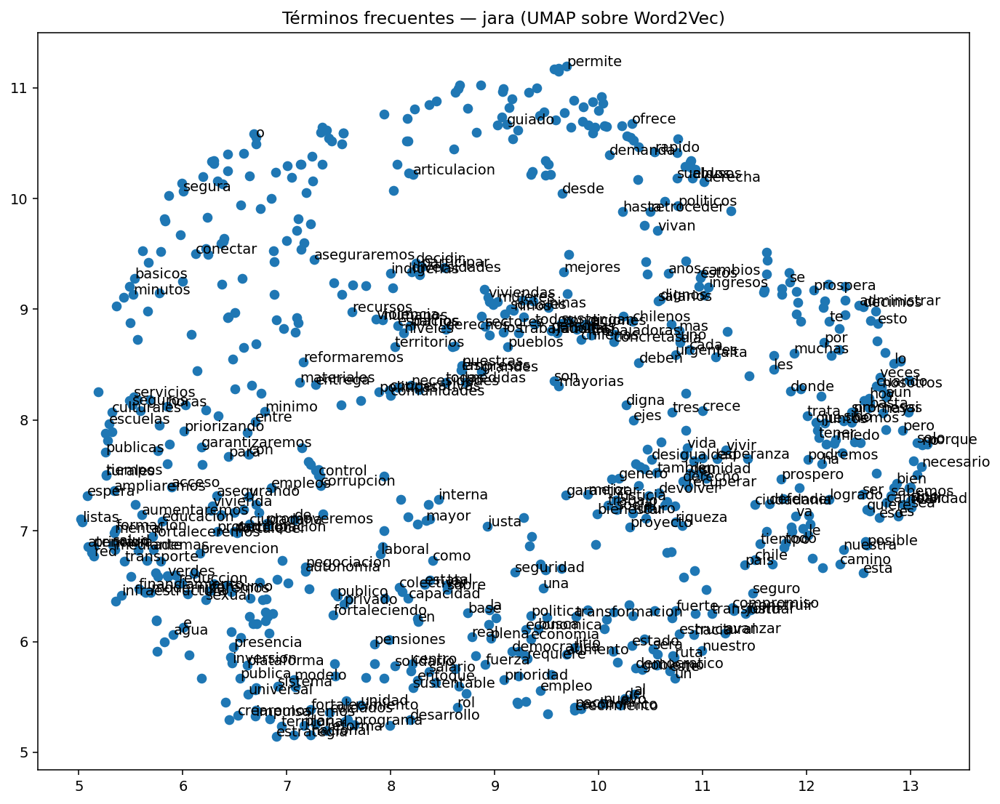

C:\Users\Rodrigo\AppData\Roaming\Python\Python312\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


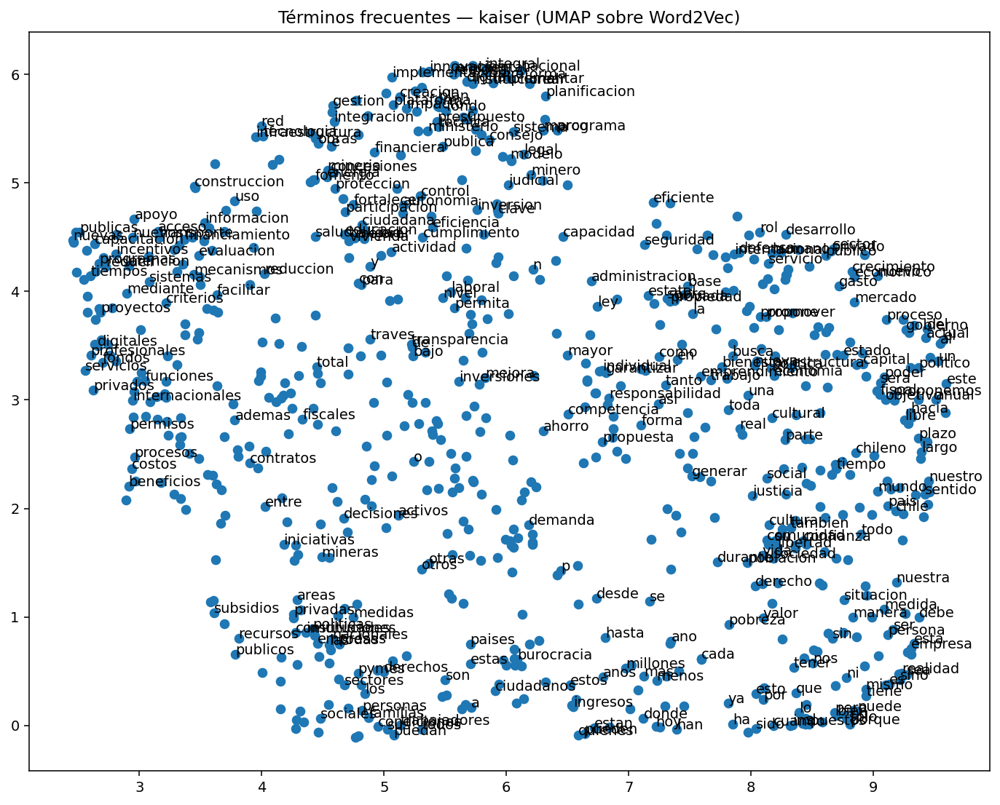

C:\Users\Rodrigo\AppData\Roaming\Python\Python312\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


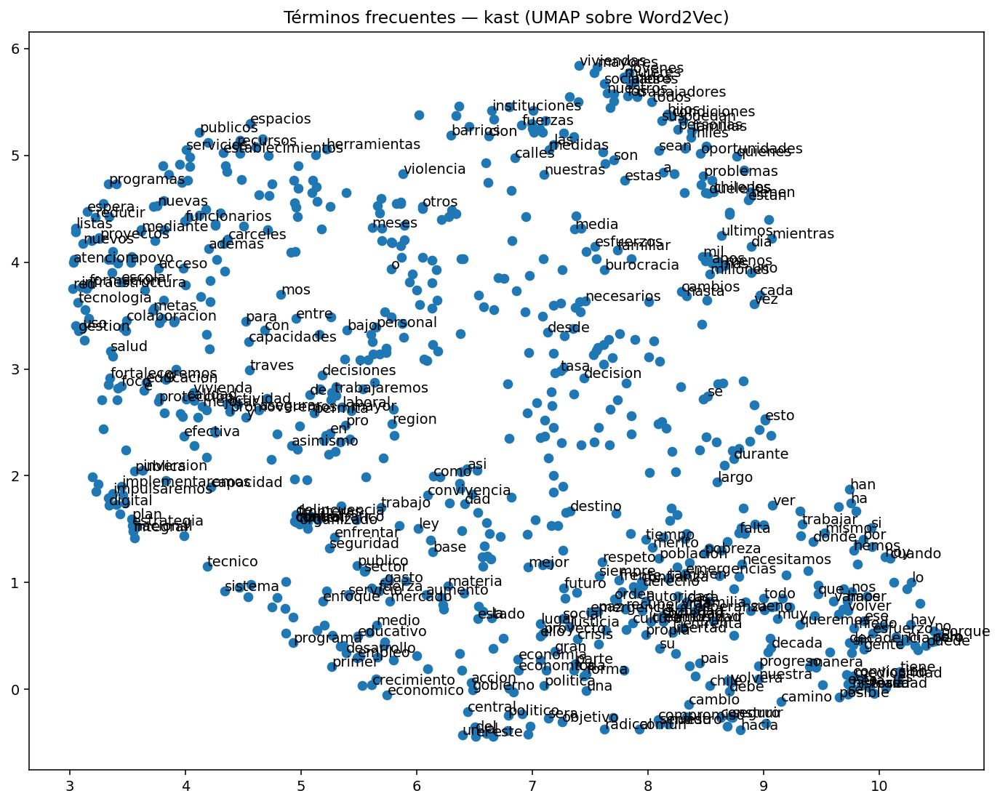

C:\Users\Rodrigo\AppData\Roaming\Python\Python312\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


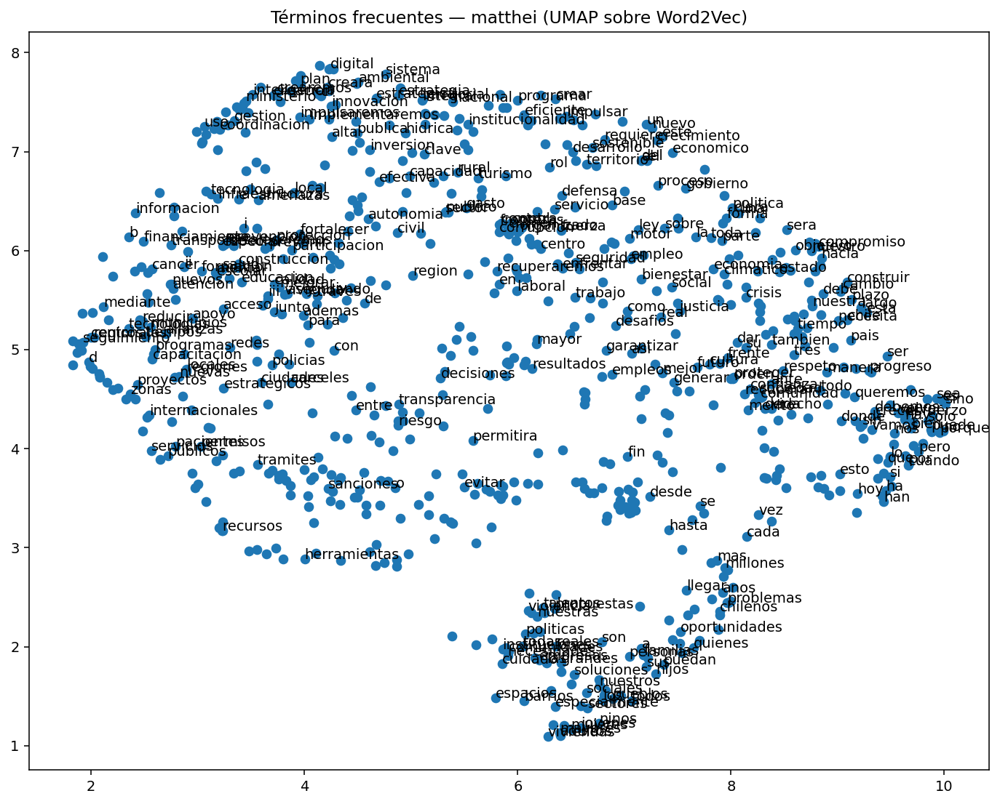

C:\Users\Rodrigo\AppData\Roaming\Python\Python312\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


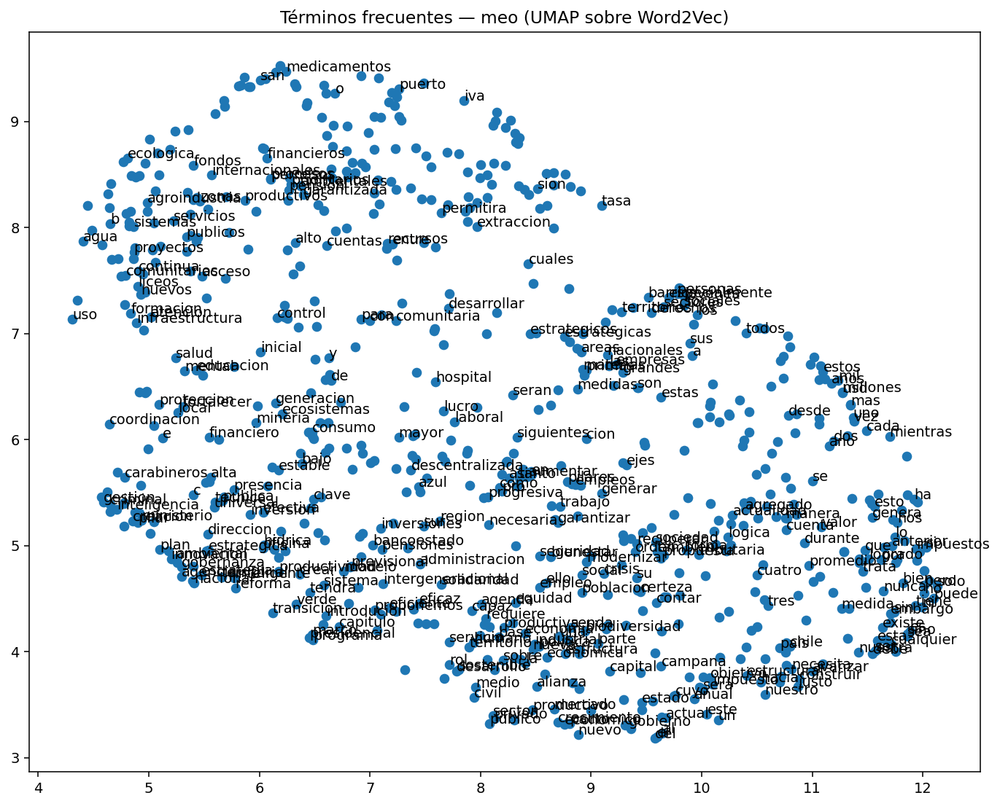

C:\Users\Rodrigo\AppData\Roaming\Python\Python312\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


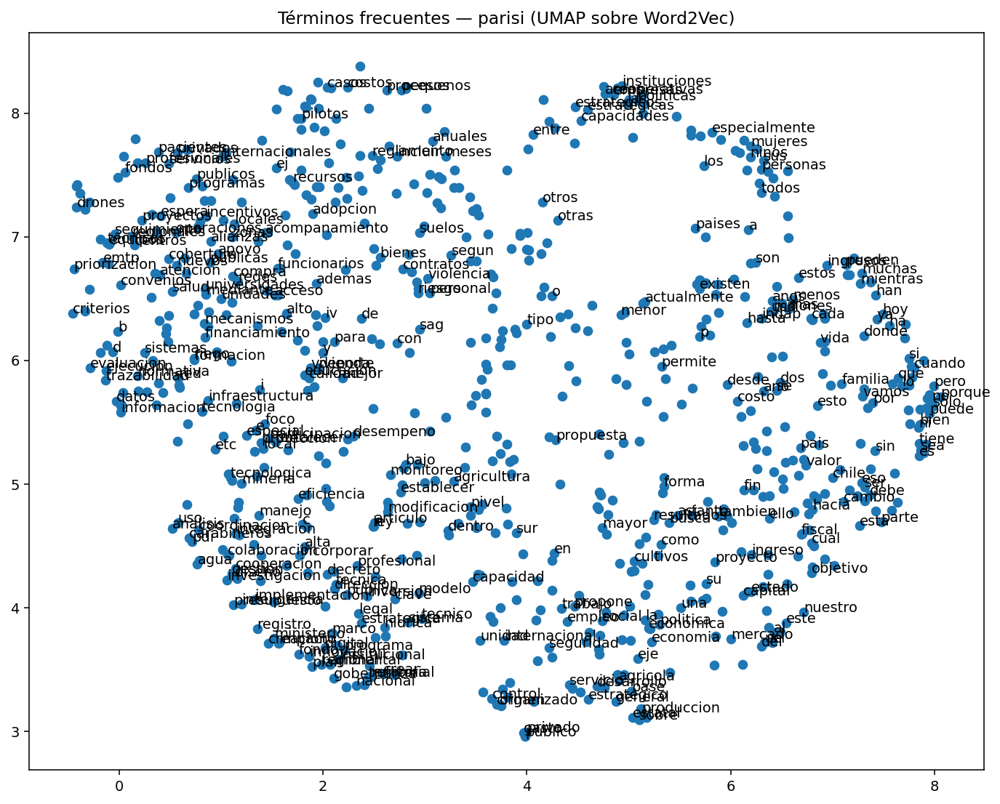

[M10] clusters de palabras por candidato (Word2Vec)


[M10] term clusters:   0%|          | 0/8 [00:00<?, ?it/s]

C:\Users\Rodrigo\AppData\Roaming\Python\Python312\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


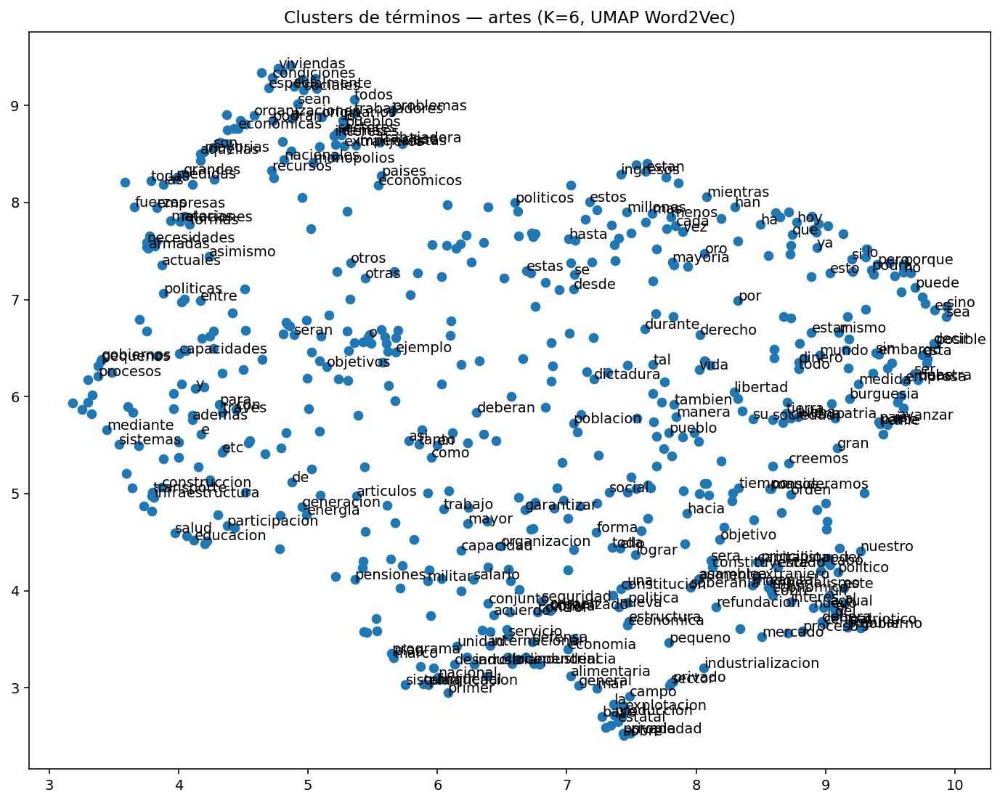

C:\Users\Rodrigo\AppData\Roaming\Python\Python312\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


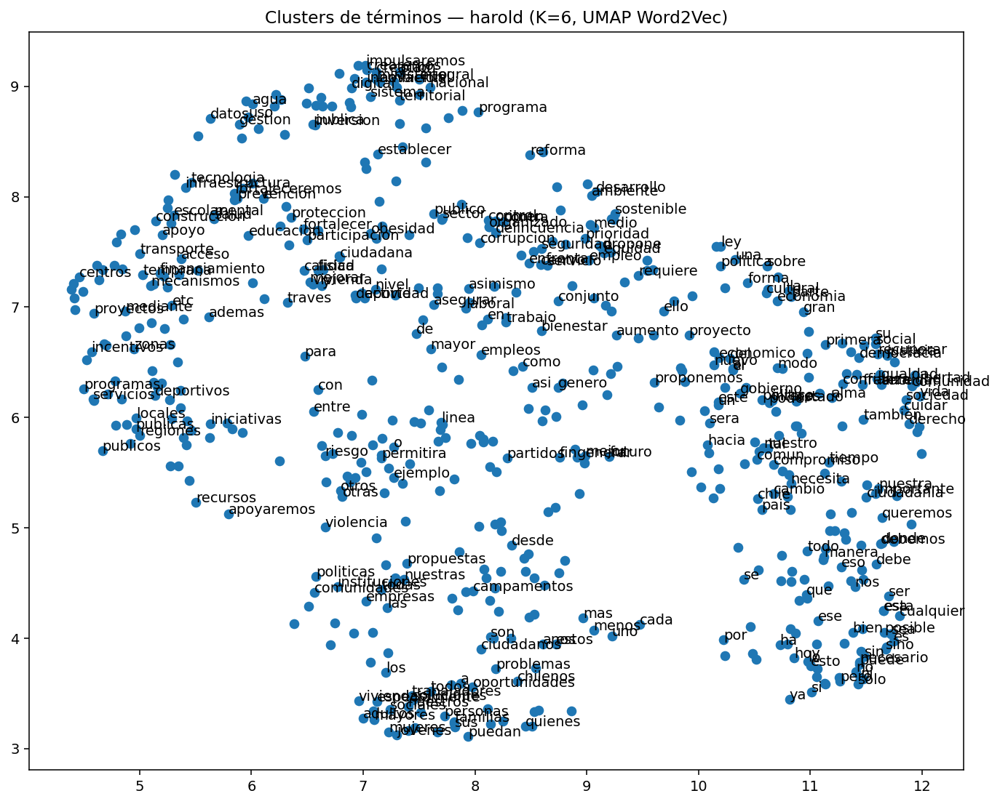

C:\Users\Rodrigo\AppData\Roaming\Python\Python312\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


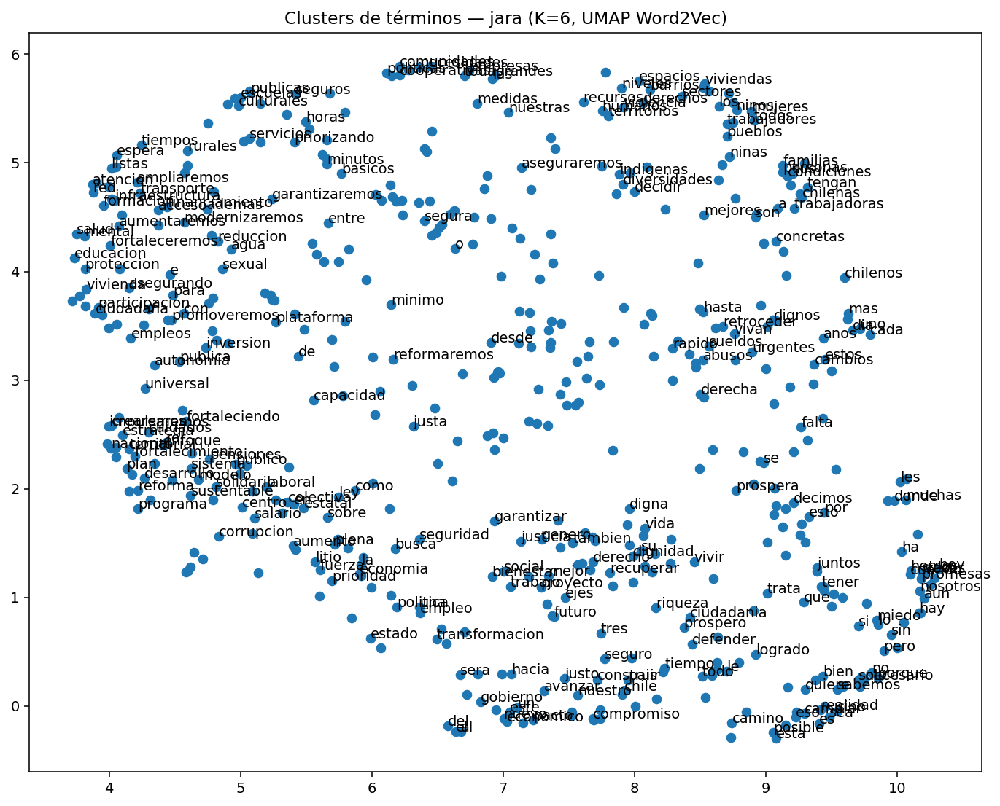

C:\Users\Rodrigo\AppData\Roaming\Python\Python312\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


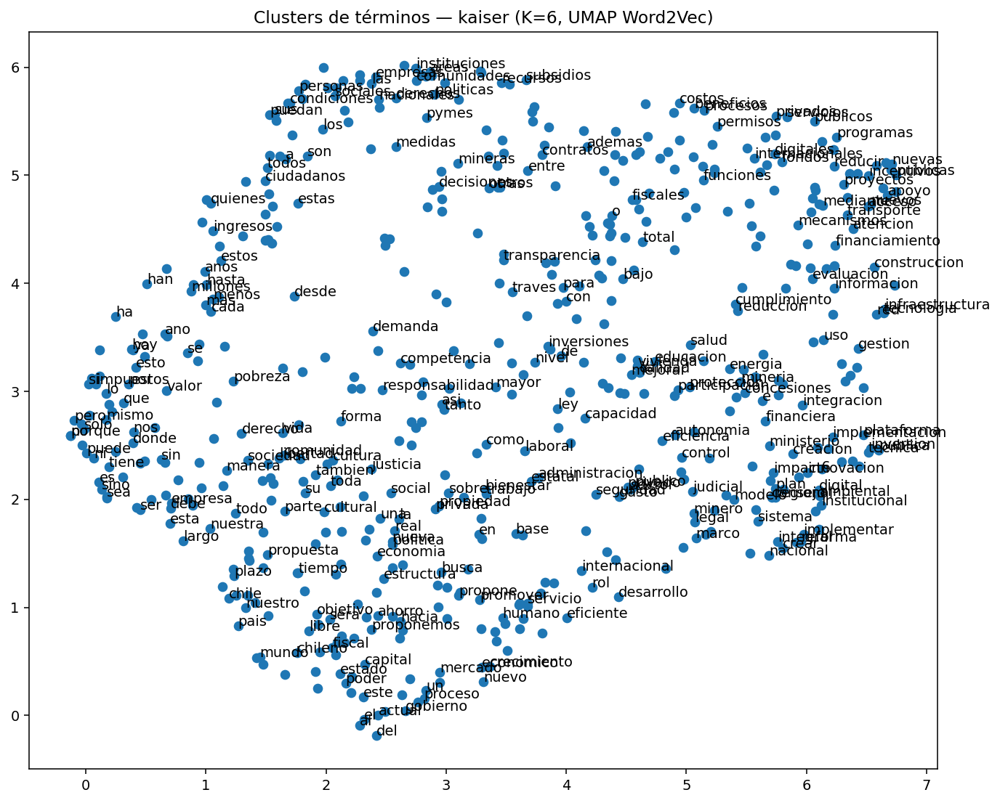

C:\Users\Rodrigo\AppData\Roaming\Python\Python312\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


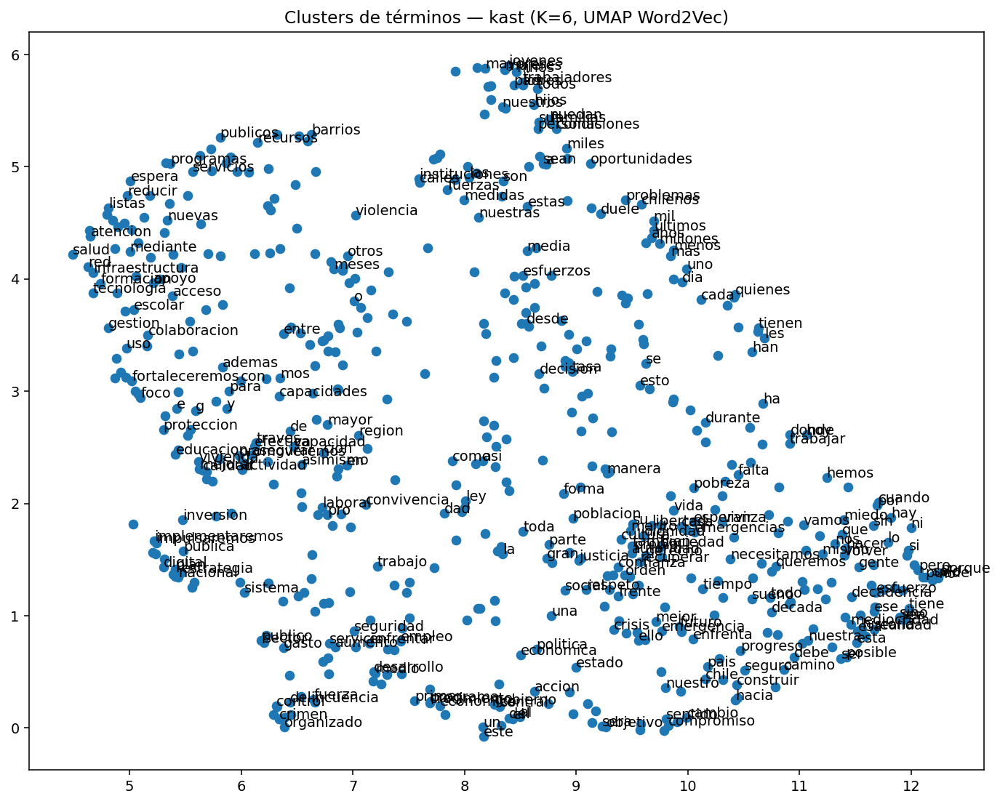

C:\Users\Rodrigo\AppData\Roaming\Python\Python312\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


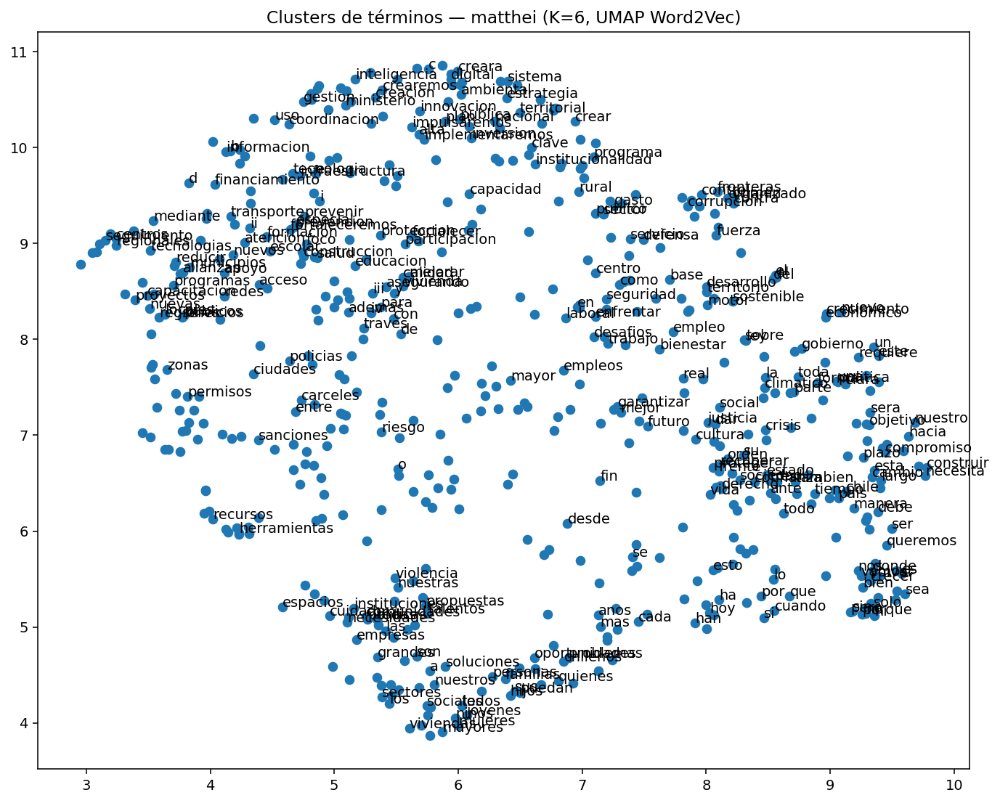

C:\Users\Rodrigo\AppData\Roaming\Python\Python312\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


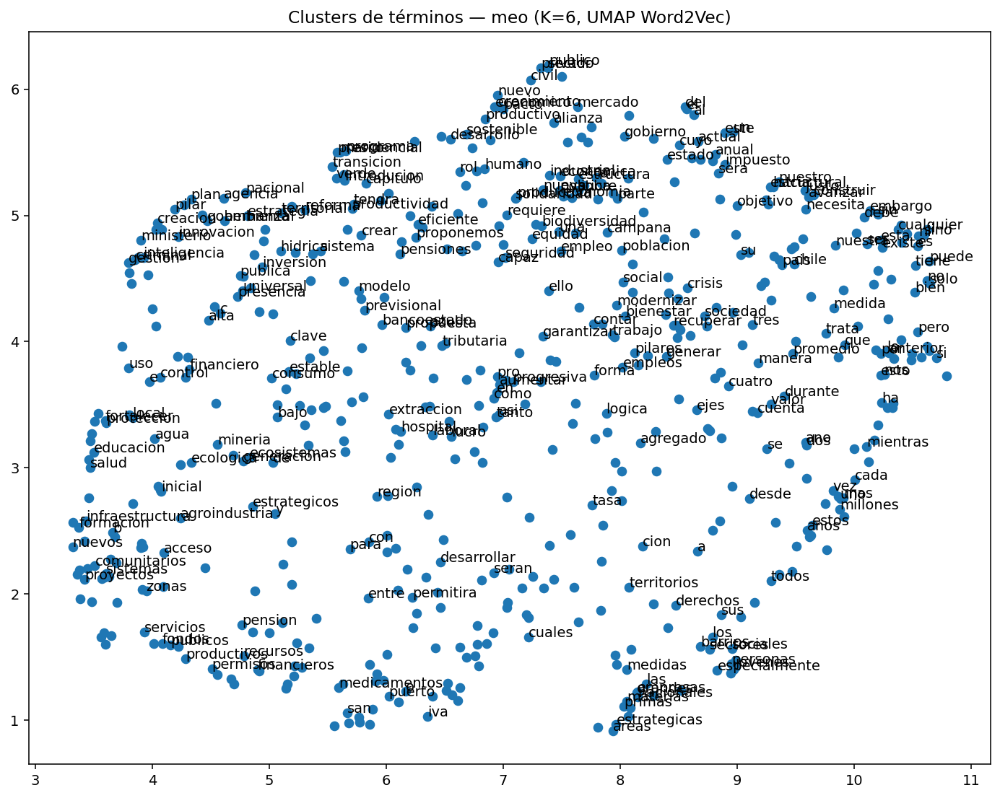

C:\Users\Rodrigo\AppData\Roaming\Python\Python312\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


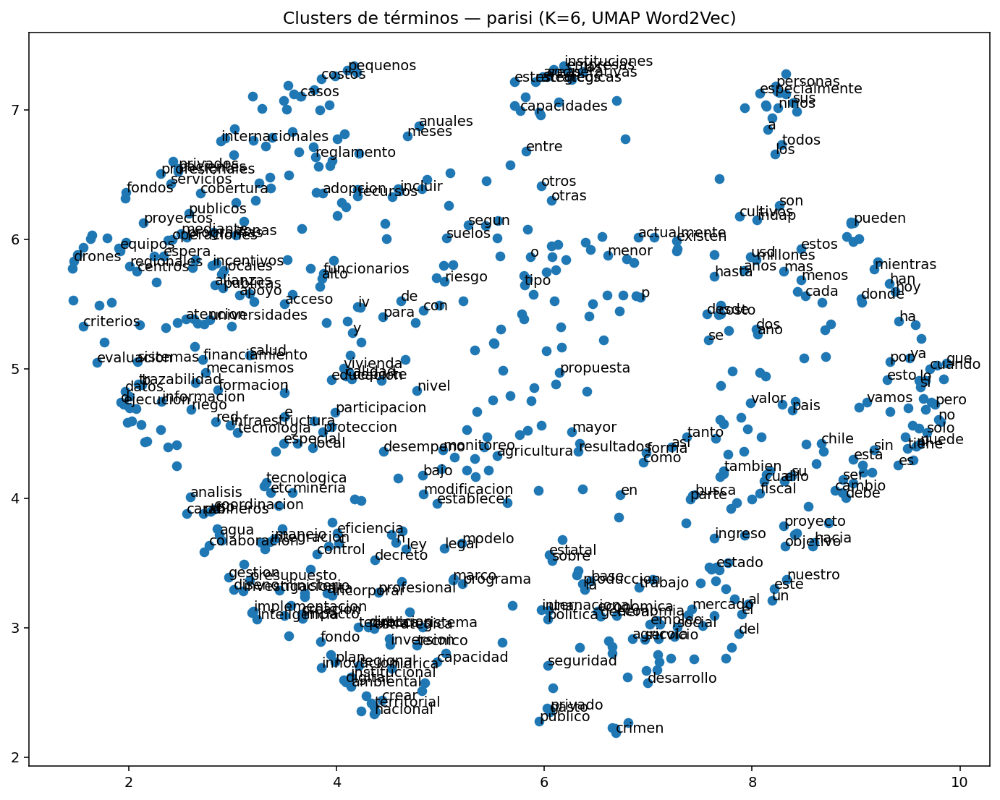

[M10] fin — outputs por candidato: candidate_embeddings.(parquet|csv), umap_terms_by_candidate/*.png, clusters_terms_by_candidate/*


In [3]:

import numpy as np, pandas as pd
from pathlib import Path
from tqdm.auto import tqdm
import matplotlib.pyplot as plt
from gensim.models import Word2Vec, FastText
from sklearn.metrics.pairwise import cosine_similarity
import umap
from collections import Counter

tqdm.write("[M10] inicio (por candidato)")

# ---------- entradas ----------
TOKENS = Path("tokens.parquet")
assert TOKENS.exists(), "Falta tokens.parquet (Fase 1)."
tokens = pd.read_parquet(TOKENS)

# ---------- parámetros ----------
EMB_DIM = 150
WINDOW  = 5
MIN_COUNT = 3
EPOCHS  = 10
RANDOM_STATE = 42
FIG_DPI = 140

# ---------- corpus por (candidate, filename) y por candidato ----------
def keep_token(w):
    if not isinstance(w,str) or not w: return False
    return bool(re.fullmatch(r"[A-Za-zÁÉÍÓÚÜÑáéíóúüñ<NUM>]+", w, flags=re.UNICODE))

# docs por programa (para entrenar con mayor variabilidad)
docs_prog = []
meta_prog = []
for (cand, fname), g in tqdm(tokens.groupby(["candidate","filename"], sort=False), desc="[M10] agrupar programas"):
    toks = [t for t in g["token_vn"] if keep_token(t)]
    if not toks: 
        continue
    docs_prog.append(toks)
    meta_prog.append({"candidate": cand, "filename": fname})
meta_prog = pd.DataFrame(meta_prog)

# docs por candidato (para visualizaciones y tablas per-candidate)
cand_docs = {cand: [t for t in g["token_vn"] if keep_token(t)]
             for cand, g in tqdm(tokens.groupby("candidate"), desc="[M10] agrupar candidatos")}

tqdm.write(f"[M10] docs_prog={len(docs_prog)} | candidatos={len(cand_docs)}")

# ---------- entrenar modelos ----------
tqdm.write("[M10] entrenando Word2Vec")
w2v = Word2Vec(
    sentences=docs_prog, vector_size=EMB_DIM, window=WINDOW, min_count=MIN_COUNT,
    workers=4, sg=1, epochs=EPOCHS, seed=RANDOM_STATE
)
w2v.save("w2v.model")

tqdm.write("[M10] entrenando FastText")
ft = FastText(
    sentences=docs_prog, vector_size=EMB_DIM, window=WINDOW, min_count=MIN_COUNT,
    workers=4, sg=1, epochs=EPOCHS, seed=RANDOM_STATE
)
ft.save("fasttext.model")

# ---------- embeddings por candidato (promedio de palabras de ese candidato) ----------
def doc_vector(model, tokens_list):
    vecs = [model.wv[t] for t in tokens_list if t in model.wv]
    if not vecs: return np.zeros(model.vector_size, dtype=np.float32)
    return np.mean(vecs, axis=0)

cand_emb_rows = []
for cand, toks in tqdm(cand_docs.items(), desc="[M10] emb por candidato"):
    v_w2v = doc_vector(w2v, toks)
    v_ft  = doc_vector(ft,  toks)
    cand_emb_rows.append({"candidate": cand, **{f"w2v_{i}":v for i,v in enumerate(v_w2v)},
                                       **{f"ft_{i}":v for i,v in enumerate(v_ft)}})
cand_emb = pd.DataFrame(cand_emb_rows).sort_values("candidate").reset_index(drop=True)
cand_emb.to_parquet("candidate_embeddings.parquet", index=False)
cand_emb.to_csv("candidate_embeddings.csv", index=False, encoding="utf-8-sig")

# ---------- similitud coseno entre candidatos (W2V y FastText) ----------
def cosim_matrix(M):
    return cosine_similarity(M)

W_mat = cand_emb[[c for c in cand_emb.columns if c.startswith("w2v_")]].to_numpy()
F_mat = cand_emb[[c for c in cand_emb.columns if c.startswith("ft_")]].to_numpy()
cands = cand_emb["candidate"].tolist()

pd.DataFrame(cosim_matrix(W_mat), index=cands, columns=cands).to_csv(
    "cosine_similarity_candidates_w2v.csv", encoding="utf-8-sig")
pd.DataFrame(cosim_matrix(F_mat), index=cands, columns=cands).to_csv(
    "cosine_similarity_candidates_fasttext.csv", encoding="utf-8-sig")

# ---------- UMAP de candidatos (Word2Vec por defecto) ----------
tqdm.write("[M10] UMAP — candidatos")
um = umap.UMAP(n_components=2, random_state=RANDOM_STATE, metric="cosine", n_neighbors=10, min_dist=0.1)
Zc = um.fit_transform(W_mat)

plt.figure(figsize=(7,6), dpi=FIG_DPI)
plt.scatter(Zc[:,0], Zc[:,1])
for i, cand in enumerate(cands):
    plt.text(Zc[i,0], Zc[i,1], cand)
plt.title("Candidatos — UMAP (Word2Vec)")
plt.tight_layout(); plt.savefig("umap_candidates_w2v.png", dpi=FIG_DPI, bbox_inches="tight"); plt.show()

# ---------- UMAP de términos por candidato (mapas locales) ----------
# para cada candidato: seleccionar sus términos más frecuentes presentes en el vocabulario w2v
tqdm.write("[M10] UMAP — términos por candidato (mapas locales)")
OUT_TERMS = Path("umap_terms_by_candidate"); OUT_TERMS.mkdir(exist_ok=True)
for cand, toks in tqdm(cand_docs.items(), desc="[M10] terms UMAP"):
    if not toks: 
        continue
    freq = Counter(toks)
    terms_sorted = [t for t,_ in freq.most_common(800) if t in w2v.wv]  # tope 800 por legibilidad
    if len(terms_sorted) < 30:
        continue
    V = np.vstack([w2v.wv[t] for t in terms_sorted])
    Zu = umap.UMAP(n_components=2, random_state=RANDOM_STATE, metric="cosine", n_neighbors=15, min_dist=0.1).fit_transform(V)
    plt.figure(figsize=(10,8), dpi=FIG_DPI)
    plt.scatter(Zu[:,0], Zu[:,1])
    # rotular los top 300 solamente
    max_labels = min(300, len(terms_sorted))
    for i in range(max_labels):
        plt.text(Zu[i,0], Zu[i,1], terms_sorted[i])
    plt.title(f"Términos frecuentes — {cand} (UMAP sobre Word2Vec)")
    plt.tight_layout(); plt.savefig(OUT_TERMS / f"umap_terms_{cand}.png", dpi=FIG_DPI, bbox_inches="tight"); plt.show()

# ---------- clusters de palabras por candidato (KMeans local sobre top términos) ----------
from sklearn.cluster import KMeans
tqdm.write("[M10] clusters de palabras por candidato (Word2Vec)")
OUT_CLUST = Path("clusters_terms_by_candidate"); OUT_CLUST.mkdir(exist_ok=True)

K_TERMS = 6  # número de clusters por candidato (ajustable)
for cand, toks in tqdm(cand_docs.items(), desc="[M10] term clusters"):
    if not toks: continue
    freq = Counter(toks)
    terms_sorted = [t for t,_ in freq.most_common(600) if t in w2v.wv]  # tope 600
    if len(terms_sorted) < K_TERMS:
        continue
    V = np.vstack([w2v.wv[t] for t in terms_sorted])
    # KMeans en el espacio original (también podrías usar UMAP->KMeans)
    km = KMeans(n_clusters=K_TERMS, random_state=RANDOM_STATE, n_init=10)
    labels = km.fit_predict(V)
    # guardar tabla por candidato
    pd.DataFrame({"term": terms_sorted, "cluster": labels}).to_csv(
        OUT_CLUST / f"term_clusters_{cand}.csv", index=False, encoding="utf-8-sig")
    # visual rápido con UMAP para ese candidato coloreando por cluster (sin estilos)
    Zu = umap.UMAP(n_components=2, random_state=RANDOM_STATE, metric="cosine", n_neighbors=15, min_dist=0.1).fit_transform(V)
    plt.figure(figsize=(10,8), dpi=FIG_DPI)
    plt.scatter(Zu[:,0], Zu[:,1])
    # rotulamos sólo 250 para legibilidad
    max_labels = min(250, len(terms_sorted))
    for i in range(max_labels):
        plt.text(Zu[i,0], Zu[i,1], terms_sorted[i])
    plt.title(f"Clusters de términos — {cand} (K={K_TERMS}, UMAP Word2Vec)")
    plt.tight_layout(); plt.savefig(OUT_CLUST / f"term_clusters_umap_{cand}.png", dpi=FIG_DPI, bbox_inches="tight"); plt.show()

tqdm.write("[M10] fin — outputs por candidato: candidate_embeddings.(parquet|csv), umap_terms_by_candidate/*.png, clusters_terms_by_candidate/*")


[M10-bis] inicio
[M10-bis] construyendo vocab por candidato


[M10-bis] agrupar:   0%|          | 0/8 [00:00<?, ?it/s]

[M10-bis] calculando distancias a centróide (coseno)


[M10-bis] candidatos:   0%|          | 0/8 [00:00<?, ?it/s]

C:\Users\Rodrigo\AppData\Roaming\Python\Python312\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


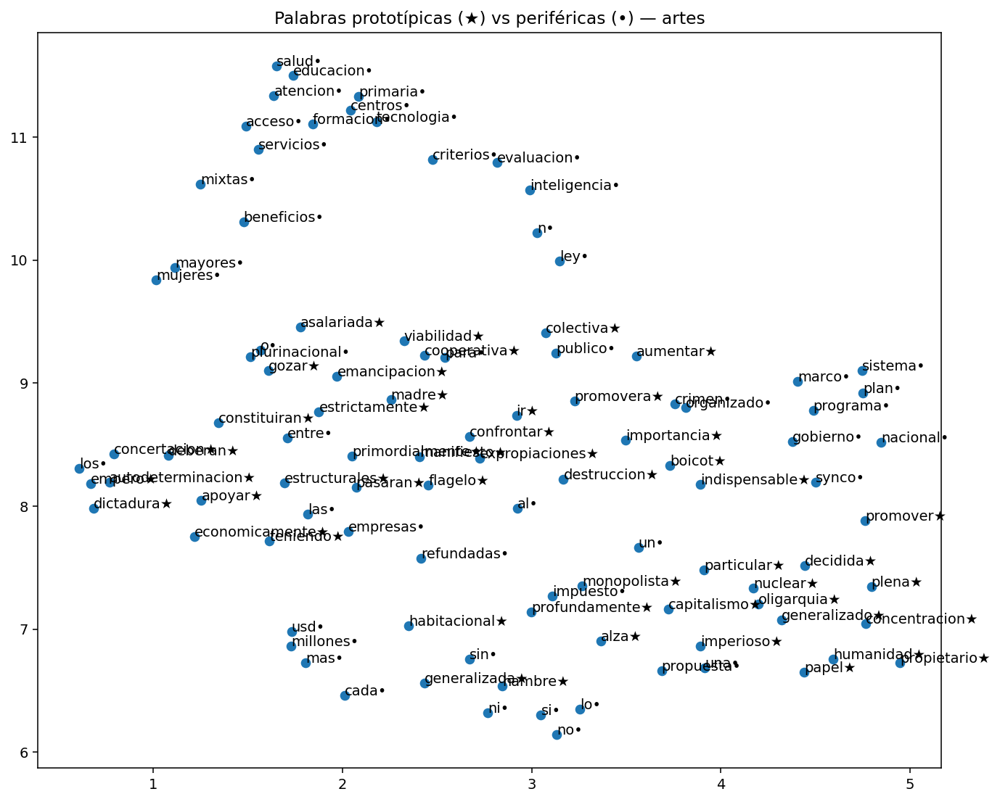

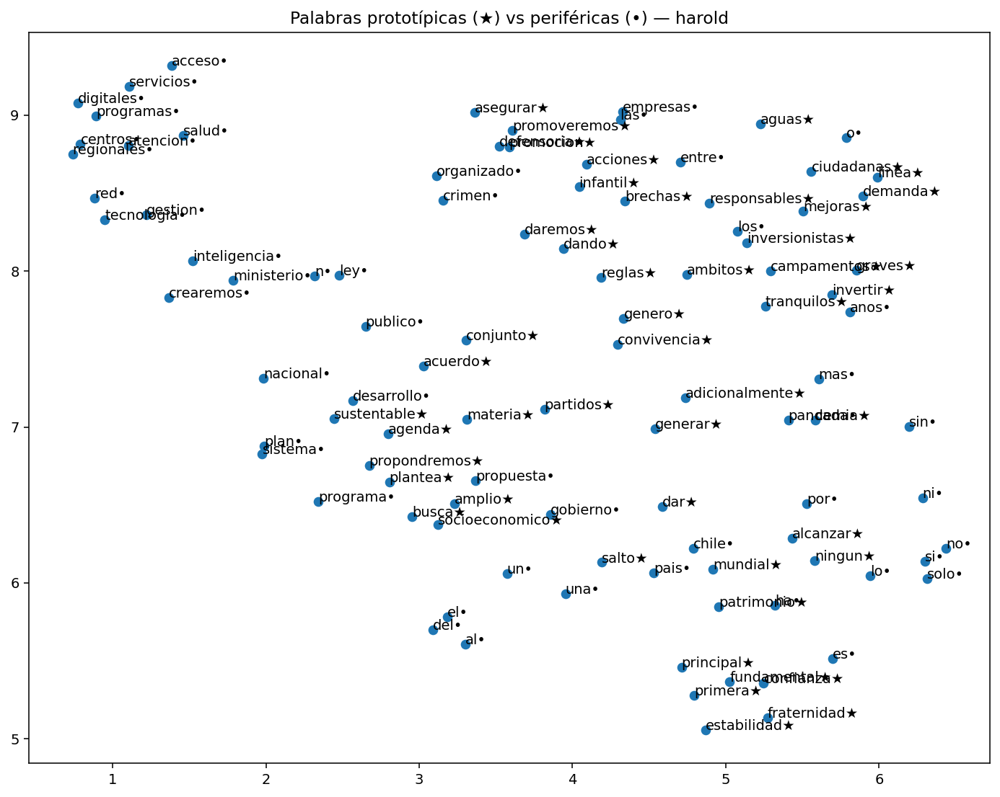

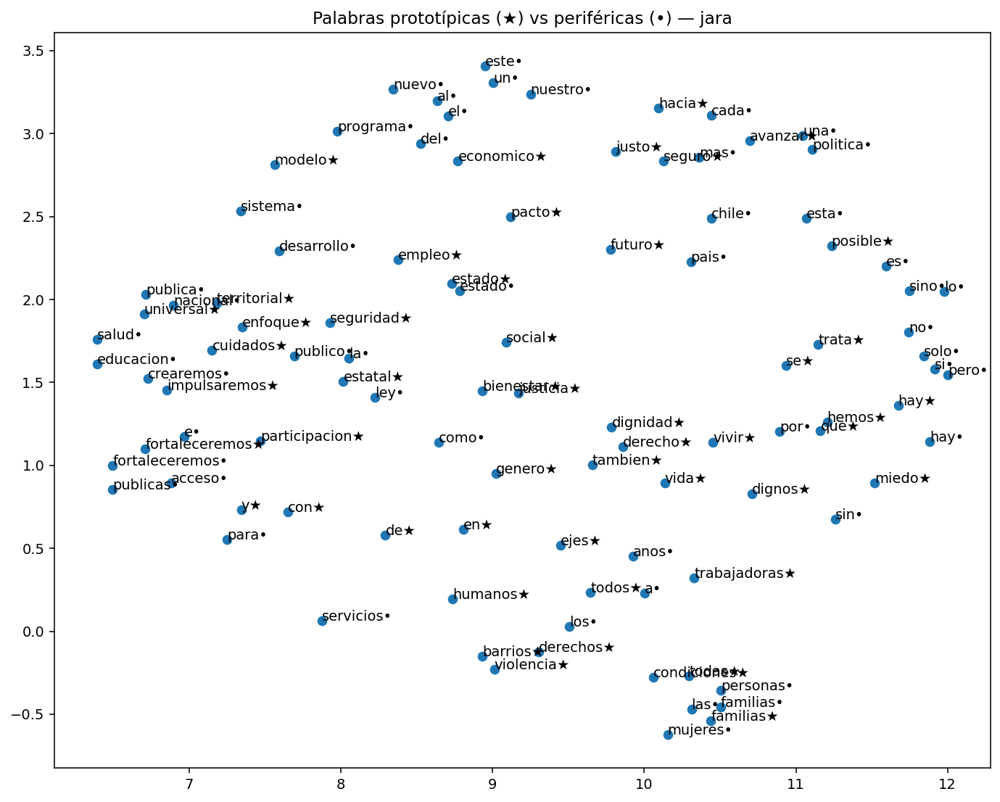

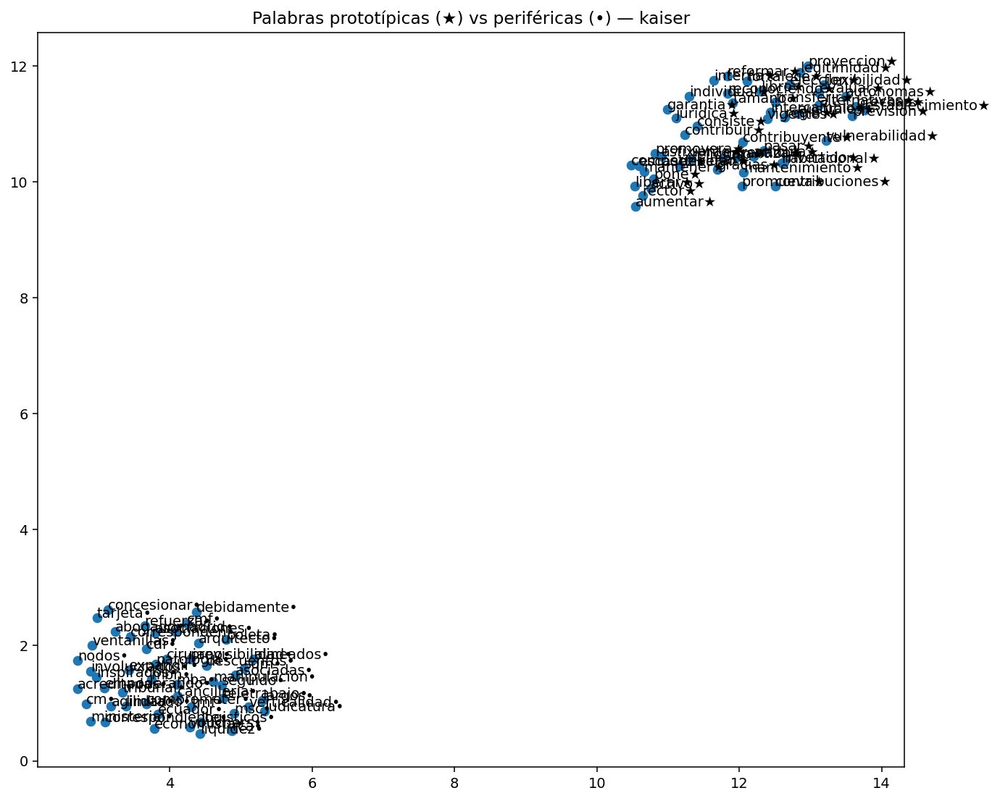

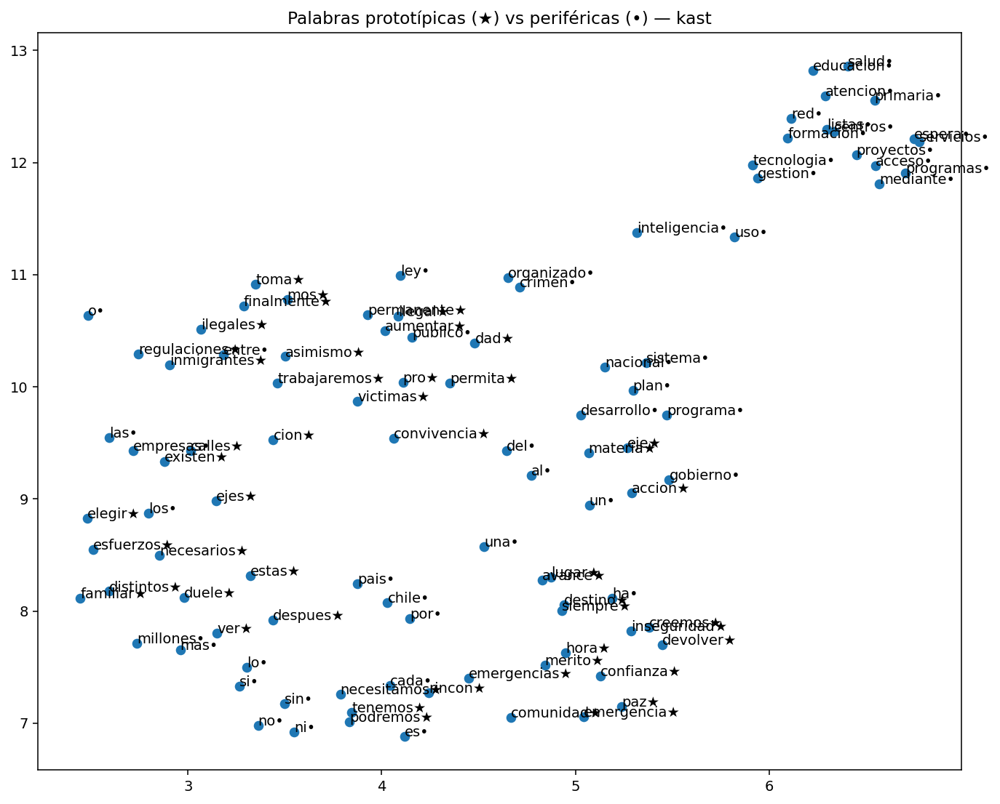

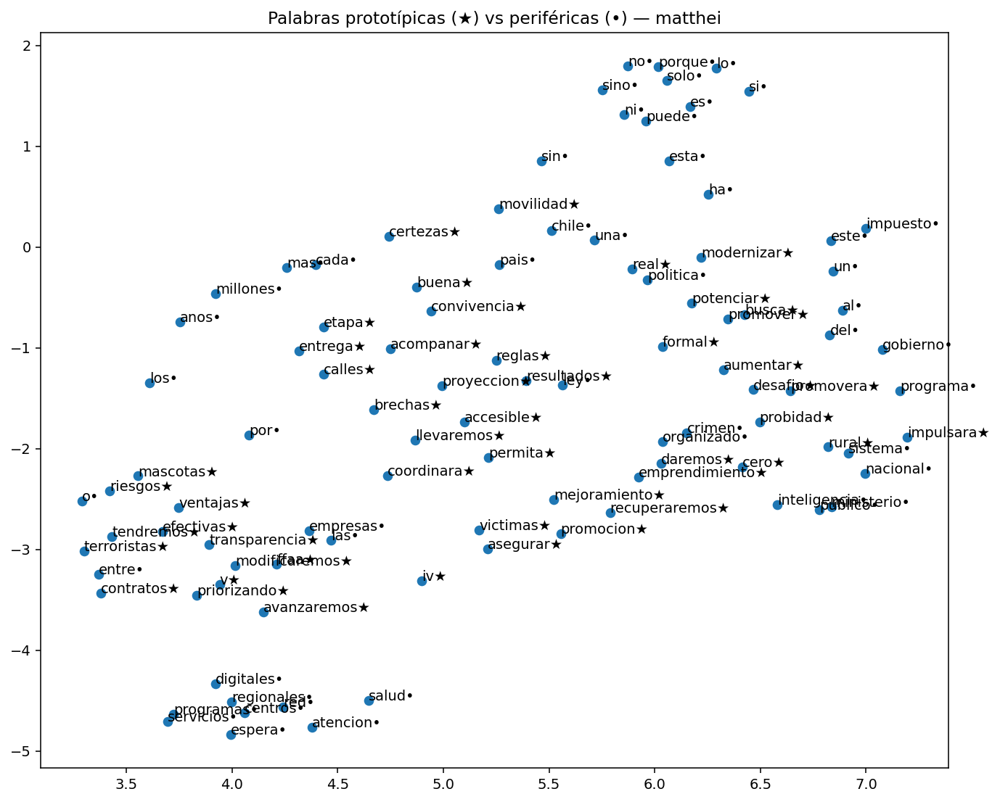

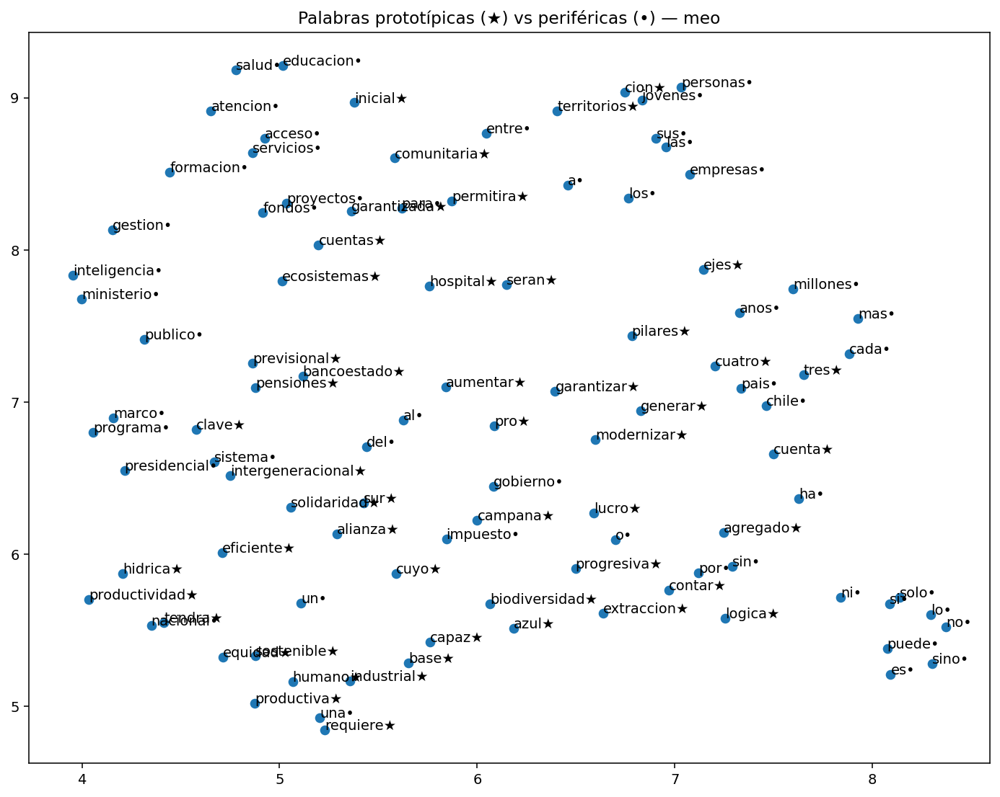

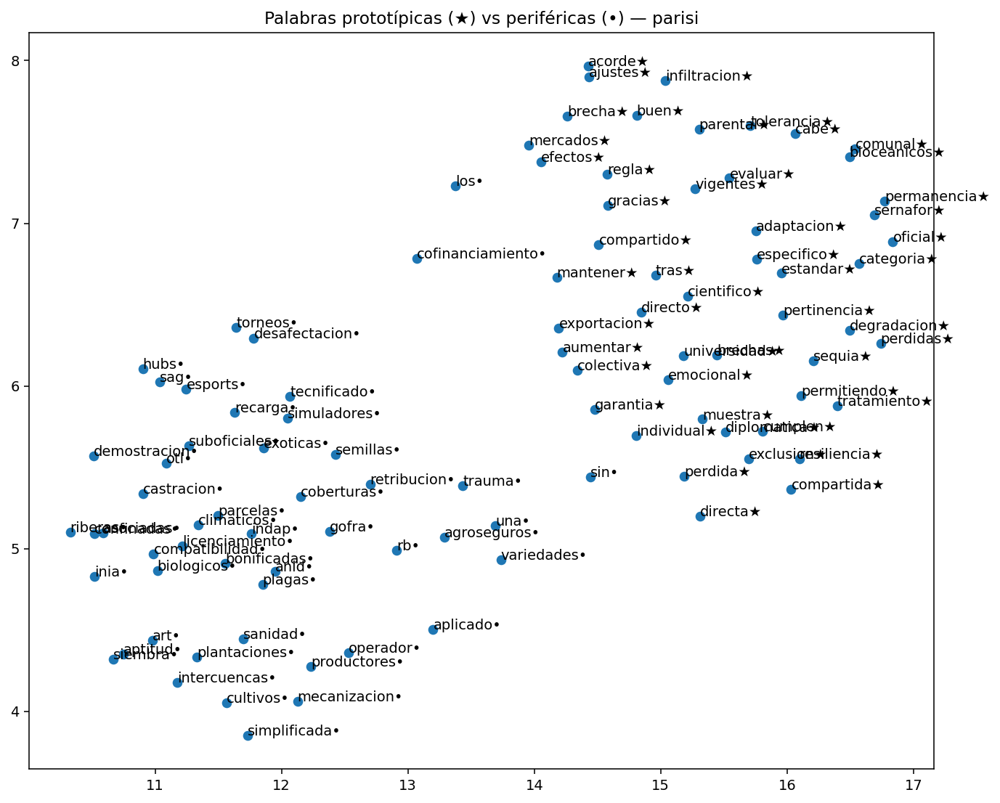

[M10-bis] fin — por candidato en ./proto_terms_by_candidate/<candidato>


In [4]:

import numpy as np, pandas as pd, math, re
from pathlib import Path
from tqdm.auto import tqdm
from collections import Counter
import matplotlib.pyplot as plt
from gensim.models import Word2Vec
import umap

tqdm.write("[M10-bis] inicio")

# -------- entradas requeridas --------
TOKENS = Path("tokens.parquet")       # de Fase 1
W2V_MDL = Path("w2v.model")           # entrenado en MÓDULO 10
assert TOKENS.exists(), "Falta tokens.parquet (ejecuta Fase 1)."
assert W2V_MDL.exists(), "Falta w2v.model (ejecuta MÓDULO 10)."

tokens = pd.read_parquet(TOKENS)
w2v = Word2Vec.load(str(W2V_MDL))

# -------- parámetros --------
MIN_FREQ_PER_CAND = 5        # frecuencia mínima por candidato para considerar el término
TOP_N = 50                   # tamaño de la tabla top prototípicas y periféricas
RANDOM_STATE = 42
FIG_DPI = 140

OUT_DIR = Path("proto_terms_by_candidate"); OUT_DIR.mkdir(exist_ok=True)

# -------- helpers --------
def keep_token(w):
    if not isinstance(w,str) or not w: return False
    return bool(re.fullmatch(r"[A-Za-zÁÉÍÓÚÜÑáéíóúüñ<NUM>]+", w, flags=re.UNICODE))

def centroid_weighted(model, terms, freqs):
    """Centróide ponderado por frecuencia en el espacio Word2Vec."""
    vecs = []
    ws   = []
    for t, f in zip(terms, freqs):
        if t in model.wv and f > 0:
            vecs.append(model.wv[t] * float(f))
            ws.append(float(f))
    if not vecs:
        return np.zeros(model.vector_size, dtype=np.float32)
    return np.sum(np.vstack(vecs), axis=0) / max(np.sum(ws), 1e-9)

def cos_sim(a, b):
    na = np.linalg.norm(a); nb = np.linalg.norm(b)
    if na == 0.0 or nb == 0.0: return 0.0
    return float(np.dot(a, b) / (na * nb))

# -------- construir vocabulario por candidato --------
tqdm.write("[M10-bis] construyendo vocab por candidato")
cand_vocab = {}
for cand, g in tqdm(tokens.groupby("candidate"), desc="[M10-bis] agrupar"):
    toks = [t for t in g["token_vn"] if keep_token(t)]
    cnt = Counter(toks)
    # quedarnos con términos que estén en el vocabulario del modelo y cumplan min_freq
    terms = [t for t, f in cnt.items() if f >= MIN_FREQ_PER_CAND and t in w2v.wv]
    freqs = [cnt[t] for t in terms]
    cand_vocab[cand] = (terms, freqs)

# -------- scoring por candidato --------
tqdm.write("[M10-bis] calculando distancias a centróide (coseno)")
um_global = umap.UMAP(n_components=2, random_state=RANDOM_STATE, metric="cosine", n_neighbors=15, min_dist=0.1)

for cand, (terms, freqs) in tqdm(cand_vocab.items(), desc="[M10-bis] candidatos"):
    if not terms:
        continue

    # centróide ponderado
    C = centroid_weighted(w2v, terms, freqs)

    # similitud/distancia por término
    sims = []
    for t in terms:
        v = w2v.wv[t]
        s = cos_sim(v, C)
        sims.append(s)
    sims = np.array(sims)
    dists = 1.0 - sims  # distancia coseno

    df = pd.DataFrame({"term": terms, "freq": freqs, "cos_sim": sims, "cos_dist": dists})
    df = df.sort_values(["cos_sim","freq"], ascending=[False, False]).reset_index(drop=True)

    # prototípicas (más cercanas) y periféricas (más lejanas)
    prot = df.nlargest(TOP_N, ["cos_sim","freq"]).copy()
    prot["rank_proto"] = np.arange(1, len(prot)+1)
    peri = df.nsmallest(TOP_N, ["cos_sim","freq"]).copy()
    peri = peri.sort_values(["cos_sim","freq"], ascending=[True, False]).reset_index(drop=True)
    peri["rank_peri"] = np.arange(1, len(peri)+1)

    # guardar tablas por candidato
    out_cand = OUT_DIR / cand; out_cand.mkdir(exist_ok=True)
    prot.to_csv(out_cand / f"prototype_terms_{cand}.csv", index=False, encoding="utf-8-sig")
    peri.to_csv(out_cand / f"peripheral_terms_{cand}.csv", index=False, encoding="utf-8-sig")

    # ------- UMAP local: unión de prot+peri (hasta 2*TOP_N) -------
    union_terms = prot["term"].tolist() + peri["term"].tolist()
    V = np.vstack([w2v.wv[t] for t in union_terms])
    Z = um_global.fit_transform(V)

    plt.figure(figsize=(10,8), dpi=FIG_DPI)
    plt.scatter(Z[:,0], Z[:,1])
    # rotular: prototípicas primero con un sufijo "★", periféricas con "•"
    for i, t in enumerate(union_terms[:len(prot)]):
        plt.text(Z[i,0], Z[i,1], f"{t}★")   # prototípicas
    for j, t in enumerate(union_terms[len(prot):], start=len(prot)):
        plt.text(Z[j,0], Z[j,1], f"{t}•")   # periféricas
    plt.title(f"Palabras prototípicas (★) vs periféricas (•) — {cand}")
    plt.tight_layout()
    plt.savefig(out_cand / f"umap_proto_peri_{cand}.png", dpi=FIG_DPI, bbox_inches="tight")
    plt.show()
    plt.close()

tqdm.write("[M10-bis] fin — por candidato en ./proto_terms_by_candidate/<candidato>")


In [5]:
# %% MÓDULO 11 — BERT embeddings por párrafo, documento y candidato
!pip -q install sentence-transformers tqdm hdbscan scikit-learn

import numpy as np, pandas as pd, re
from pathlib import Path
from tqdm.auto import tqdm
import matplotlib.pyplot as plt
from sentence_transformers import SentenceTransformer

tqdm.write("[M11] inicio")

# -------- entradas --------
DOCS_NORM = Path("documents_norm.parquet")   # candidate, filename, text_vl, text_vn
SENTS      = Path("sents.parquet")           # candidate, filename, page, sent_id, sent_text
assert DOCS_NORM.exists() and SENTS.exists(), "Faltan documents_norm.parquet o sents.parquet"

docs = pd.read_parquet(DOCS_NORM)
sents = pd.read_parquet(SENTS)

# -------- parámetros --------
MODEL_NAME   = "sentence-transformers/paraphrase-multilingual-MiniLM-L12-v2"  # (opcional) BETO: "hiiamsid/sentence_similarity_spanish_es"
PARA_MAX_TOK = 120      # aprox. nº de tokens por párrafo (reconstruido desde oraciones)
FIG_DPI      = 140
OUT_EMB      = Path("bert_outputs"); OUT_EMB.mkdir(exist_ok=True)

# -------- utilidades --------
def chunk_by_sentences(group, max_tokens=PARA_MAX_TOK):
    """Agrupa oraciones en 'párrafos' de tamaño razonable (tokens ~ palabras separadas por espacios)."""
    paras = []
    buf, count = [], 0
    for txt in group["sent_text"].tolist():
        n = len(txt.split())
        if count + n > max_tokens and buf:
            paras.append(" ".join(buf).strip())
            buf, count = [], 0
        buf.append(txt)
        count += n
    if buf:
        paras.append(" ".join(buf).strip())
    # filtra párrafos demasiado cortos
    paras = [p for p in paras if len(p.split()) >= 8]
    return paras

# -------- 11.1 construir párrafos por documento --------
tqdm.write("[M11] construyendo párrafos por (candidate, filename)")
para_rows = []
for (cand, fname), g in tqdm(sents.groupby(["candidate","filename"], sort=False), desc="[M11] párrafos/doc"):
    g = g.sort_values(["page","sent_id"])
    paras = chunk_by_sentences(g, max_tokens=PARA_MAX_TOK)
    for i, p in enumerate(paras, start=1):
        para_rows.append({"candidate":cand, "filename":fname, "para_id":i, "text":p})
paras_df = pd.DataFrame(para_rows)
paras_df.to_parquet(OUT_EMB / "bert_paragraphs.parquet", index=False)
tqdm.write(f"[M11] párrafos construidos: {len(paras_df)}")

# -------- 11.2 cargar modelo y codificar --------
tqdm.write(f"[M11] cargando modelo: {MODEL_NAME}")
model = SentenceTransformer(MODEL_NAME)

def encode_texts(texts, batch_size=64):
    embs = model.encode(texts, batch_size=batch_size, show_progress_bar=True, normalize_embeddings=True)
    return np.array(embs, dtype=np.float32)

# embeddings de párrafo
tqdm.write("[M11] emb. de párrafo")
Z_para = encode_texts(paras_df["text"].tolist(), batch_size=64)
np.save(OUT_EMB / "emb_paragraphs.npy", Z_para)

# -------- 11.3 promedios por documento y por candidato --------
tqdm.write("[M11] emb. por documento (promedio de párrafos)")
doc_key = paras_df[["candidate","filename"]].astype(str).agg("||".join, axis=1)
docs_index = pd.factorize(doc_key)[0]
doc_vecs = []
meta_docs = []
for i, key in enumerate(np.unique(doc_key)):
    idx = np.where(doc_key.values == key)[0]
    v = Z_para[idx].mean(axis=0) if len(idx) else np.zeros(Z_para.shape[1], dtype=np.float32)
    cand, fname = key.split("||", 1)
    doc_vecs.append(v); meta_docs.append({"candidate":cand, "filename":fname})
E_docs = np.vstack(doc_vecs)
meta_docs = pd.DataFrame(meta_docs)
np.save(OUT_EMB / "emb_documents.npy", E_docs)
meta_docs.to_csv(OUT_EMB / "emb_documents_meta.csv", index=False, encoding="utf-8-sig")

tqdm.write("[M11] emb. por candidato (promedio de documentos)")
cand_rows = []
for cand, g in meta_docs.groupby("candidate"):
    idx = g.index.to_numpy()
    v = E_docs[idx].mean(axis=0)
    cand_rows.append({"candidate":cand, **{f"dim_{i}":float(v[i]) for i in range(v.shape[0])}})
cand_emb = pd.DataFrame(cand_rows).sort_values("candidate").reset_index(drop=True)
cand_emb.to_parquet(OUT_EMB / "emb_candidate_mean.parquet", index=False)
cand_emb.to_csv(OUT_EMB / "emb_candidate_mean.csv", index=False, encoding="utf-8-sig")

tqdm.write("[M11] fin — guardados: emb_paragraphs.npy, emb_documents.npy, emb_candidate_mean.(parquet/csv)")



[notice] A new release of pip is available: 24.1.2 -> 25.3
[notice] To update, run: python.exe -m pip install --upgrade pip



[M11] inicio
[M11] construyendo párrafos por (candidate, filename)


[M11] párrafos/doc:   0%|          | 0/8 [00:00<?, ?it/s]

[M11] párrafos construidos: 2086
[M11] cargando modelo: sentence-transformers/paraphrase-multilingual-MiniLM-L12-v2


modules.json:   0%|          | 0.00/229 [00:00<?, ?B/s]

C:\Users\Rodrigo\AppData\Roaming\Python\Python312\site-packages\huggingface_hub\file_download.py:139: UserWarning: `huggingface_hub` cache-system uses symlinks by default to efficiently store duplicated files but your machine does not support them in C:\Users\Rodrigo\.cache\huggingface\hub\models--sentence-transformers--paraphrase-multilingual-MiniLM-L12-v2. Caching files will still work but in a degraded version that might require more space on your disk. This warning can be disabled by setting the `HF_HUB_DISABLE_SYMLINKS_WARNING` environment variable. For more details, see https://huggingface.co/docs/huggingface_hub/how-to-cache#limitations.
To support symlinks on Windows, you either need to activate Developer Mode or to run Python as an administrator. In order to activate developer mode, see this article: https://docs.microsoft.com/en-us/windows/apps/get-started/enable-your-device-for-development
  warnings.warn(message)


config_sentence_transformers.json:   0%|          | 0.00/122 [00:00<?, ?B/s]

README.md: 0.00B [00:00, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/645 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/471M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/480 [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/9.08M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/239 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

[M11] emb. de párrafo


Batches:   0%|          | 0/33 [00:00<?, ?it/s]

[M11] emb. por documento (promedio de párrafos)
[M11] emb. por candidato (promedio de documentos)
[M11] fin — guardados: emb_paragraphs.npy, emb_documents.npy, emb_candidate_mean.(parquet/csv)


In [1]:
# %% MÓDULO 12 — HDBSCAN sobre embeddings BERT + comparación con LDA
!pip -q install hdbscan scikit-learn tqdm

import numpy as np, pandas as pd
from pathlib import Path
from tqdm.auto import tqdm
import matplotlib.pyplot as plt
import hdbscan
from sklearn.metrics import silhouette_score, adjusted_rand_score, normalized_mutual_info_score

tqdm.write("[M12] inicio")

# -------- entradas --------
OUT_EMB = Path("bert_outputs")
E_DOCS = OUT_EMB / "emb_documents.npy"
META_DOCS = OUT_EMB / "emb_documents_meta.csv"
LDA_DOM  = Path("lda_doc_dominant.parquet")   # de Fase 2 M7
assert E_DOCS.exists() and META_DOCS.exists(), "Faltan emb_documents.npy y/o emb_documents_meta.csv"
E = np.load(E_DOCS)
meta = pd.read_csv(META_DOCS)
lda_dom = pd.read_parquet(LDA_DOM) if LDA_DOM.exists() else None

# -------- parámetros HDBSCAN --------
MIN_CLUSTER_SIZE = 5
MIN_SAMPLES      = 5
METRIC           = "euclidean"   # embeddings normalizados también admiten "cosine"
FIG_DPI          = 140
OUT_CLUST        = Path("bert_hdbscan"); OUT_CLUST.mkdir(exist_ok=True)

# -------- 12.1 HDBSCAN global a nivel documento --------
tqdm.write("[M12] HDBSCAN global (document embeddings)")
clusterer = hdbscan.HDBSCAN(min_cluster_size=MIN_CLUSTER_SIZE, min_samples=MIN_SAMPLES,
                            metric=METRIC, cluster_selection_epsilon=0.0)
labels = clusterer.fit_predict(E)   # -1 = ruido
meta["cluster_hdb"] = labels
meta.to_csv(OUT_CLUST / "doc_clusters_hdbscan.csv", index=False, encoding="utf-8-sig")

# Silhouette (excluye ruido)
mask = labels >= 0
sil = float(silhouette_score(E[mask], labels[mask])) if mask.any() and len(np.unique(labels[mask]))>1 else np.nan
with open(OUT_CLUST / "hdbscan_silhouette.txt","w",encoding="utf-8") as f:
    f.write(f"silhouette_score={sil}\nclusters={sorted(np.unique(labels[labels>=0]).tolist())}\n")

print(f"[M12] silhouette (sin ruido): {sil:.4f}" if not np.isnan(sil) else "[M12] silhouette no definible")

# -------- 12.2 comparación con LDA (opcional) --------
if lda_dom is not None and not lda_dom.empty:
    # emparejamos por (candidate, filename)
    m = meta.merge(lda_dom.rename(columns={"topic_dominant":"lda_topic"}), on=["candidate","filename"], how="left")
    valid = (m["cluster_hdb"]>=0) & m["lda_topic"].notna()
    if valid.any():
        ari = adjusted_rand_score(m.loc[valid,"lda_topic"], m.loc[valid,"cluster_hdb"])
        nmi = normalized_mutual_info_score(m.loc[valid,"lda_topic"], m.loc[valid,"cluster_hdb"])
    else:
        ari, nmi = np.nan, np.nan
    with open(OUT_CLUST / "lda_vs_hdbscan.txt","w",encoding="utf-8") as f:
        f.write(f"ARI={ari}\nNMI={nmi}\n")
    print(f"[M12] LDA vs HDBSCAN — ARI={ari:.4f} NMI={nmi:.4f}" if not np.isnan(ari) else "[M12] no hay cruce LDA/HDBSCAN suficiente")

# -------- 12.3 HDBSCAN por candidato (clusters temáticos internos) --------
tqdm.write("[M12] HDBSCAN por candidato (document embeddings)")
OUT_PER_CAND = OUT_CLUST / "per_candidate"; OUT_PER_CAND.mkdir(exist_ok=True)

for cand, g in tqdm(meta.groupby("candidate"), desc="[M12] candidatos"):
    idx = g.index.to_numpy()
    if len(idx) < max(6, MIN_CLUSTER_SIZE):   # muy pocos documentos -> cluster único o ruido
        pd.DataFrame({"filename": g["filename"], "cluster_hdb": [-1]*len(g)}).to_csv(
            OUT_PER_CAND / f"{cand}_doc_clusters_hdb.csv", index=False, encoding="utf-8-sig")
        continue
    lab = hdbscan.HDBSCAN(min_cluster_size=max(5, len(idx)//5), min_samples=MIN_SAMPLES, metric=METRIC).fit_predict(E[idx])
    pd.DataFrame({"filename": g["filename"].tolist(), "cluster_hdb": lab}).to_csv(
        OUT_PER_CAND / f"{cand}_doc_clusters_hdb.csv", index=False, encoding="utf-8-sig")

tqdm.write("[M12] fin — resultados en ./bert_hdbscan")



[notice] A new release of pip is available: 24.1.2 -> 25.3
[notice] To update, run: python.exe -m pip install --upgrade pip


[M12] inicio
[M12] HDBSCAN global (document embeddings)
[M12] silhouette no definible
[M12] no hay cruce LDA/HDBSCAN suficiente
[M12] HDBSCAN por candidato (document embeddings)


[M12] candidatos:   0%|          | 0/8 [00:00<?, ?it/s]

[M12] fin — resultados en ./bert_hdbscan



[notice] A new release of pip is available: 24.1.2 -> 25.3
[notice] To update, run: python.exe -m pip install --upgrade pip


[M13] inicio


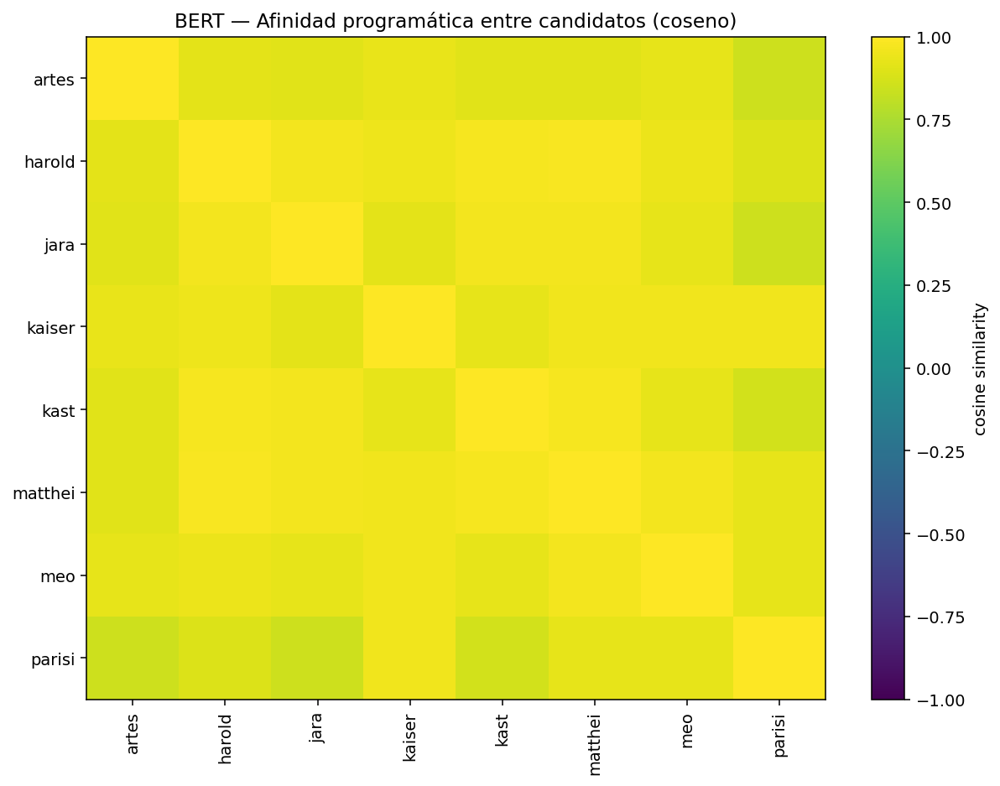

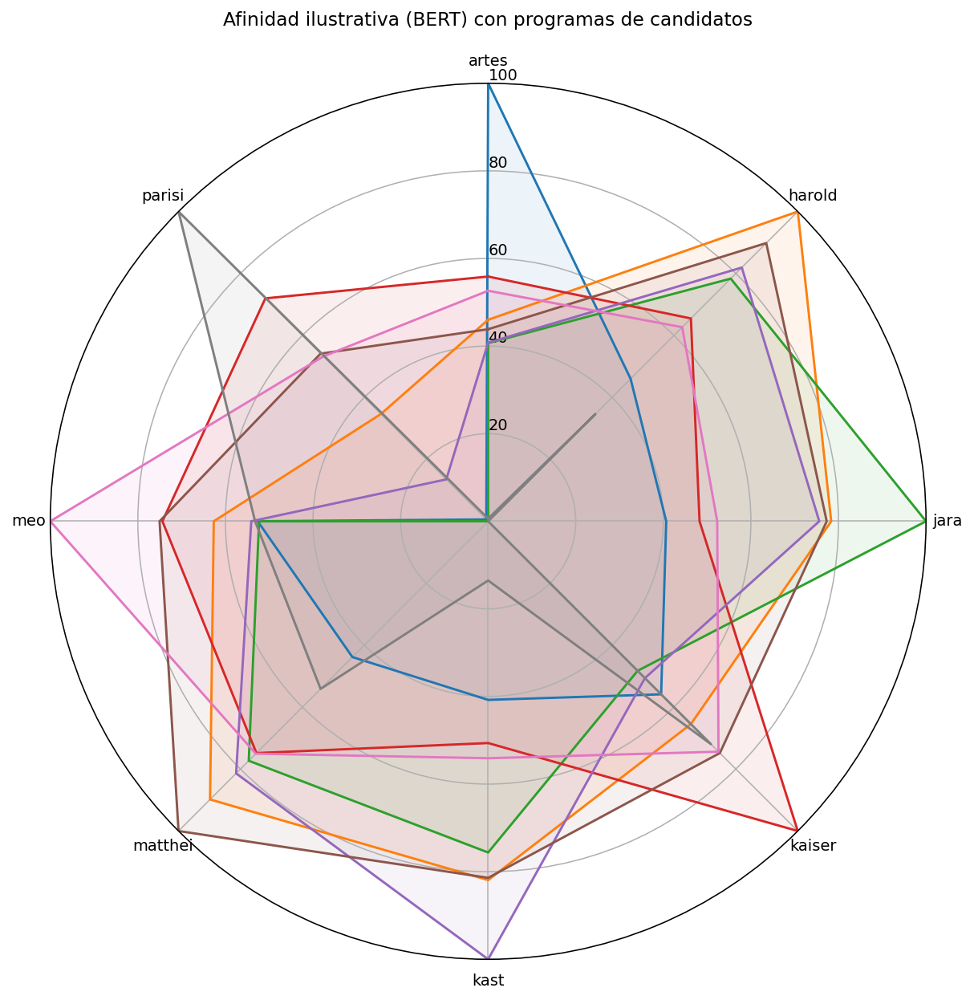

[M13] fin — heatmap y radar guardados


In [2]:
# %% MÓDULO 13 — Similitud inter-candidatos: matriz, heatmap y radar comparativo
!pip -q install scikit-learn tqdm

import numpy as np, pandas as pd
from pathlib import Path
from tqdm.auto import tqdm
import matplotlib.pyplot as plt
from sklearn.metrics.pairwise import cosine_similarity

tqdm.write("[M13] inicio")

# -------- entradas --------
EMB_CAND = Path("bert_outputs/emb_candidate_mean.parquet")
assert EMB_CAND.exists(), "Falta emb_candidate_mean.parquet (Módulo 11)."
cand_emb = pd.read_parquet(EMB_CAND)   # candidate + dim_*

# -------- matriz de similitud coseno --------
features = [c for c in cand_emb.columns if c.startswith("dim_")]
X = cand_emb[features].to_numpy()
cands = cand_emb["candidate"].tolist()
S = cosine_similarity(X, X)     # NxN

# persistencia
pd.DataFrame(S, index=cands, columns=cands).to_csv("bert_cosine_similarity_candidates.csv", encoding="utf-8-sig")

# -------- 13.1 Heatmap (matplotlib puro) --------
plt.figure(figsize=(0.6*len(cands)+4, 0.6*len(cands)+2), dpi=140)
plt.imshow(S, vmin=-1, vmax=1, aspect="auto")
plt.colorbar(label="cosine similarity")
plt.xticks(range(len(cands)), cands, rotation=90)
plt.yticks(range(len(cands)), cands)
plt.title("BERT — Afinidad programática entre candidatos (coseno)")
plt.tight_layout(); plt.savefig("bert_similarity_heatmap.png", dpi=140, bbox_inches="tight"); plt.show()

# -------- 13.2 Radar comparativo (al estilo de tu ejemplo) --------
#   - Cada serie es un "referente" (podemos graficar TOD@S) y los ejes son los candidatos.
#   - Normalizamos a [0,100] para una lectura más directa.
def radar_plot(S, labels, outfile="bert_similarity_radar.png", title="Afinidad BERT por candidato (radar)"):
    N = len(labels)
    angles = np.linspace(0, 2*np.pi, N, endpoint=False).tolist()
    angles += angles[:1]  # cerrar círculo

    # escala 0..100
    S01 = (S - S.min()) / (S.max() - S.min() + 1e-9)
    S100 = 100.0 * S01

    fig = plt.figure(figsize=(9,9), dpi=140)
    ax = plt.subplot(111, polar=True)
    ax.set_theta_offset(np.pi/2)
    ax.set_theta_direction(-1)

    # ejes
    ax.set_thetagrids(np.degrees(angles[:-1]), labels)
    ax.set_rlabel_position(0)
    ax.set_ylim(0, 100)
    ax.set_title(title, pad=18)

    # Una serie por "referente" (cada candidato)
    for i, name in enumerate(labels):
        vals = S100[i,:].tolist()
        vals += vals[:1]  # cerrar
        ax.plot(angles, vals)
        ax.fill(angles, vals, alpha=0.08)
    plt.tight_layout()
    plt.savefig(outfile, dpi=140, bbox_inches="tight")
    plt.show()

radar_plot(S, cands, outfile="bert_similarity_radar.png",
           title="Afinidad ilustrativa (BERT) con programas de candidatos")

tqdm.write("[M13] fin — heatmap y radar guardados")
